<head><p><img alt="udeA logo" height="150px" src="https://github.com/freddyduitama/images/blob/master/logo.png?raw=true" align="left" hspace="50px" vspace="0px" style="width:107px;height:152px;"></p>
<h1><font color='black'> <center>
       Bioseñales y Sistemas </center></font></h1>
<p3><center><b><font color='black' face="Lucida Calligraphy,Comic Sans MS,Lucida Console" size="5">Universidad de Antioquia</font></b> </center></p3>
</font>
<h2><font color='black'> <center>
Proyecto 4 - Machine Learning  </center></font></h2>
<h3><font color='black'> <center>
Danna Isabella Garcia Saenz - Solanlly Evenedy Montoya Rivera </center></font></h3>
<font  face="Courier New" size="3">
<p1><center> </center></p1></head>

*Teniendo en cuenta el proceso que hemos ido realizando en el curso atraves de los seguimiento, tenemos algunos parametros y metricas que ya conocemos para el manejo de estos datos, por lo tanto primero vamos a recordar las lineas de codigo que son importantes para el procesamiento de las señales.*


*Primero debemos importat las librerías necesarias para el procesamiento de datos, análisis y visualización, debemos de subir el Google Drive para acceder a los datos del proyecto, y asi mismo obtenemos la lista de directorios (sujetos) en la carpeta principal de datos y creamos una lista con las rutas completas de los directorios de cada sujeto. Despues de esto debemos recordar como se normalizan los datos en este caso los archivos de texto que comienzan con "2" (por ejemplo, "2_raw_data_12-12_25.04.16.txt") para cada sujeto. En el anterior seguimiento definimos unas funciones llamadas `plot_emg_and_tkeo_by_class` que leen los datos del archivo, normalizan los datos y calcula el TKEO (Teager-Kaiser Energy Operator) y grafica tanto la señal original como el TKEO para cada canal y cada clase, este codigo nos sirve para ir pre procesando los datos que vamos a utilizar y preparar el entorno del modelo.*

In [1]:
from scipy.io import loadmat
import scipy.io as sio
import matplotlib.pyplot as plt
import numpy as np
from csv import reader as reader_csv;
import scipy.signal as signal;
import pandas as pd
import glob
import math
import os
from scipy.stats import linregress
from scipy.signal import find_peaks
from scipy.stats import kstest
from scipy.stats import levene
from scipy.stats import mannwhitneyu
import seaborn as sns
from scipy.signal import butter, filtfilt
from tensorflow.keras import layers, Sequential, optimizers, Input, Model
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
carpeta_principal= "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master" #direccion de la ruta de la carpeta principal de datos
directorios= [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))] #obtenemos la lista de directorios en la carpeta

listas_sujetos= [] #creamos una lista con los sujetos
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto= os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

for i, lista in enumerate(listas_sujetos, 1):
    print(f"sujeto{i}: {lista}")

sujeto1: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/01
sujeto2: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/02
sujeto3: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/03
sujeto4: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/04
sujeto5: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/05
sujeto6: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/06
sujeto7: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/07
sujeto8: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/08
sujeto9: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/09
sujeto10: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/10
sujeto11: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master/11
sujeto12: /content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_

In [3]:
#para normalizar los datos de los archivos
for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt= glob.glob(os.path.join(lista, "2*.txt"))

    for archivo in archivos_txt:
        datos= []
        with open(archivo, 'r') as file:
            next(file)  #saltamos la primera fila para evitar errores por los titulos
            for linea in file:
                valores= [float(valor) for valor in linea.strip().split('\t')[1:9]]  #valores de los canales 1 a 8
                datos.append(valores)
        datos_transpuestos= np.array(list(zip(*datos)))  #transposicion de los datos

        for canal, valores_canal in enumerate(datos_transpuestos, 1):
            valores_canal= (valores_canal - np.mean(valores_canal)) / np.std(valores_canal)  #normalizacion
            offset= canal * 12  #offset

In [4]:
#funcion de TKEO que utilizamos
def plot_emg_and_tkeo_by_class(file_path, subject_num):
    data = [] #leer los datos del archivo
    with open(file_path, 'r') as file:
        next(file)  #saltar la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data) #separar los datos por clase
    class_values = data[:, -1].astype(int)
    unique_classes = np.unique(class_values)

    #graficar la señal original y el TKEO por canal
    fig, axs = plt.subplots(len(unique_classes), 1, figsize=(15, 38))
    plt.subplots_adjust(hspace=0.3)
    plt.suptitle(f'Señal de EMG y TKEO por Clase y Canal - Sujeto {subject_num}')
    for i, class_value in enumerate(sorted(unique_classes)):
        class_mask = class_values == class_value
        class_data = data[class_mask]
        offset = 0
        for channel in range(8):
            channel_data = (class_data[:, channel] - np.mean(class_data[:, channel])) / np.std(class_data[:, channel])
            tkeo_result = np.zeros_like(channel_data)
            tkeo_result[1:-1] = channel_data[1:-1] ** 2 - channel_data[:-2] * channel_data[2:]
            tkeo_result_normalized = tkeo_result / np.max(np.abs(tkeo_result))
            tkeo_result_scaled = tkeo_result_normalized
            axs[i].plot(tkeo_result_scaled + offset, label=f'Canal {channel + 1}')
            offset += 1.5
        axs[i].set_title(f'Gesto {class_value}')
        axs[i].set_xlabel('Muestras')
        axs[i].set_ylabel('Valores Normalizados')
        axs[i].set_ylim(-2, 12)
        axs[i].legend()
    plt.show()

**B. DEFINIR UNA ESTRATEGIA DE FILTRADO DE LAS SEÑALES DEL PROYECTO 1 USANDO FILTROS IIR O FIR JUSTIFICANDO LA SELECCION**
----

*Primeramente vamos a obtener las señales, a aplicarles el operador TKEO y las vamos a graficar para ver su resultado comparandolas con las señales originales.*

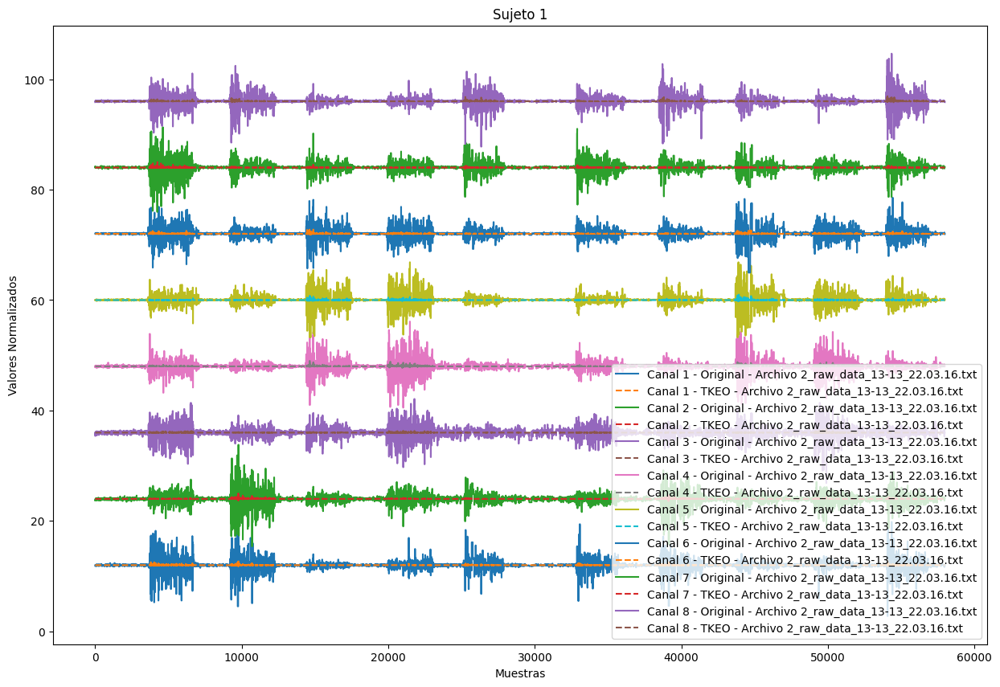

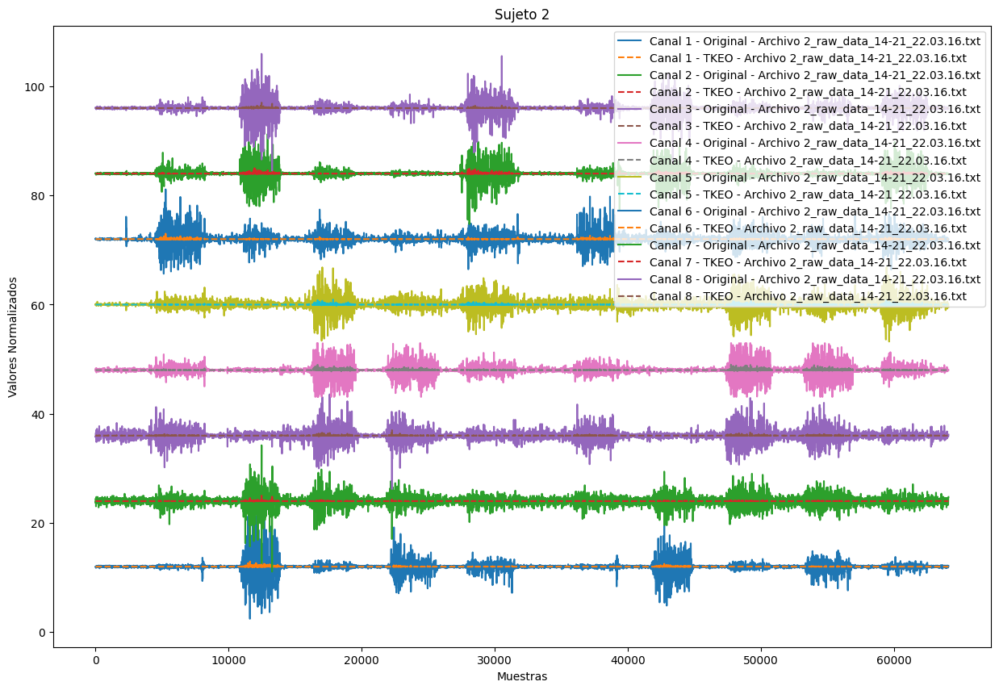

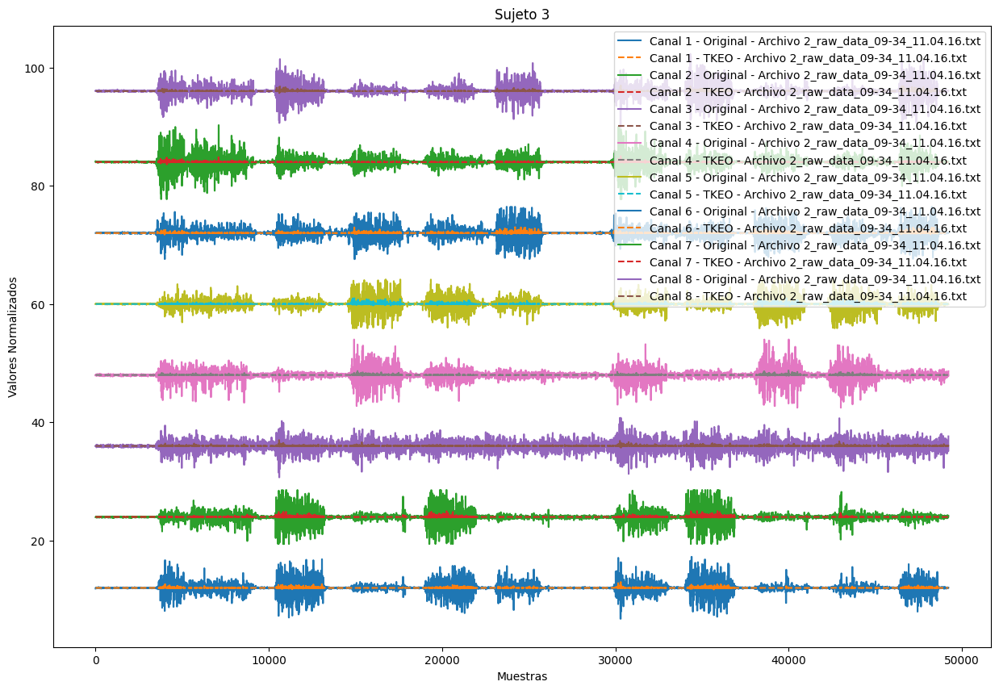

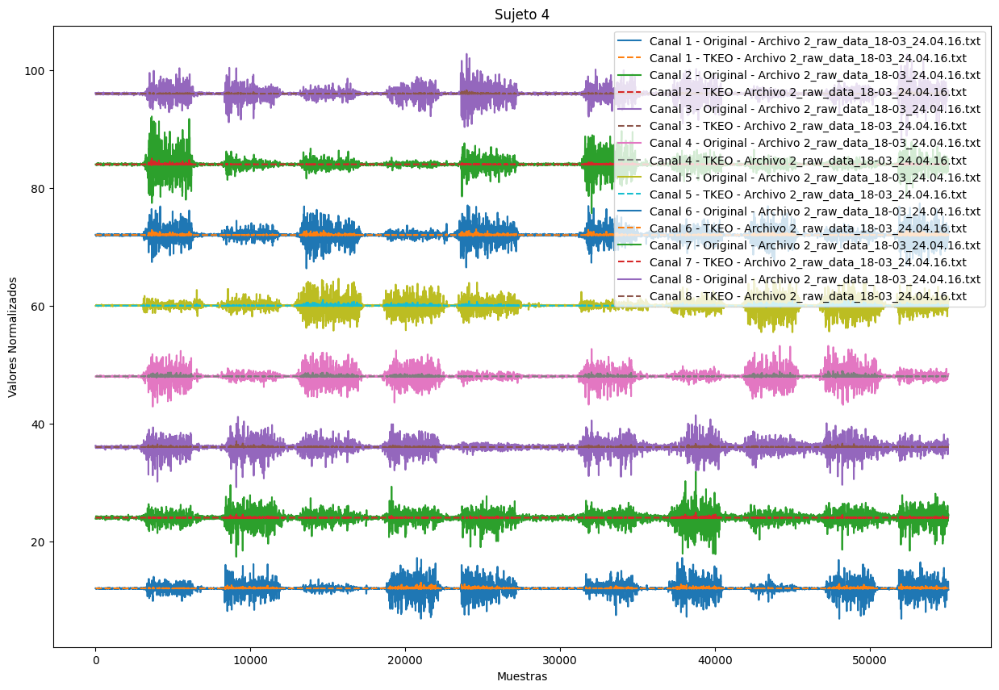

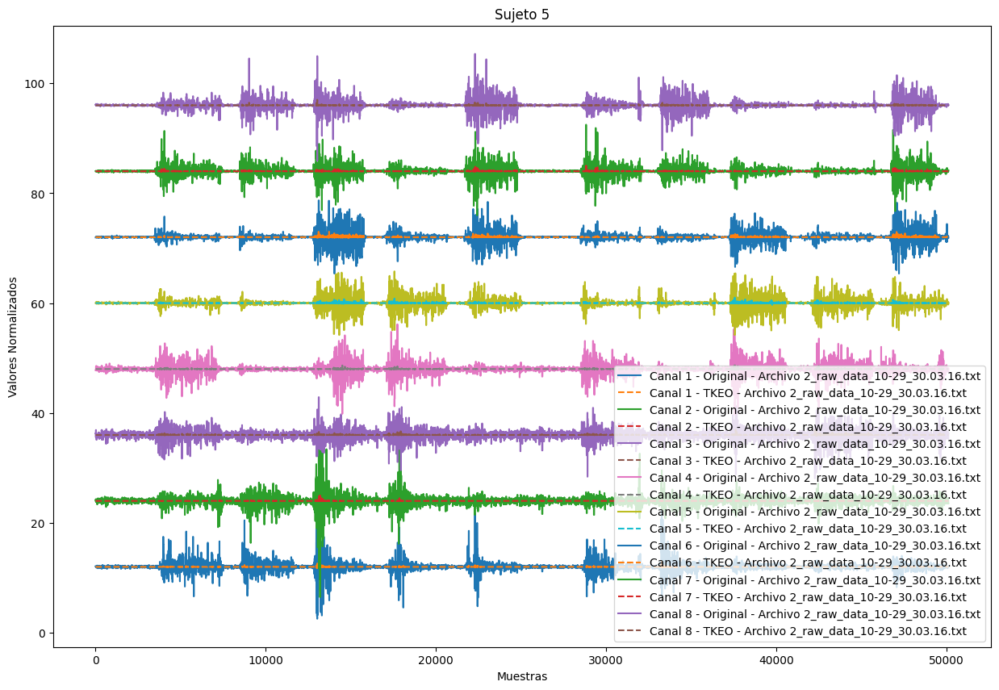

...

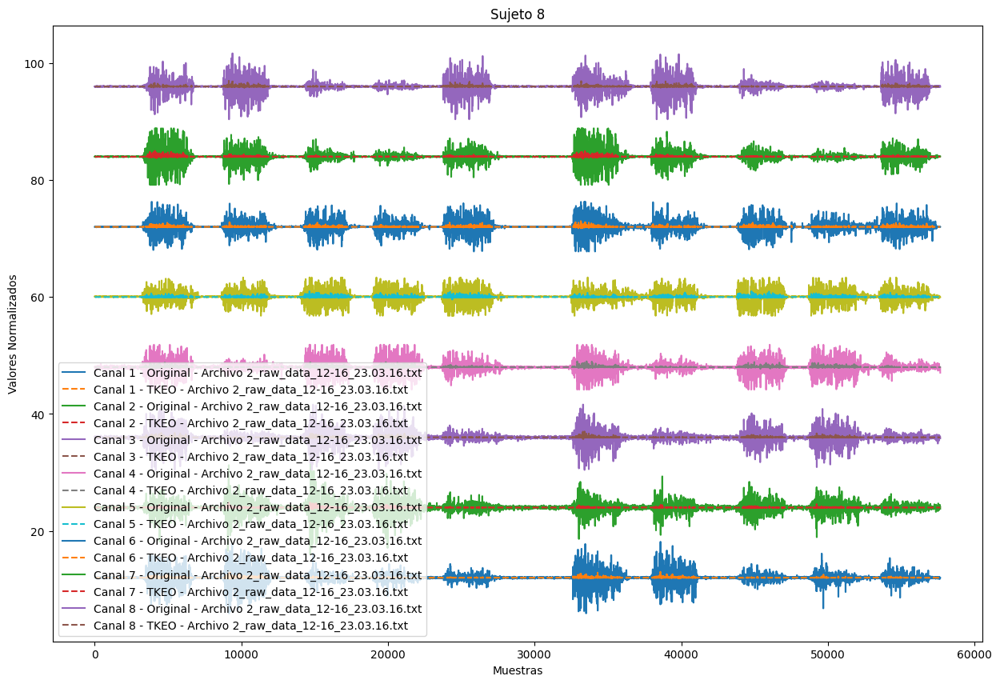

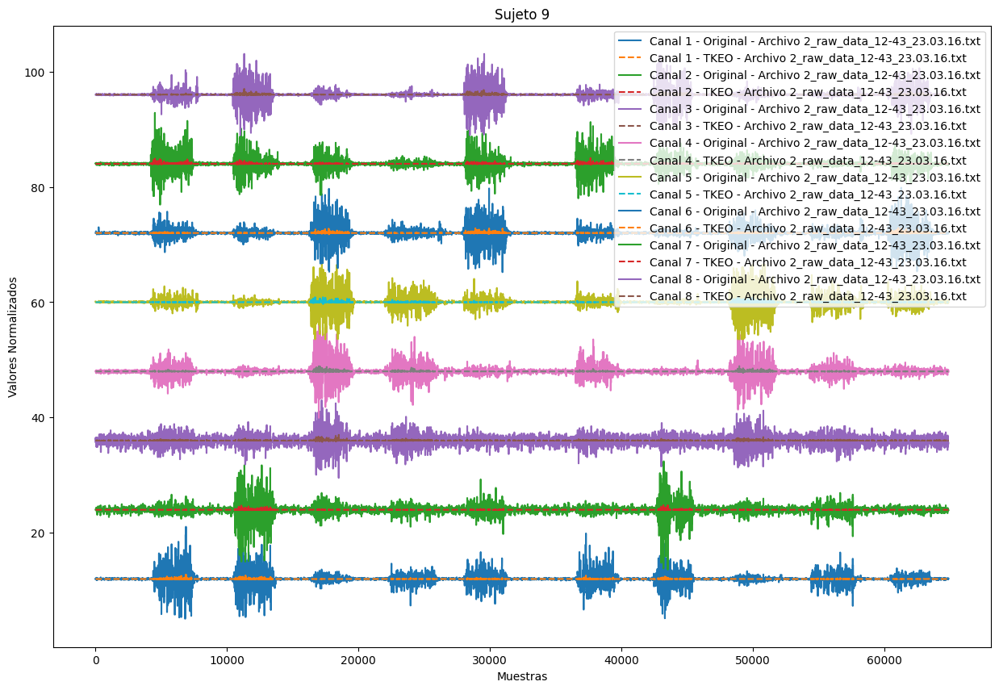

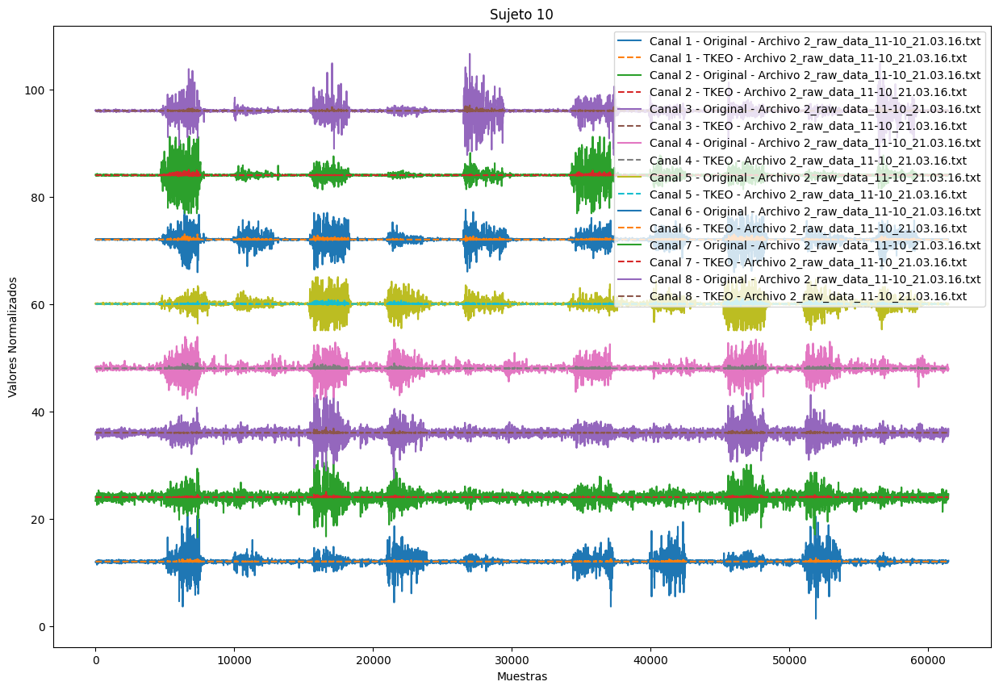

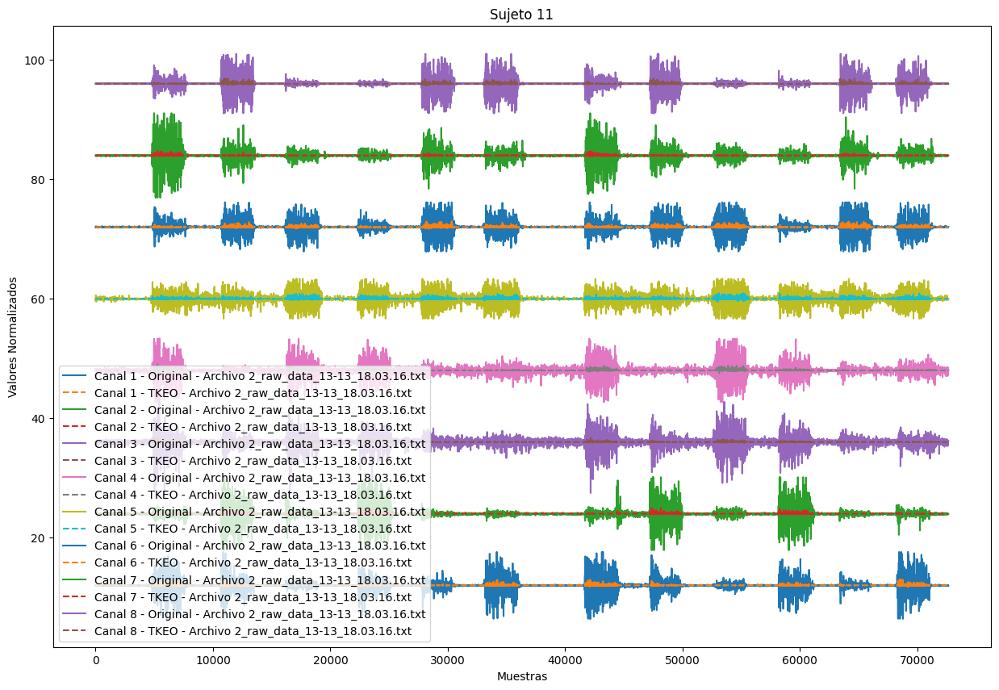

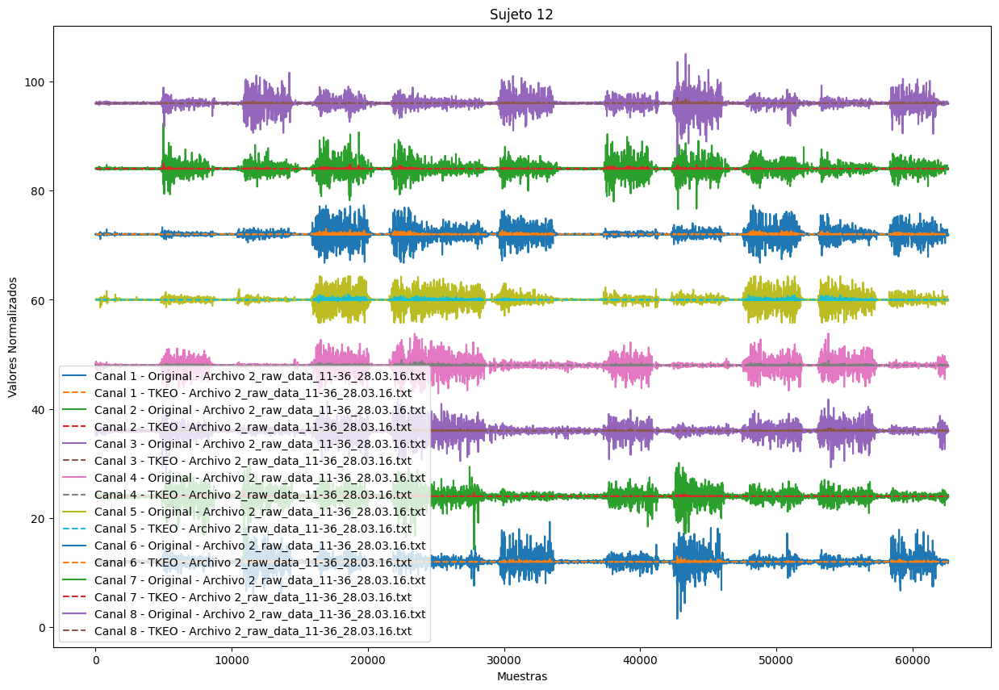

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


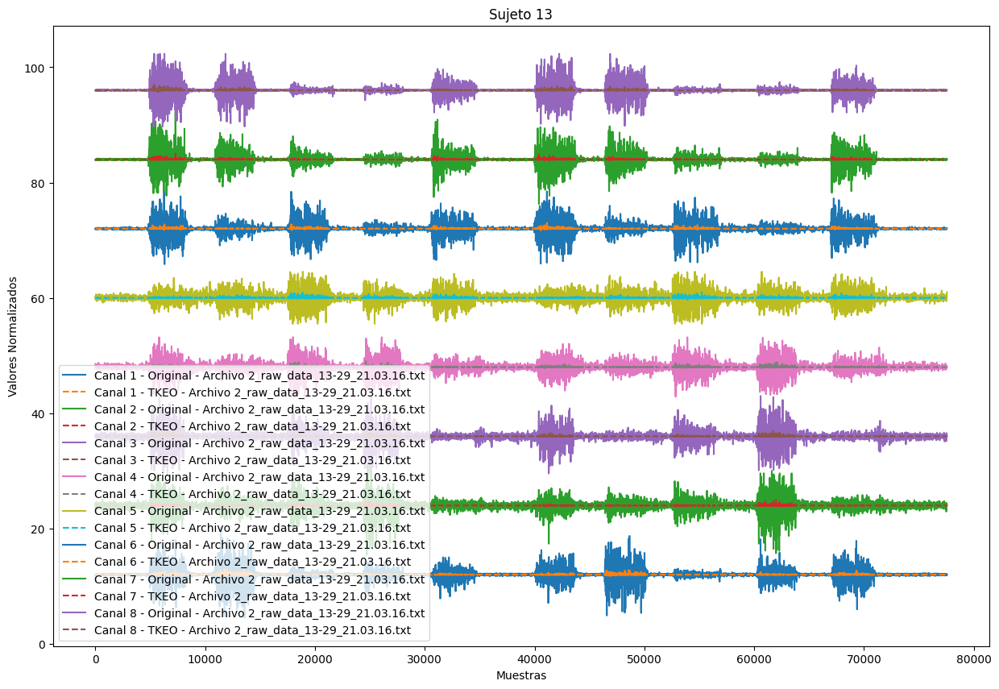

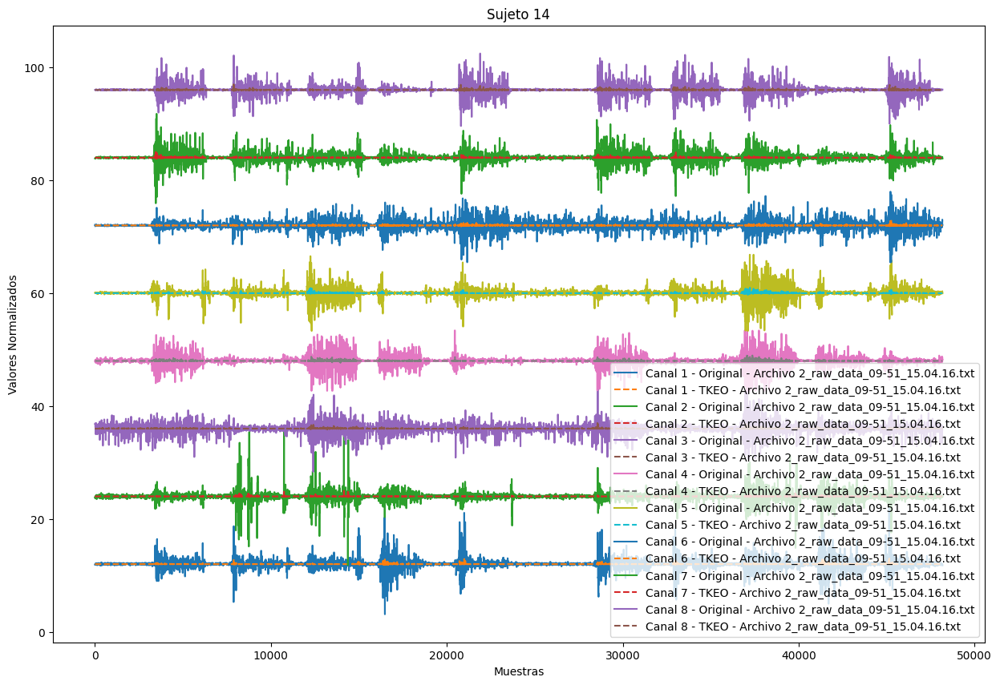

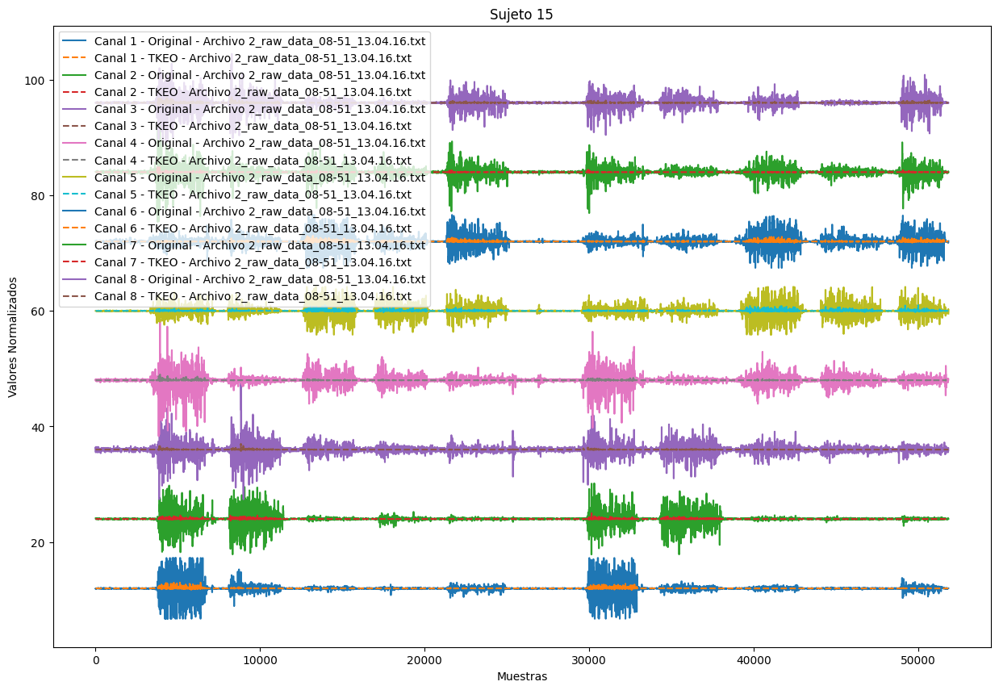

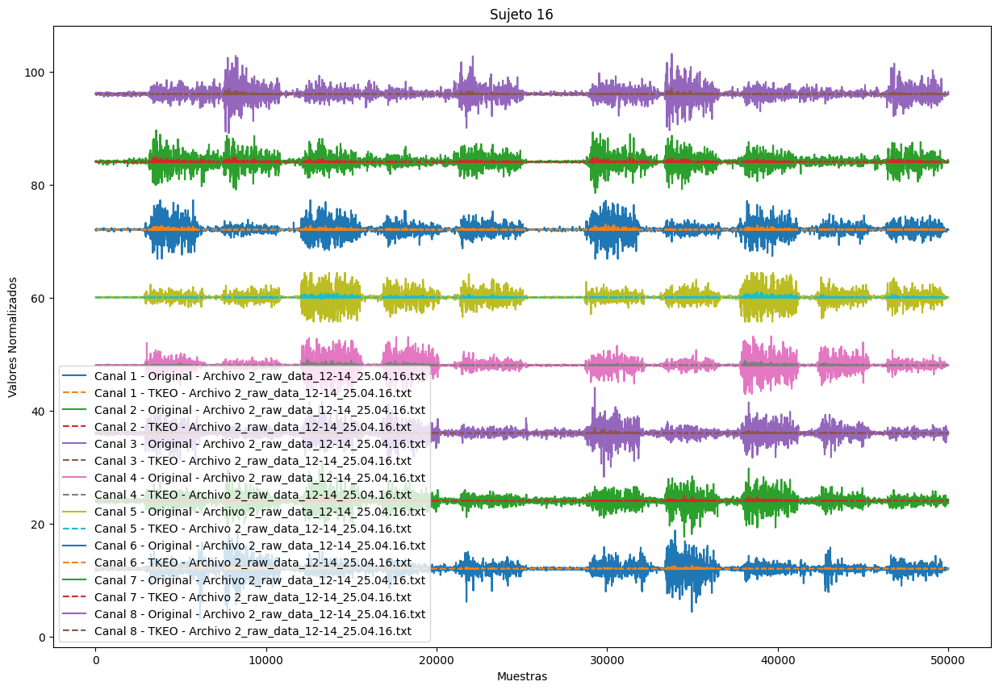

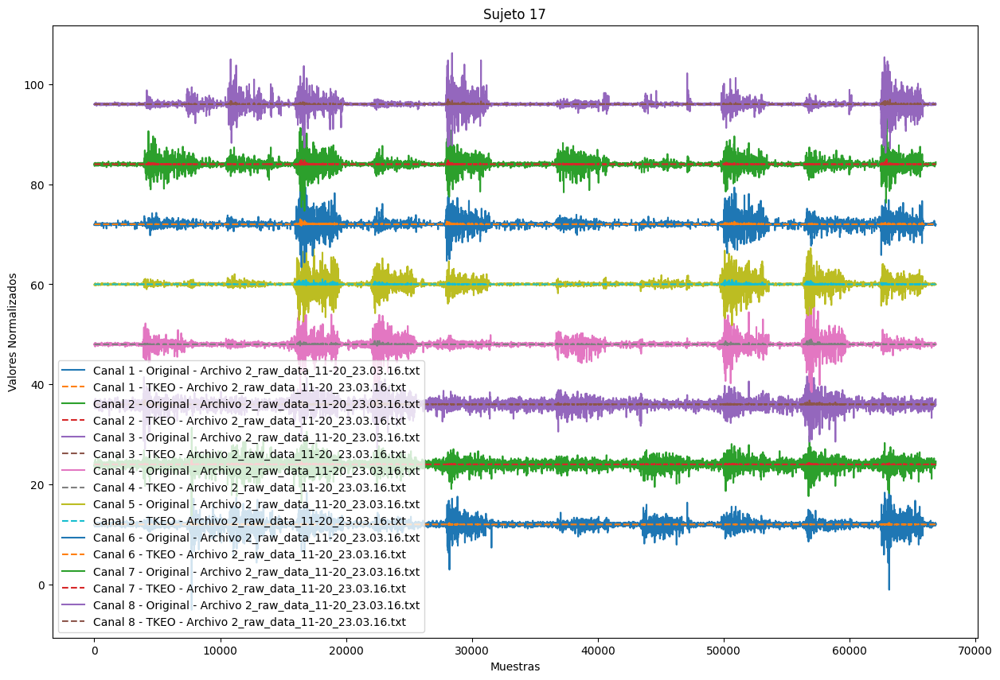

...

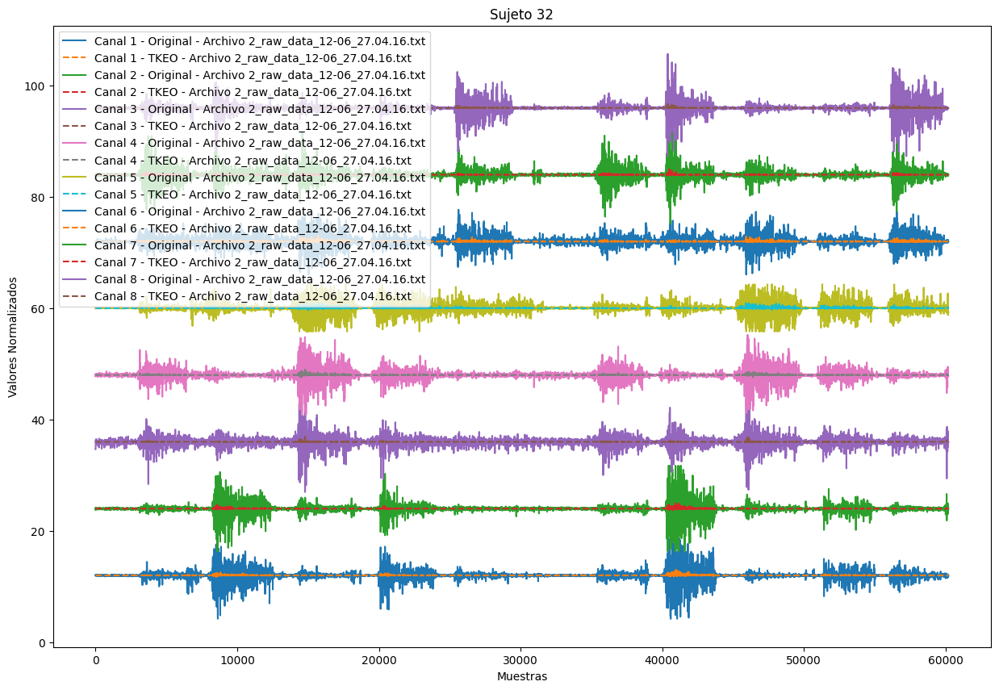

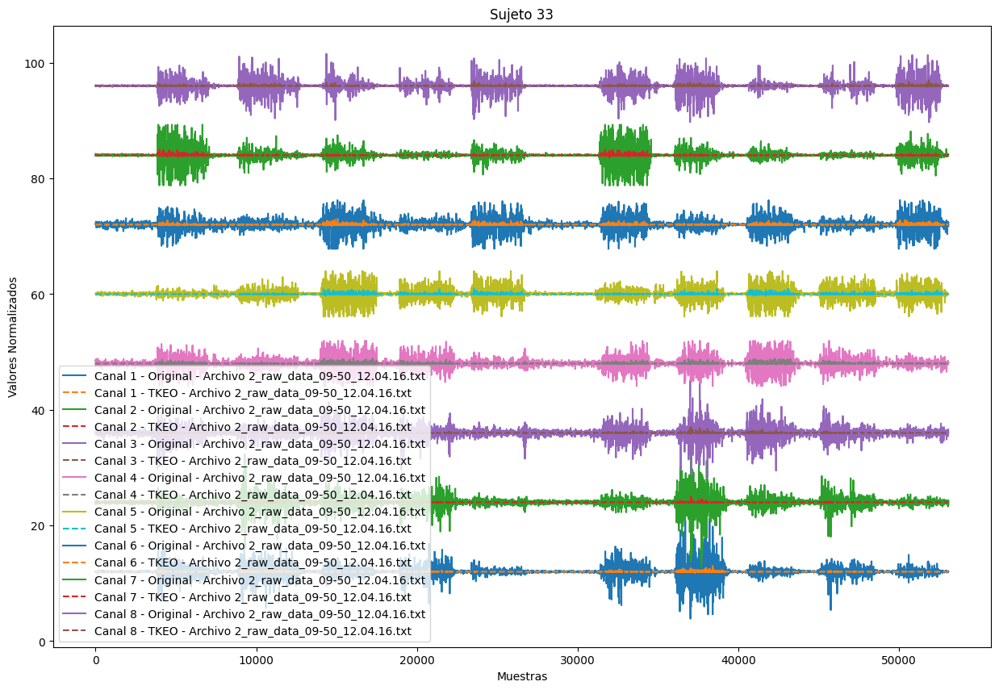

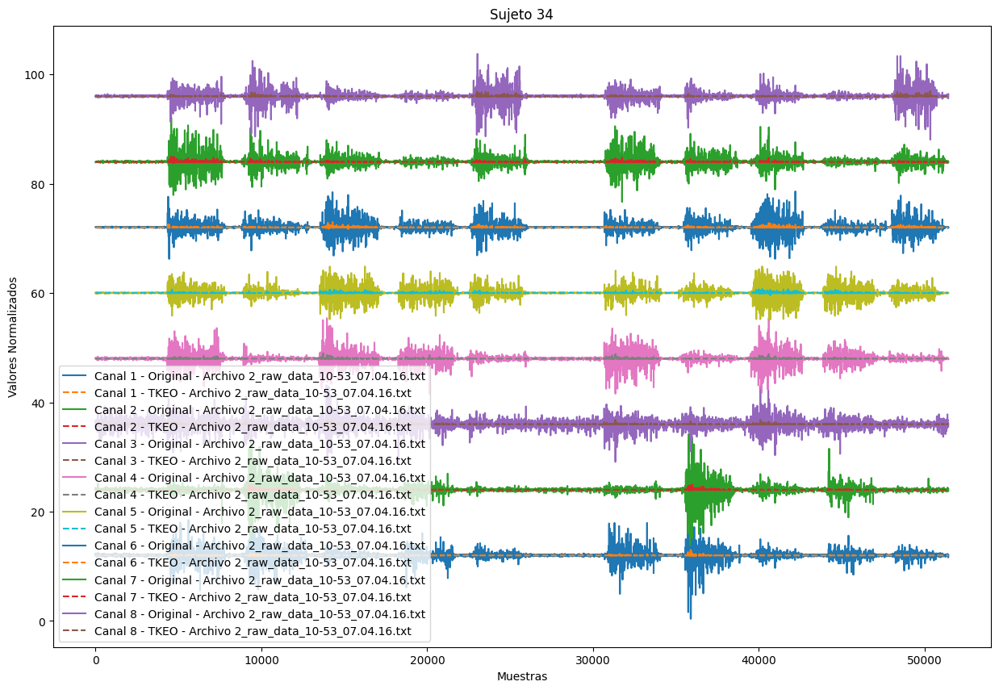

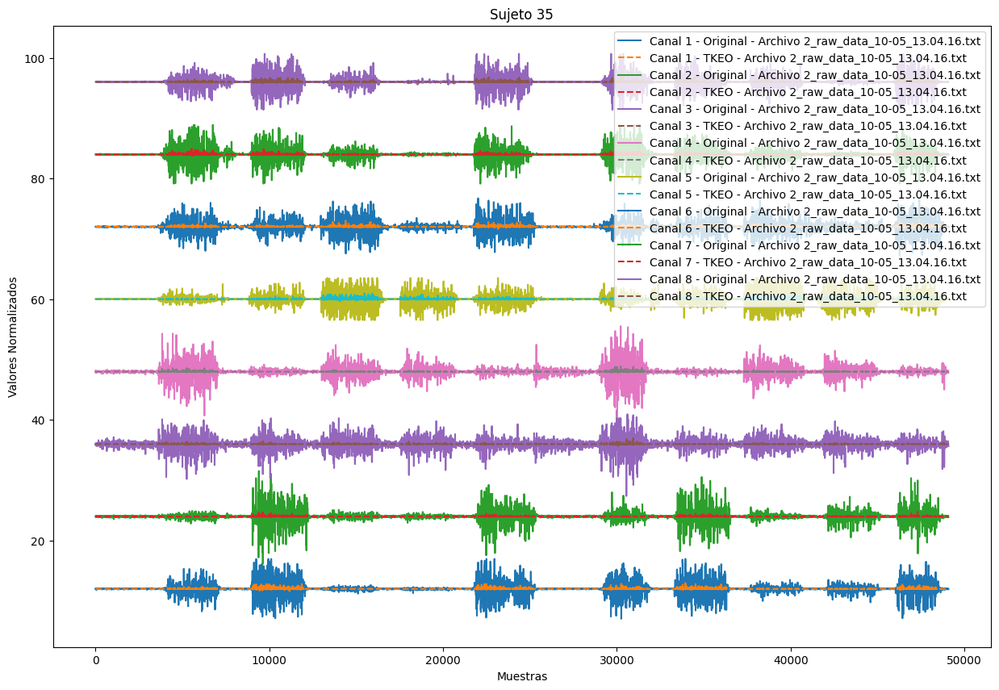

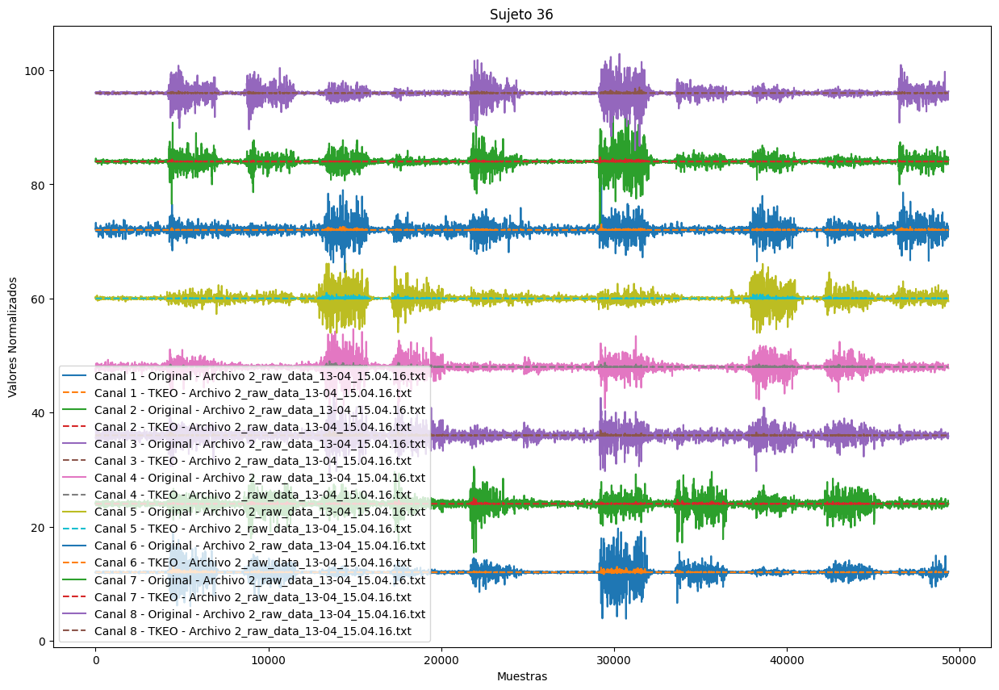

In [5]:
carpeta_principal = "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"
listas_sujetos = []
directorios = [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto = os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

#leer, procesar y graficar los datos de las señales .txt
for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt = [archivo for archivo in os.listdir(lista) if archivo.startswith("2") and archivo.endswith(".txt")]
    plt.figure(figsize=(15, 10))
    for archivo in archivos_txt:
        archivo_path = os.path.join(lista, archivo)
        datos = []
        with open(archivo_path, 'r') as file:
            next(file)  # Saltar la primera línea porque aquí hay títulos
            for linea in file:
                valores = [float(valor) for valor in linea.strip().split('\t')[1:9]]  # Obtener los valores de canales 1 a 8
                datos.append(valores)
        datos_transpuestos = np.array(list(zip(*datos)))  # Transponer datos para facilitar la graficación
        for canal, valores_canal in enumerate(datos_transpuestos, 1):
            valores_normalizados = (valores_canal - np.mean(valores_canal)) / np.std(valores_canal)  #normalización de la señal original

            tkeo_result = np.zeros_like(valores_normalizados) #operador TKEO
            tkeo_result[1:-1] = valores_normalizados[1:-1] ** 2 - valores_normalizados[:-2] * valores_normalizados[2:]
            tkeo_result_normalized = tkeo_result / np.max(np.abs(tkeo_result))  # Normalización del TKEO

            offset = canal * 12  # Offset
            plt.plot(valores_normalizados + offset, label=f"Canal {canal} - Original - Archivo {os.path.basename(archivo_path)}")
            plt.plot(tkeo_result_normalized + offset, label=f"Canal {canal} - TKEO - Archivo {os.path.basename(archivo_path)}", linestyle='--')
        plt.title(f"Sujeto {i}")
        plt.ylabel("Valores Normalizados")
        plt.xlabel("Muestras")
        plt.legend()
    plt.show()

*A continuacion el codigo que pretente leer los datos de los señales, aplicarles el filtro  Butterworth pasa-bajos a cada canal y grafica tanto las señales originales como las señales filtradas con TKEO para cada canal.*


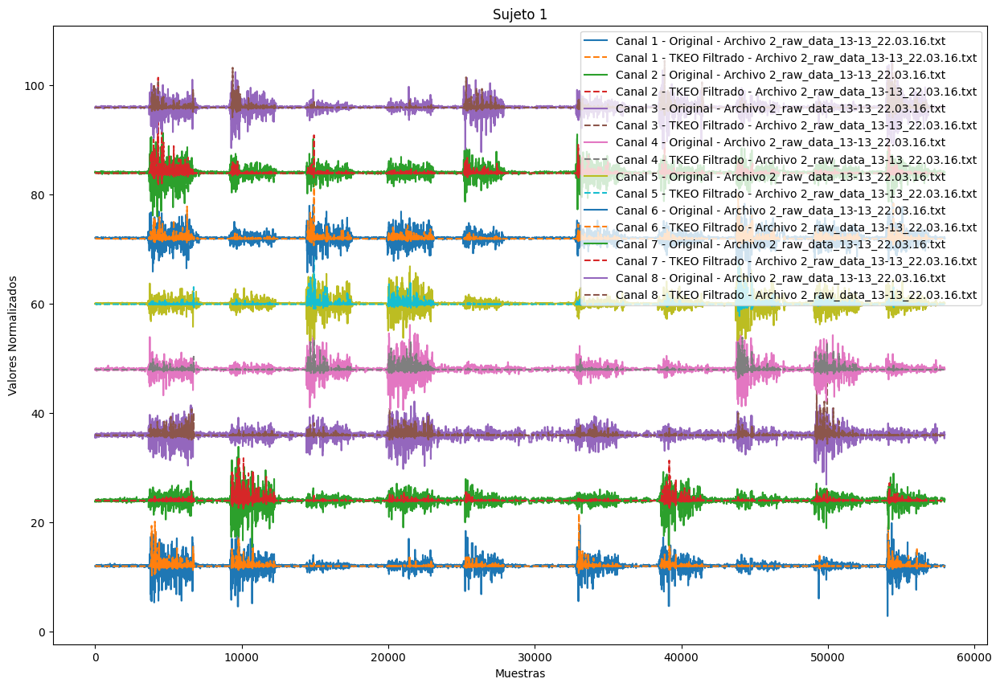

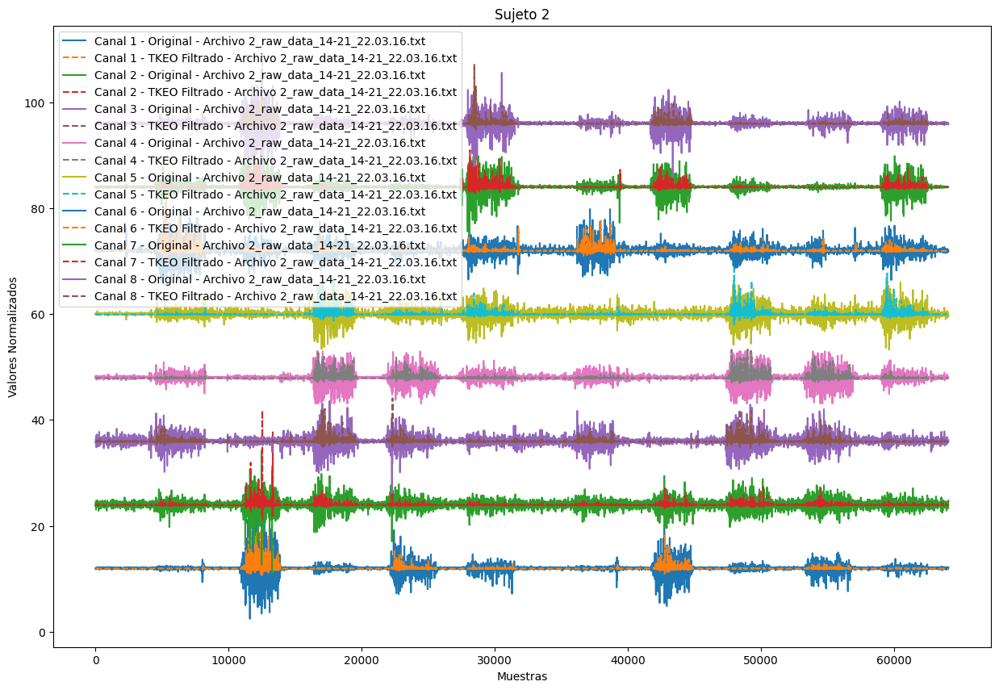

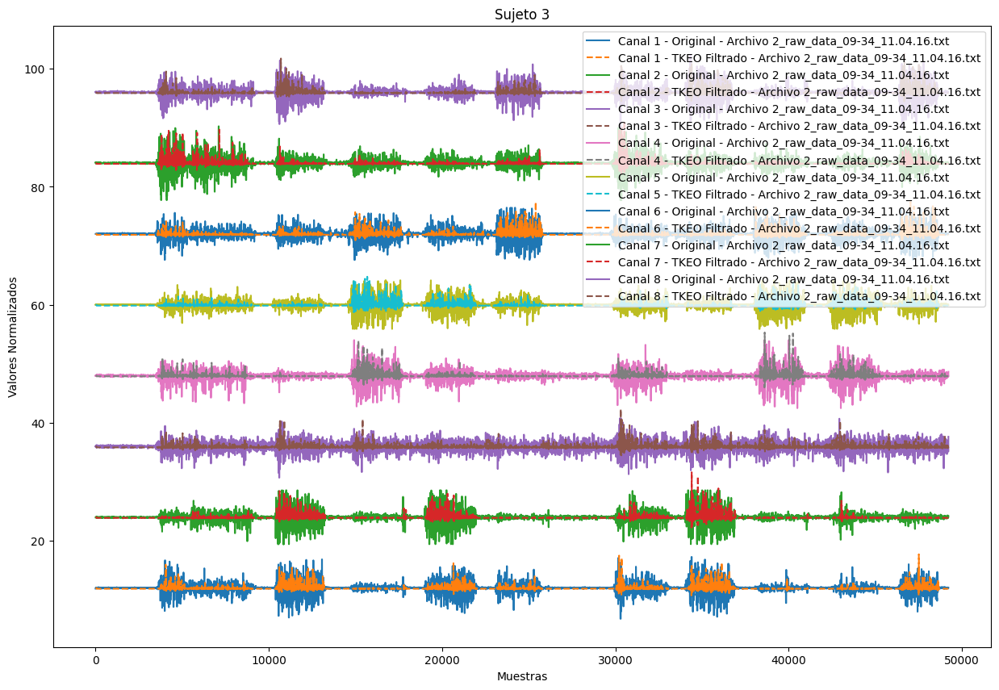

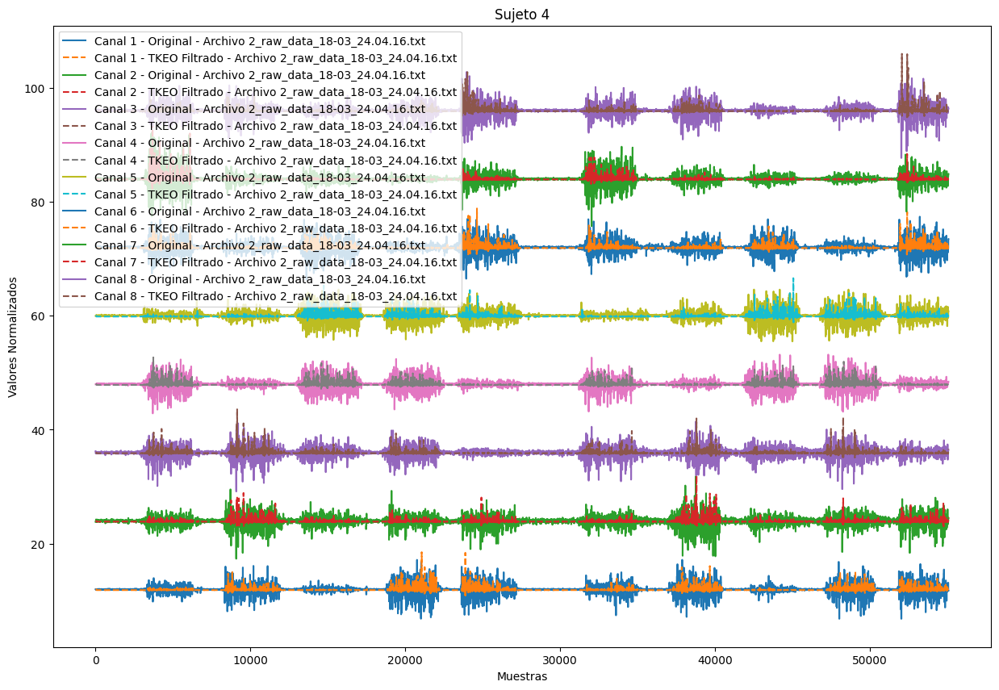

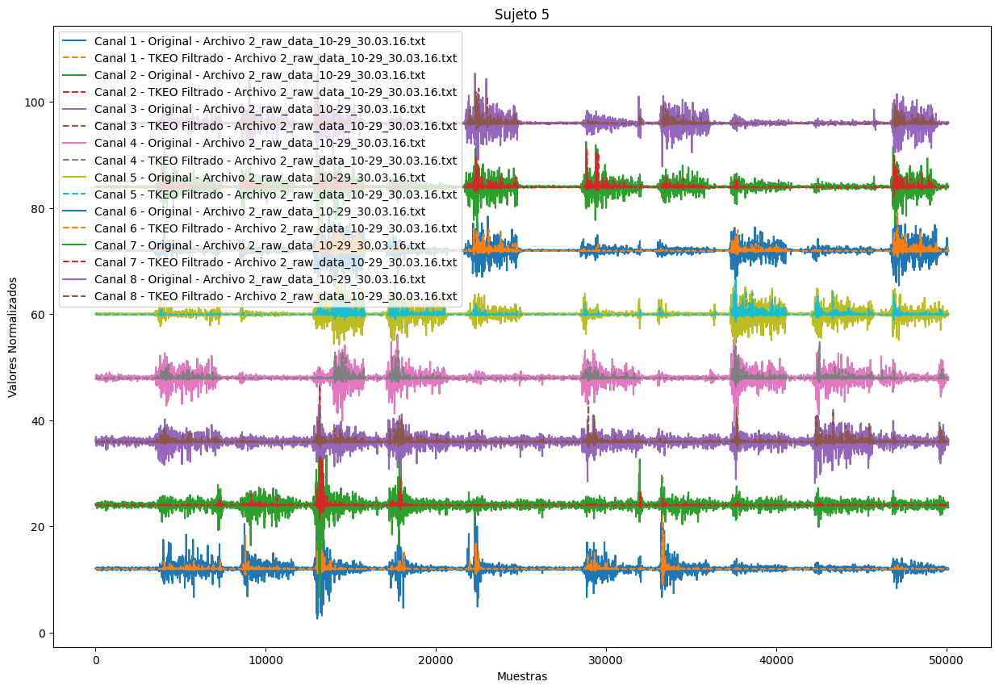

...

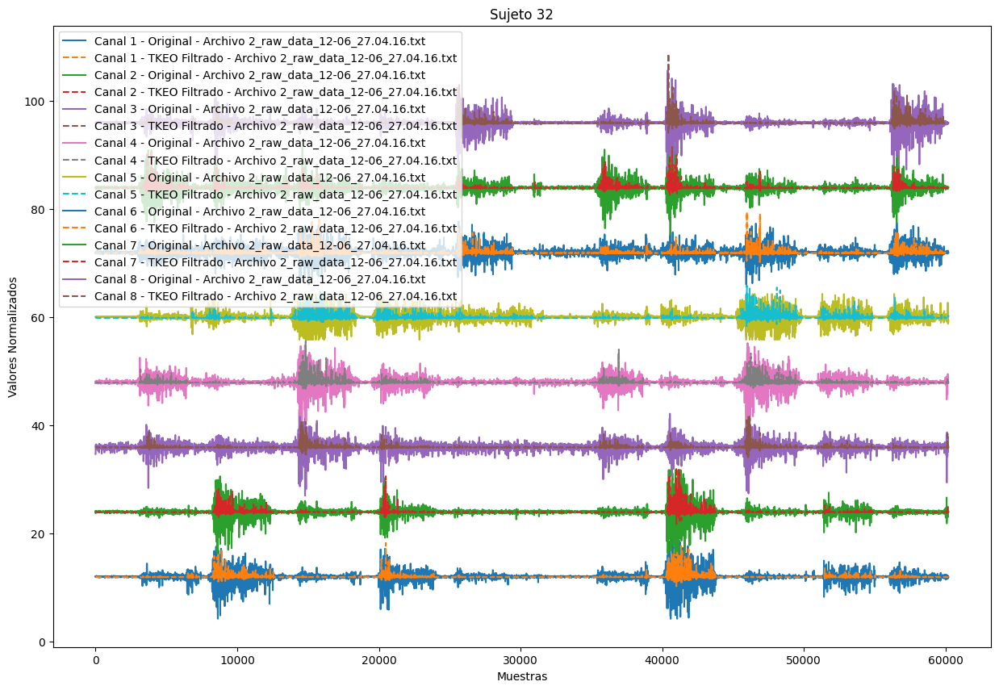

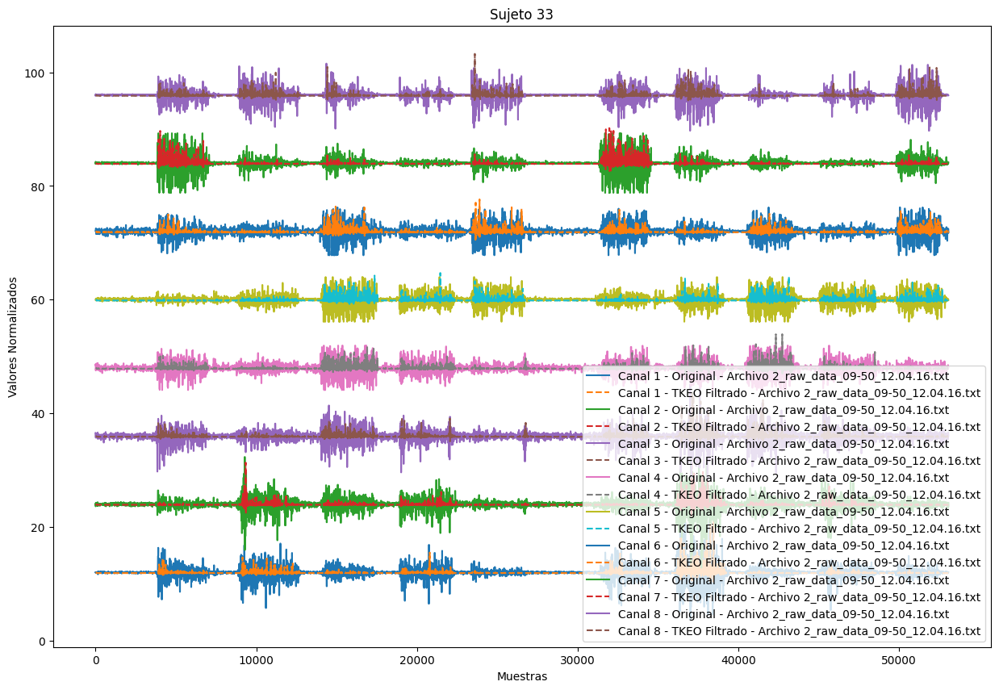

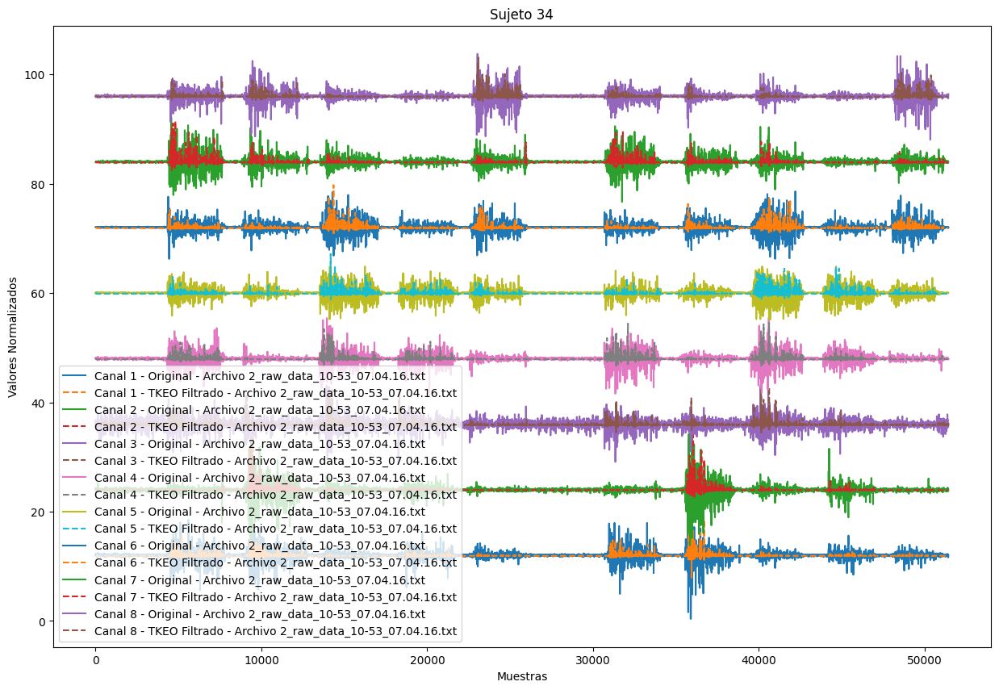

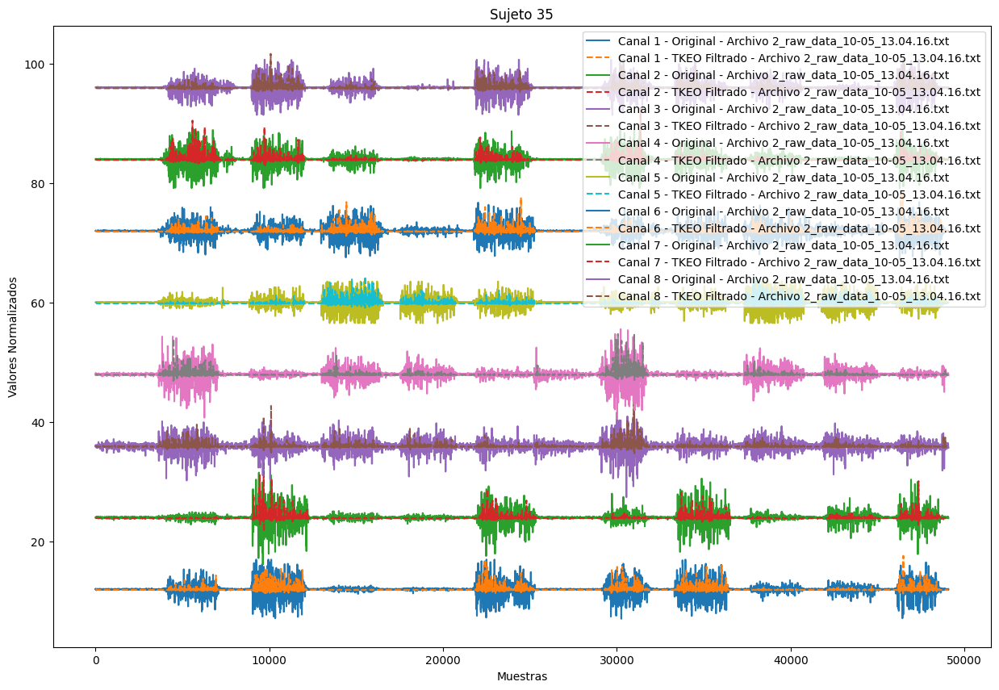

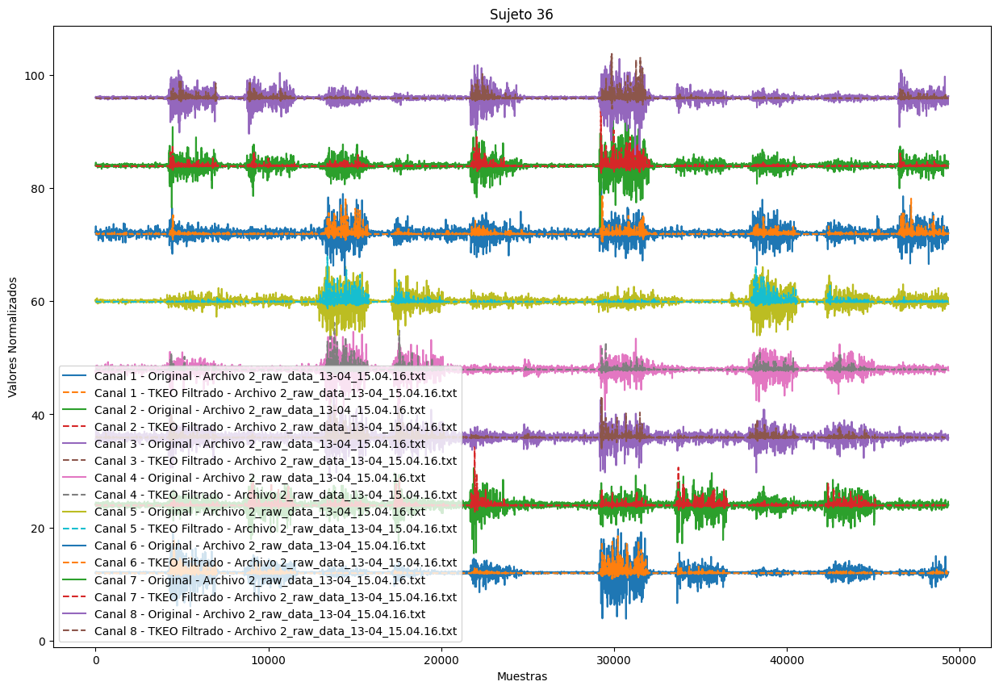

In [6]:
from scipy.signal import firwin, lfilter
carpeta_principal = "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"
listas_sujetos = []
directorios = [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto = os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

#diseñp filtro
def fir_lowpass(cutoff, fs, numtaps):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    taps = firwin(numtaps, normal_cutoff, window='hamming')
    return taps
#diseño filtro
def filtra_datos_fir(data, cutoff, fs, numtaps):
    taps = fir_lowpass(cutoff, fs, numtaps)
    y = lfilter(taps, 1.0, data)
    return y

#parametros
fs = 1000  # Frecuencia de muestreo
cutoff = 50  # Frecuencia de corte del filtro
numtaps = 101  # Número de coeficientes del filtro

#usamos el mismo bloque de procesamiento de archivos que antes, reemplazando la llamada al filtro
for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt = [archivo for archivo in os.listdir(lista) if archivo.startswith("2") and archivo.endswith(".txt")]
    plt.figure(figsize=(15, 10))
    for archivo in archivos_txt:
        archivo_path = os.path.join(lista, archivo)
        datos = []
        with open(archivo_path, 'r') as file:
            next(file)  #salta la primera línea porque aquí hay títulos
            for linea in file:
                valores = [float(valor) for valor in linea.strip().split('\t')[1:9]]  # Obtener los valores de canales 1 a 8
                datos.append(valores)
        datos_transpuestos = np.array(list(zip(*datos)))  # Transponer datos para facilitar la graficación
        for canal, valores_canal in enumerate(datos_transpuestos, 1):

            valores_normalizados = (valores_canal - np.mean(valores_canal)) / np.std(valores_canal) #normalización de la señal
            tkeo_result = np.zeros_like(valores_canal) #aplicar operador TKEO
            tkeo_result[1:-1] = valores_canal[1:-1] ** 2 - valores_canal[:-2] * valores_canal[2:]
            tkeo_result_normalized = (tkeo_result - np.mean(tkeo_result)) / np.std(tkeo_result)  # Normalización del TKEO

            #aplica el filtro FIR a la señal TKEO normalizada
            tkeo_filtrado = filtra_datos_fir(tkeo_result_normalized, cutoff, fs, numtaps)

            offset = canal * 12  # Offset
            plt.plot(valores_normalizados + offset, label=f"Canal {canal} - Original - Archivo {os.path.basename(archivo_path)}")
            plt.plot(tkeo_filtrado + offset, label=f"Canal {canal} - TKEO Filtrado - Archivo {os.path.basename(archivo_path)}", linestyle='--')
        plt.title(f"Sujeto {i}")
        plt.ylabel("Valores Normalizados")
        plt.xlabel("Muestras")
        plt.legend()
    plt.show()

*A continuacion vamos a sacar las metricas que ya habiamos utilizado en los seguimientos pasados, para evaluar el comportamiento de la señal, se extraen los parametros de RMS, Varianza, MAV, SSC, WL, ZC para cada uno de los gestos que tengan TKEO pero sin filtro .*

In [7]:
import glob as glob

carpeta_principal = "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"
listas_sujetos = []
directorios = [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto = os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

def extract_emg_features(data, labels):
    unique_gestures = np.unique(labels)
    num_channels = data.shape[1]
    emg_features_by_gesture = {}
    for gesture in unique_gestures:
        gesture_data = data[labels == gesture, :]
        rms = np.sqrt(np.mean(gesture_data ** 2, axis=0))
        var = np.var(gesture_data, axis=0)
        mav = np.mean(np.abs(gesture_data), axis=0)
        mavs = np.mean(np.abs(np.diff(gesture_data, axis=0)), axis=0)
        ssc = np.sum(np.abs(np.diff(np.sign(np.diff(gesture_data, axis=0)), axis=0)), axis=0)
        wl = np.sum(np.abs(np.diff(gesture_data, axis=0)), axis=0)
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=0)), axis=0)
        emg_features_by_gesture[gesture] = np.vstack((rms, var, mav, mavs, ssc, wl, zc)).T
    return emg_features_by_gesture

def get_emg_features_tkeo_unfiltered(archivo, subject_num):
    data = []
    with open(archivo, 'r') as file:
        next(file)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data)
    class_values = data[:, -1].astype(int)
    emg_data = data[:, :-1]

    emg_data_norm = (emg_data - np.mean(emg_data, axis=0)) / np.std(emg_data, axis=0) #normalizar la señal
    tkeo_result = np.zeros_like(emg_data_norm) #aplicar operador TKEO
    tkeo_result[:, 1:-1] = emg_data_norm[:, 1:-1] ** 2 - emg_data_norm[:, :-2] * emg_data_norm[:, 2:]
    emg_features_by_gesture = extract_emg_features(tkeo_result, class_values) #características de la señal TKEO sin filtrar

    print(f"Sujeto {subject_num} - Archivo {os.path.basename(archivo)} - Gesto con TKEO sin filtrar:")
    for gesture, features in emg_features_by_gesture.items():
        print(f"RMS para gesto {gesture}: {features[:, 0]}")
        print(f"Varianza para gesto {gesture}: {features[:, 1]}")
        print(f"MAV para gesto {gesture}: {features[:, 2]}")
        print(f"MAVS para gesto {gesture}: {features[:, 3]}")
        print(f"SSC para gesto {gesture}: {features[:, 4]}")
        print(f"WL para gesto {gesture}: {features[:, 5]}")
        print(f"ZC para gesto {gesture}: {features[:, 6]}")
        print()

#función para cada sujeto y archivo
for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt = glob.glob(os.path.join(lista, "2*.txt"))
    for archivo in archivos_txt:
        get_emg_features_tkeo_unfiltered(archivo, i)

Sujeto 1 - Archivo 2_raw_data_13-13_22.03.16.txt - Gesto con TKEO sin filtrar:
RMS para gesto 0: [0.         5.03922595 3.73851033 2.73500771 2.70663573 2.22513203
 2.04465308 3.21605473 0.        ]
Varianza para gesto 0: [ 0.         24.53391949 13.57438965  7.07471845  6.98304893  4.75576758
  3.91045904  9.85982022  0.        ]
MAV para gesto 0: [0.         1.1269275  0.81888612 0.73827609 0.68758975 0.66075006
 0.63400515 0.82521608 0.        ]
MAVS para gesto 0: [0.         0.14896037 0.11010718 0.09537043 0.09587706 0.09709126
 0.08650286 0.10299892 0.        ]
SSC para gesto 0: [   0. 6434. 6492. 6500. 6464. 6476. 6442. 6468.    0.]
WL para gesto 0: [   0.         5572.4584942  4118.99950269 3567.71241034 3586.66482915
 3632.08681644 3235.98532061 3853.08663729    0.        ]
ZC para gesto 0: [   0. 3532. 2808. 2084. 2882. 3148. 2648. 2480.    0.]

RMS para gesto 1: [0.         0.18761312 0.06147745 0.19468696 0.03579803 0.01789181
 0.01391092 0.01585713 0.        ]
Varianza par

*Ahora las metricas para la señales a las que les aplicamos el TKEO y el filtro*

In [8]:
from glob import glob
import numpy as np
from scipy.signal import firwin, lfilter
carpeta_principal = "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"
listas_sujetos = []
directorios = [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]
for directorio in sorted(directorios, key=lambda x: int(x)):
    lista_sujeto = os.path.join(carpeta_principal, directorio)
    listas_sujetos.append(lista_sujeto)

def fir_lowpass(cutoff, fs, numtaps):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    taps = firwin(numtaps, normal_cutoff, window='hamming')
    return taps
def filtra_datos_fir(data, cutoff, fs, numtaps):
    taps = fir_lowpass(cutoff, fs, numtaps)
    y = lfilter(taps, 1.0, data)
    return y

def extract_emg_features_by_gesture_filtered(data, labels):
    unique_gestures = np.unique(labels)
    num_channels = data.shape[1]
    emg_features_by_gesture = {}
    for gesture in unique_gestures:
        gesture_data = data[labels == gesture, :]
        rms = np.sqrt(np.mean(gesture_data ** 2, axis=0))
        var = np.var(gesture_data, axis=0)
        mav = np.mean(np.abs(gesture_data), axis=0)
        mavs = np.mean(np.abs(np.diff(gesture_data, axis=0)), axis=0)
        ssc = np.sum(np.abs(np.diff(np.sign(np.diff(gesture_data, axis=0)), axis=0)), axis=0)
        wl = np.sum(np.abs(np.diff(gesture_data, axis=0)), axis=0)
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data), axis=0)), axis=0)
        emg_features_by_gesture[gesture] = np.vstack((rms, var, mav, mavs, ssc, wl, zc)).T
    return emg_features_by_gesture

def get_emg_features_tkeo_filtered(archivo, subject_num):
    data = []
    with open(archivo, 'r') as file:
        next(file)  # Saltar la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data)
    class_values = data[:, -1].astype(int)
    emg_data = data[:, :-1]

    emg_data_normalized = (emg_data - np.mean(emg_data, axis=0)) / np.std(emg_data, axis=0)  #normalización de la señal
    tkeo_result = np.zeros_like(emg_data_normalized)  #aplica el operador TKEO
    tkeo_result[:, 1:-1] = emg_data_normalized[:, 1:-1] ** 2 - emg_data_normalized[:, :-2] * emg_data_normalized[:, 2:]

    #aplica filtro FIR
    tkeo_filtered = np.zeros_like(tkeo_result)
    for channel in range(tkeo_result.shape[1]):
        tkeo_filtered[:, channel] = filtra_datos_fir(tkeo_result[:, channel], cutoff=200, fs=1000, numtaps=101)

    emg_features_by_gesture_filtrada = extract_emg_features_by_gesture_filtered(tkeo_filtered, class_values)

    print(f"Sujeto {subject_num} - Archivo {os.path.basename(archivo)} - Gesto con TKEO Filtrado:")
    for gesture, features in emg_features_by_gesture_filtrada.items():
        print(f"RMS para gesto {gesture}: {features[:, 0]}")
        print(f"Varianza para gesto {gesture}: {features[:, 1]}")
        print(f"MAV para gesto {gesture}: {features[:, 2]}")
        print(f"MAVS para gesto {gesture}: {features[:, 3]}")
        print(f"SSC para gesto {gesture}: {features[:, 4]}")
        print(f"WL para gesto {gesture}: {features[:, 5]}")
        print(f"ZC para gesto {gesture}: {features[:, 6]}")
        print()

#función para cada sujeto y archivo
for i, lista in enumerate(listas_sujetos, 1):
    archivos_txt = glob(os.path.join(lista, "2*.txt"))
    for archivo in archivos_txt:
        get_emg_features_tkeo_filtered(archivo, i)

Sujeto 1 - Archivo 2_raw_data_13-13_22.03.16.txt - Gesto con TKEO Filtrado:
RMS para gesto 0: [0.         4.494393   3.38983926 2.47707653 2.6459135  2.16204481
 1.97560881 3.12521116 0.        ]
Varianza para gesto 0: [ 0.         19.51041499 11.14156099  5.76509429  6.66153932  4.4762376
  3.64251771  9.3265296   0.        ]
MAV para gesto 0: [0.         1.02901291 0.77552938 0.7104035  0.68299861 0.64985677
 0.62023864 0.79221572 0.        ]
MAVS para gesto 0: [0.         0.17694388 0.12811378 0.11577152 0.11720554 0.11550743
 0.10517383 0.1328051  0.        ]
SSC para gesto 0: [    0. 25756. 25850. 25814. 25824. 25744. 25874. 25814.     0.]
WL para gesto 0: [   0.         6619.29367437 4792.60839852 4330.89697496 4384.54218311
 4321.01729772 3934.44777742 4968.10614318    0.        ]
ZC para gesto 0: [   0. 5262. 5338. 5412. 5174. 4874. 4962. 5344.    0.]

RMS para gesto 1: [0.         0.17809859 0.05993326 0.18676792 0.03542305 0.01760775
 0.01370047 0.01551864 0.        ]
Varianz

*Ahora debemos de crear un dataset donde vamos a guardar las todas las metricas de las señales tanto con TKEO y con TKEO filtrado, las columnas seran los parametros y las filas los sujetos*

In [9]:
from scipy.signal import firwin, lfilter
from glob import glob
import os

def fir_lowpass(cutoff, fs, numtaps): #funciones de procesamiento de señales y extracción de características
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    taps = firwin(numtaps, normal_cutoff, window='hamming')
    return taps
def filtra_datos_fir(data, cutoff, fs, numtaps):
    taps = fir_lowpass(cutoff, fs, numtaps)
    y = lfilter(taps, 1.0, data)
    return y

def extract_emg_features(data, labels):
    unique_gestures = np.unique(labels)
    emg_features_by_gesture = {}
    for gesture in unique_gestures:
        gesture_data = data[labels == gesture, :]
        rms = np.sqrt(np.mean(gesture_data ** 2))
        var = np.var(gesture_data)
        mav = np.mean(np.abs(gesture_data))
        mavs = np.mean(np.abs(np.diff(gesture_data, axis=0)))
        ssc = np.sum(np.abs(np.diff(np.sign(np.diff(gesture_data, axis=0)))))
        wl = np.sum(np.abs(np.diff(gesture_data, axis=0)))
        zc = np.sum(np.abs(np.diff(np.sign(gesture_data))))
        emg_features_by_gesture[gesture] = [rms, var, mav, mavs, ssc, wl, zc]
    return emg_features_by_gesture

def get_emg_features(archivo, subject_num, apply_filter=False):
    data = []
    with open(archivo, 'r') as file:
        next(file)  # Saltar la primera fila (encabezados)
        for line in file:
            values = [float(value) for value in line.strip().split('\t')]
            data.append(values)

    data = np.array(data)
    class_values = data[:, -1].astype(int)
    emg_data = data[:, :-1]

    emg_data_normalized = (emg_data - np.mean(emg_data, axis=0)) / np.std(emg_data, axis=0)  #normalización de la señal
    tkeo_result = np.zeros_like(emg_data_normalized) #aplicar operador TKEO
    tkeo_result[:, 1:-1] = emg_data_normalized[:, 1:-1] ** 2 - emg_data_normalized[:, :-2] * emg_data_normalized[:, 2:]

    if apply_filter:
        tkeo_filtered = np.zeros_like(tkeo_result)  #aplicar filtro FIR
        for channel in range(tkeo_result.shape[1]):
            tkeo_filtered[:, channel] = filtra_datos_fir(tkeo_result[:, channel], cutoff=200, fs=1000, numtaps=101)
        emg_features_by_gesture = extract_emg_features(tkeo_filtered, class_values)
    else:
        emg_features_by_gesture = extract_emg_features(tkeo_result, class_values)

    feature_data = [] #convertir a formato de DataFrame
    for gesture, features in emg_features_by_gesture.items():
        feature_data.append([subject_num, gesture] + list(features))

    return feature_data

numtaps = 101
columns = [ #inicializar DataFrame
    "Sujeto", "Gesto",
    "RMS_Filtrado", "Varianza_Filtrado", "MAV_Filtrado", "MAVS_Filtrado", "SSC_Filtrado", "WL_Filtrado", "ZC_Filtrado",
    "RMS_Original", "Varianza_Original", "MAV_Original", "MAVS_Original", "SSC_Original", "WL_Original", "ZC_Original"
]
dataset = pd.DataFrame(columns=columns)


carpeta_principal = "/content/drive/MyDrive/Proyecto1Bioseñales/EMG_data_for_gestures-master"
directorios = [nombre for nombre in os.listdir(carpeta_principal) if os.path.isdir(os.path.join(carpeta_principal, nombre))]
for i, directorio in enumerate(sorted(directorios, key=lambda x: int(x)), 1):
    archivos_txt = glob(os.path.join(carpeta_principal, directorio, "2*.txt"))
    for archivo in archivos_txt:
        feature_data_tkeo = get_emg_features(archivo, i, apply_filter=False)
        feature_data_tkeo_filtered = get_emg_features(archivo, i, apply_filter=True)

        for original, filtrado in zip(feature_data_tkeo, feature_data_tkeo_filtered):
            dataset = pd.concat([dataset, pd.DataFrame([original + filtrado[2:]], columns=columns)], ignore_index=True)

# Guardar DataFrame en archivo CSV
dataset.to_csv("dataset.csv", index=False)

print(dataset)

    Sujeto Gesto  RMS_Filtrado  Varianza_Filtrado  MAV_Filtrado  \
0        1     0      2.860676           7.940016      0.610183   
1        1     1      0.093647           0.008434      0.034263   
2        1     2      3.374316          10.125666      1.445554   
3        1     3      3.904278          14.412565      1.091310   
4        1     4      2.670978           6.702385      0.898792   
..     ...   ...           ...                ...           ...   
249     36     2      5.451817          26.780721      2.023480   
250     36     3      1.595851           2.335125      0.556263   
251     36     4      5.030005          23.088995      1.996412   
252     36     5      2.124096           4.041136      0.889060   
253     36     6      1.994918           3.687083      0.706128   

     MAVS_Filtrado  SSC_Filtrado   WL_Filtrado  ZC_Filtrado  RMS_Original  \
0         0.081879       96946.0  27566.994011     271810.0      2.649355   
1         0.004811        9142.0    152.8

**C. OBTENER LOS INDICES DEL PROYECTO 1 USANDO LA SEÑAL FILTRADA. COMPARAR LOS INDICES OBTENIDOS DE LA SEÑAL FILTRADA(DESPUES DE APLIZAR TKEO) CON LOS OBTENIDOS EN EL PROYECTO 1 (SEÑAL TKEO) USANDO GRAFICOS DE ANALISIS EXPLORATORIO DE DATOS**
--------

*Teniendo en cuenta la creacion del dataset ahora podemos utilizar la informacion almacenada para realze un analisis de los datos con ayuda de los graficos exploratorios que aplicamos*

In [10]:
dataset

,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
0,1,0,2.860676,7.940016,0.610183,0.081879,96946.0,27566.994011,271810.0,2.649355,6.797976,0.584473,0.099058,299718.0,33350.912449,271156.0
1,1,1,0.093647,0.008434,0.034263,0.004811,9142.0,152.844782,26924.0,0.089559,0.007707,0.033592,0.005767,29436.0,183.202903,27036.0
2,1,2,3.374316,10.125666,1.445554,0.208161,8504.0,6144.898953,23414.0,3.315706,9.707690,1.455682,0.247083,26032.0,7293.882110,23302.0
3,1,3,3.904278,14.412565,1.091310,0.136332,8792.0,4309.169005,25102.0,4.681186,20.830229,1.225196,0.190176,26108.0,6011.079998,24426.0
4,1,4,2.670978,6.702385,0.898792,0.083343,8458.0,2536.785862,24760.0,2.681477,6.727591,0.922511,0.107139,26906.0,3261.096122,24216.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249,36,2,5.451817,26.780721,2.023480,0.302905,7508.0,7780.418641,18380.0,5.347901,25.608808,2.041461,0.384307,21298.0,9871.319967,18194.0
250,36,3,1.595851,2.335125,0.556263,0.078494,7772.0,2117.230339,20902.0,1.532046,2.151818,0.538454,0.098289,23592.0,2651.161929,20860.0
251,36,4,5.030005,23.088995,1.996412,0.253091,7238.0,6277.677200,20006.0,4.956919,22.401818,1.976151,0.333625,22786.0,8275.244212,19794.0
252,36,5,2.124096,4.041136,0.889060,0.124062,7614.0,3265.925939,20384.0,2.039475,3.698061,0.883890,0.154289,22738.0,4061.663819,20074.0


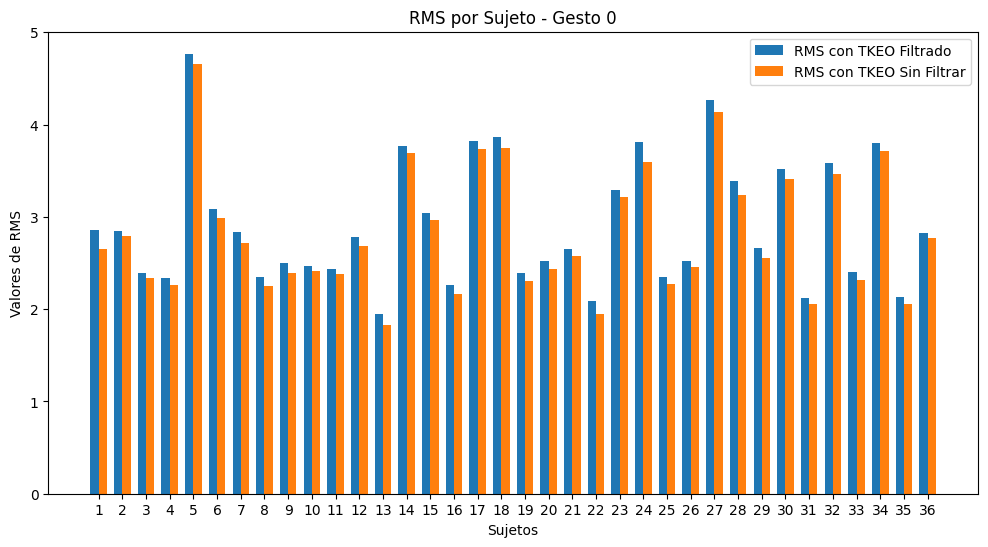

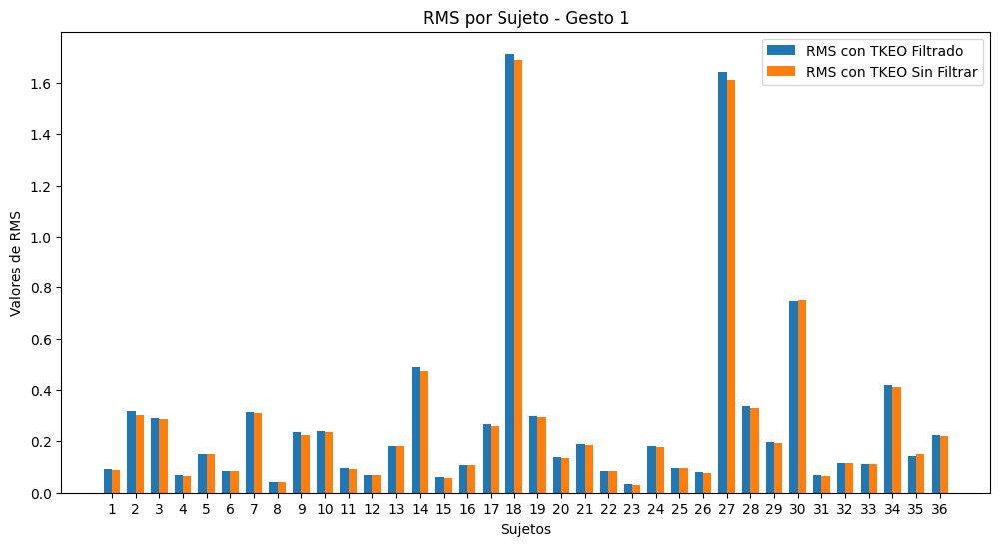

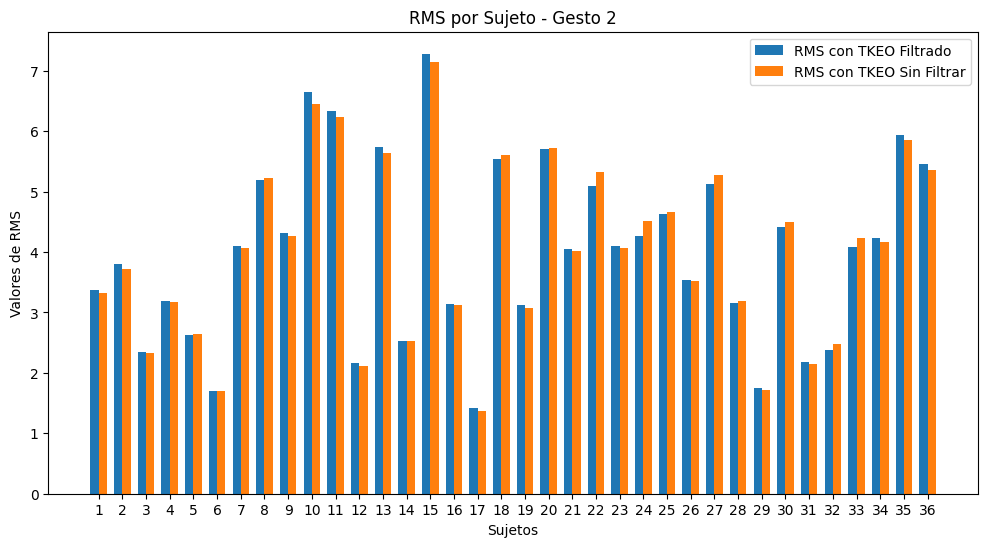

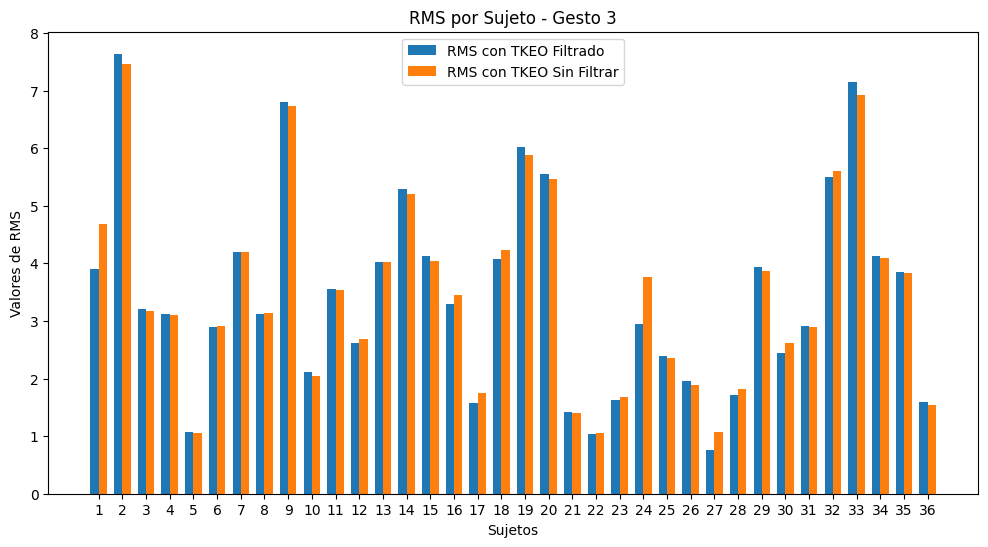

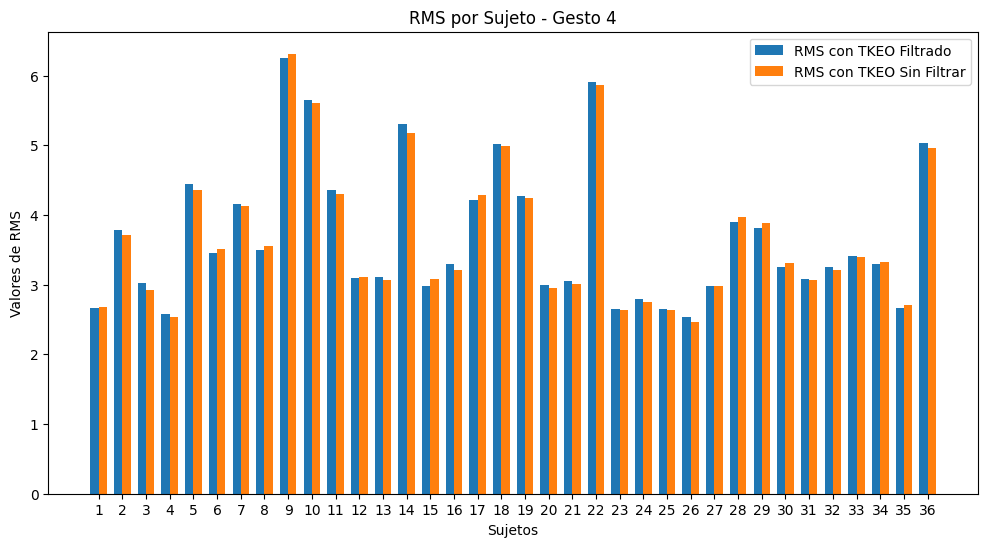

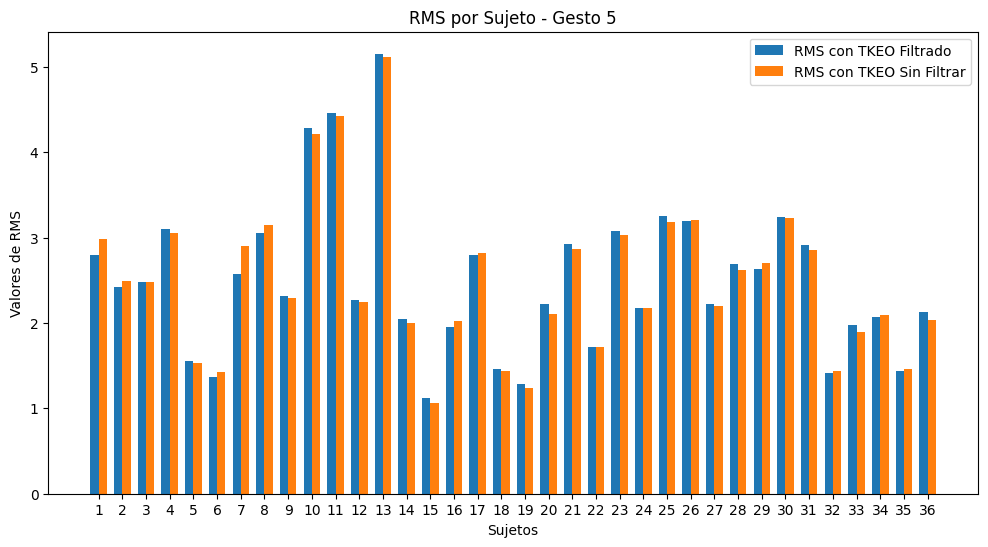

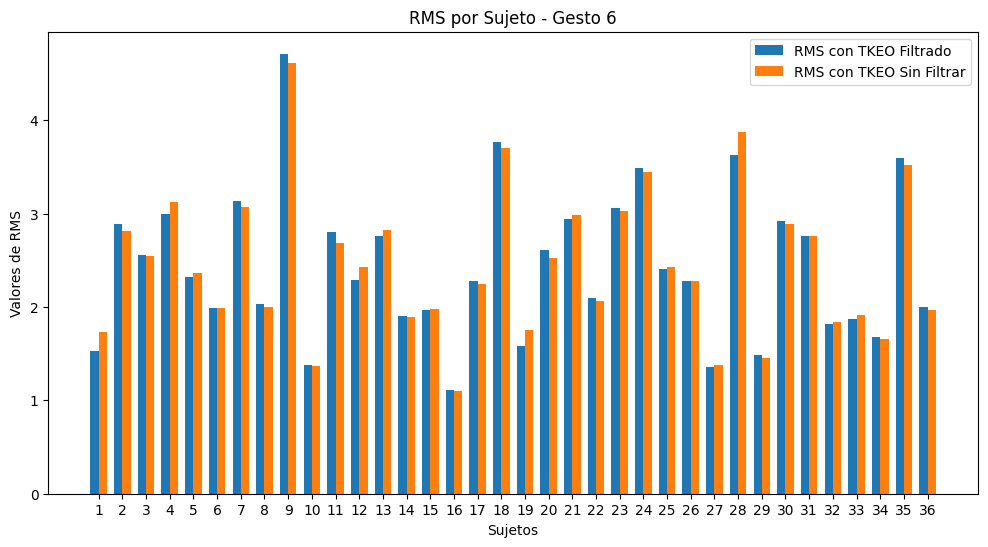

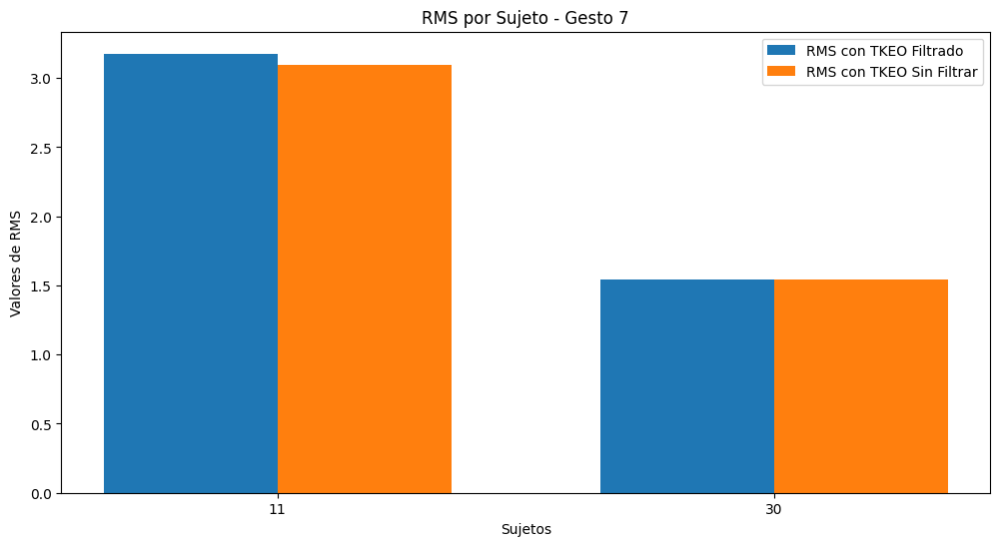

In [11]:
dataset = pd.read_csv('dataset.csv') #cargar los datos

#grafica para el RSM
def plot_histograma_rms_por_gesto(gesto):
    plt.figure(figsize=(12, 6))
    plt.title(f'RMS por Sujeto - Gesto {gesto}')
    plt.xlabel('Sujetos')
    plt.ylabel('Valores de RMS')

    sujetos = dataset.loc[dataset['Gesto'] == gesto, 'Sujeto'].unique()
    rms_filtrada = dataset.loc[dataset['Gesto'] == gesto, 'RMS_Filtrado']
    rms_original = dataset.loc[dataset['Gesto'] == gesto, 'RMS_Original']
    bar_width = 0.35
    index = np.arange(len(sujetos))

    plt.bar(index, rms_filtrada, bar_width, label='RMS con TKEO Filtrado')
    plt.bar(index + bar_width, rms_original, bar_width, label='RMS con TKEO Sin Filtrar')
    plt.xticks(index + bar_width / 2, sujetos)
    plt.legend()
    plt.show()

#grafica
for gesto in dataset['Gesto'].unique():
    plot_histograma_rms_por_gesto(gesto)


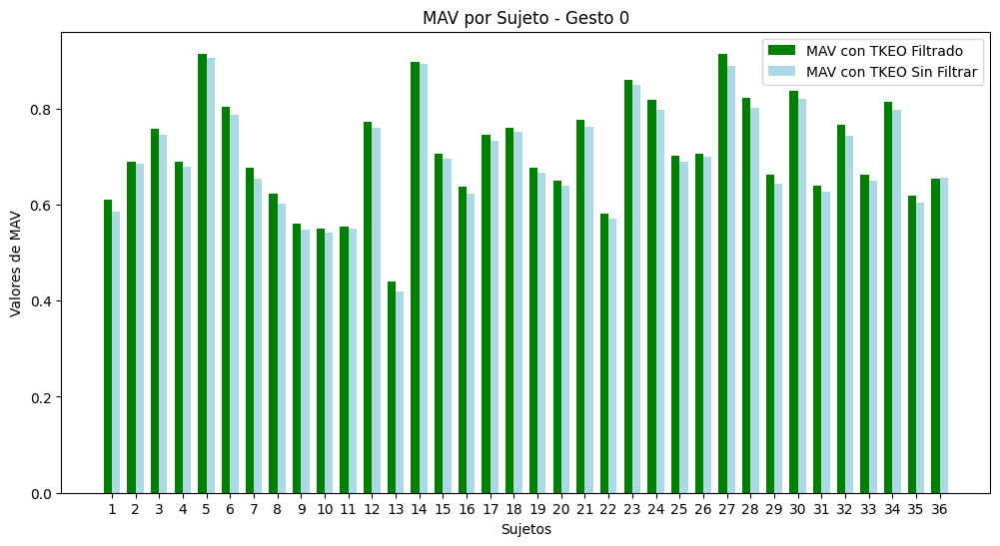

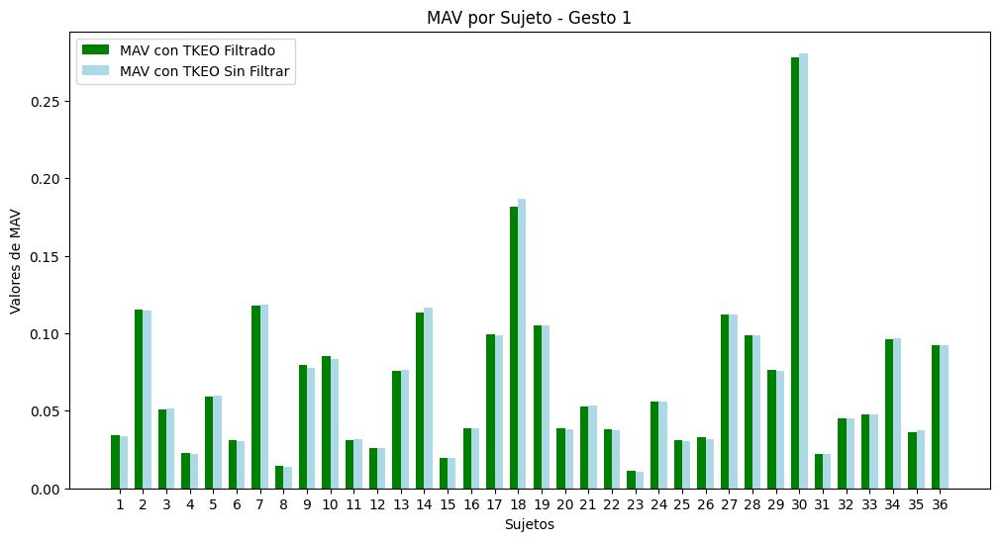

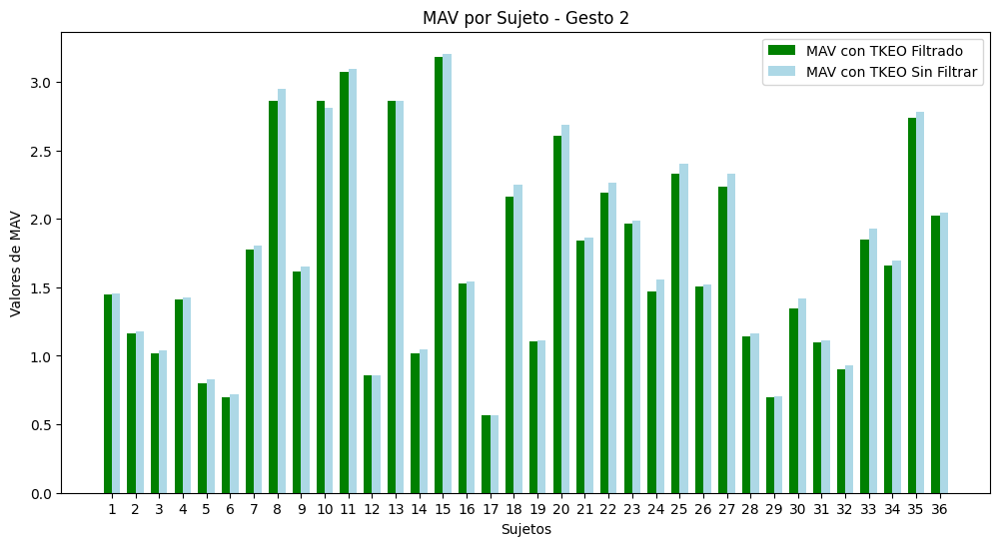

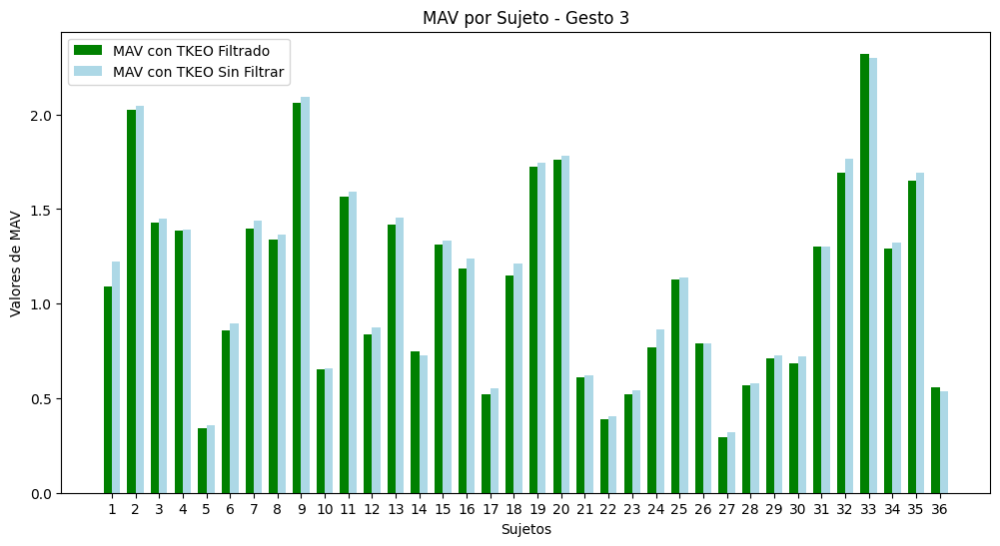

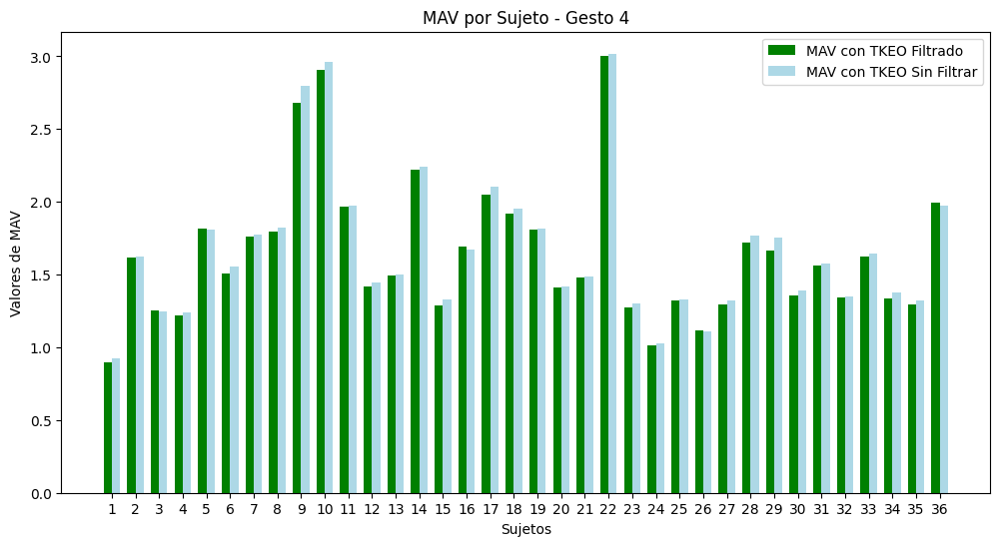

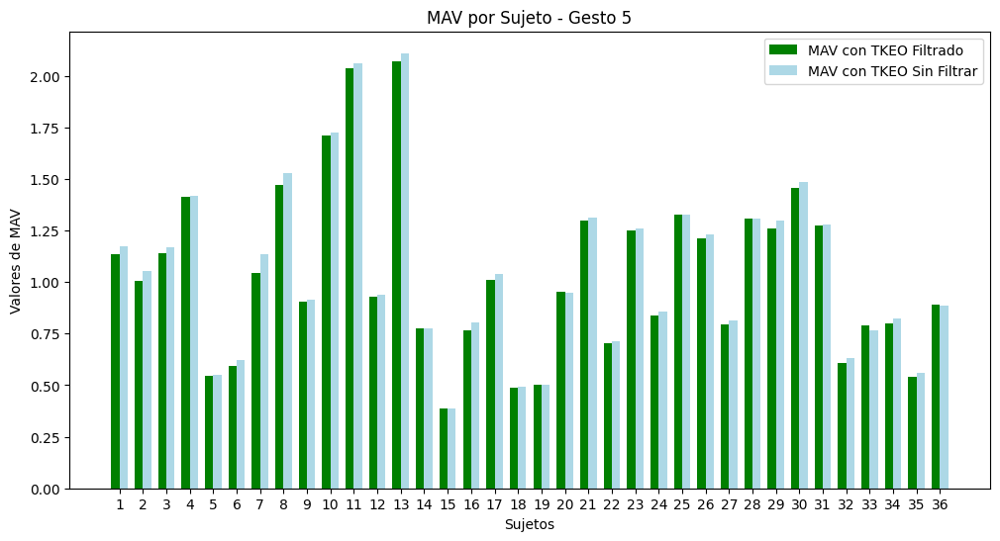

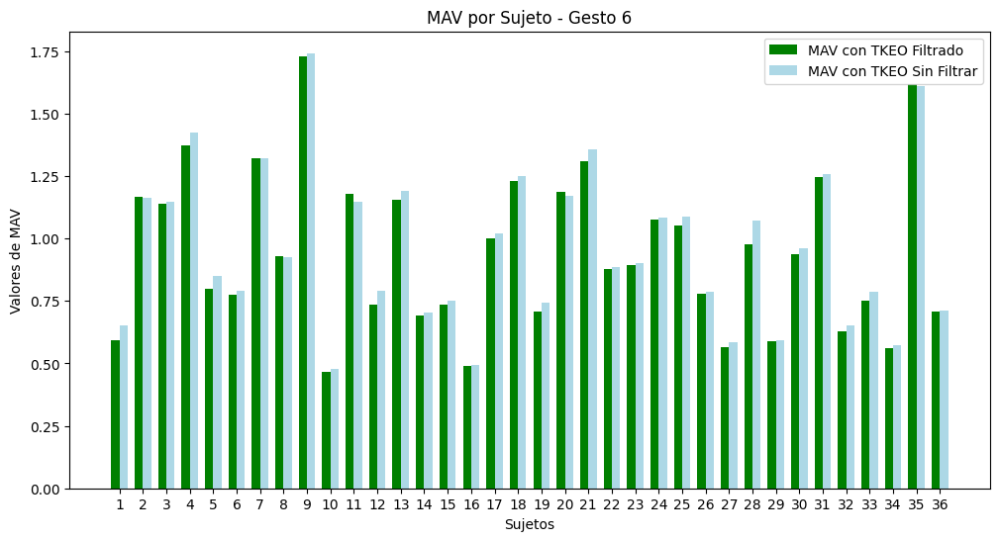

In [12]:
dataset = pd.read_csv('dataset.csv')
nombres_caracteristicas = ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC'] #lista de nombres de características

#grafica de MAV
def plot_histograma_mav_por_gesto(gesto):
    plt.figure(figsize=(12, 6))
    plt.title(f'MAV por Sujeto - Gesto {gesto}')
    plt.xlabel('Sujetos')
    plt.ylabel('Valores de MAV')

    sujetos = dataset.loc[dataset['Gesto'] == gesto, 'Sujeto'].unique()
    mav_filtrada = dataset.loc[dataset['Gesto'] == gesto, 'MAV_Filtrado']
    mav_original = dataset.loc[dataset['Gesto'] == gesto, 'MAV_Original']
    bar_width = 0.35
    index = np.arange(len(sujetos))

    plt.bar(index, mav_filtrada, bar_width, label='MAV con TKEO Filtrado', color='green')  # Color verde
    plt.bar(index + bar_width, mav_original, bar_width, label='MAV con TKEO Sin Filtrar', color='lightblue')  # Color azul claro
    plt.xticks(index + bar_width / 2, sujetos)
    plt.legend()
    plt.show()

#grafica
for gesto in range(7):
    plot_histograma_mav_por_gesto(gesto)

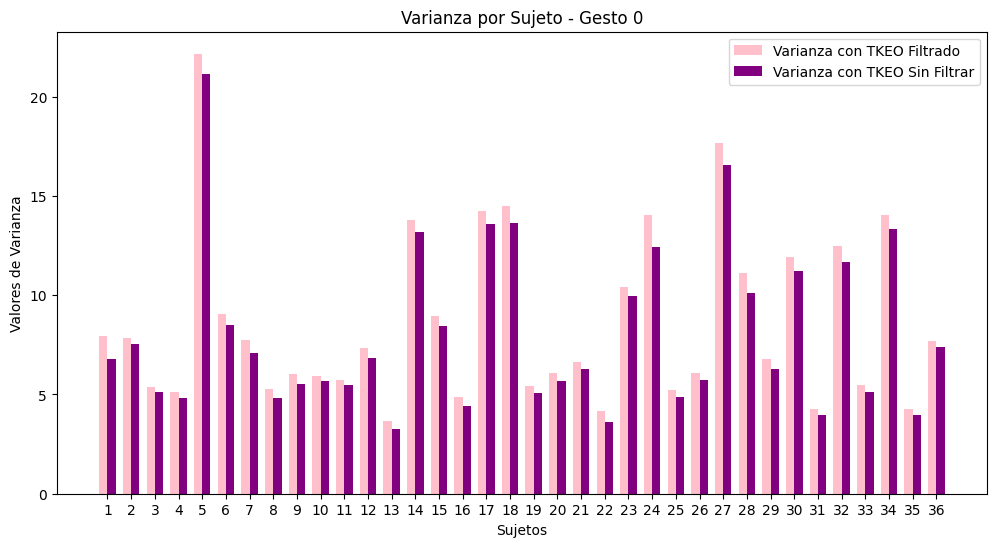

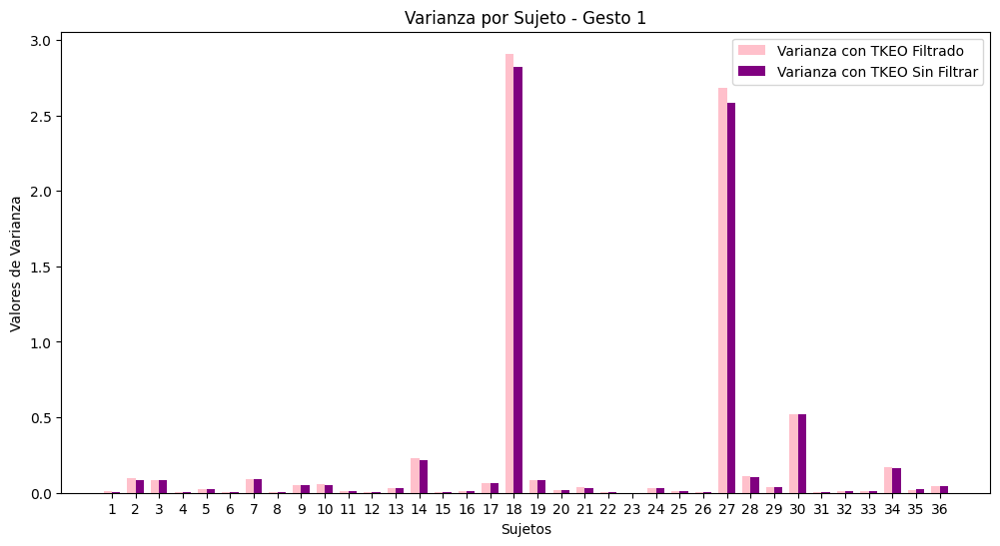

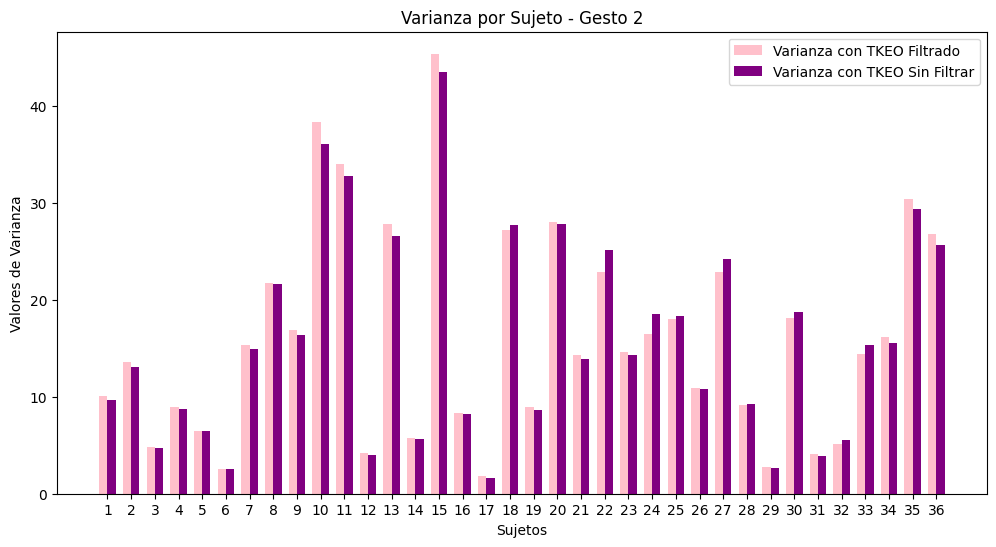

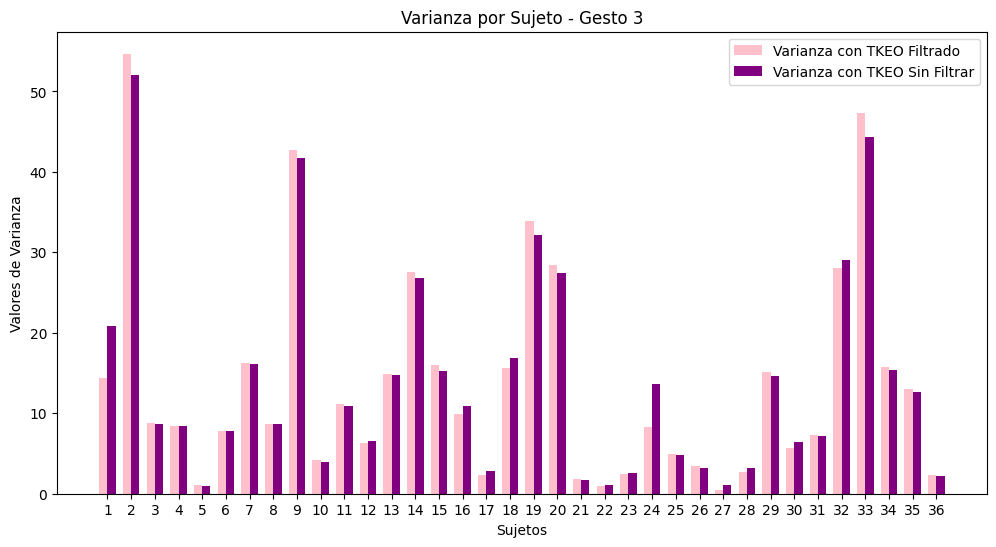

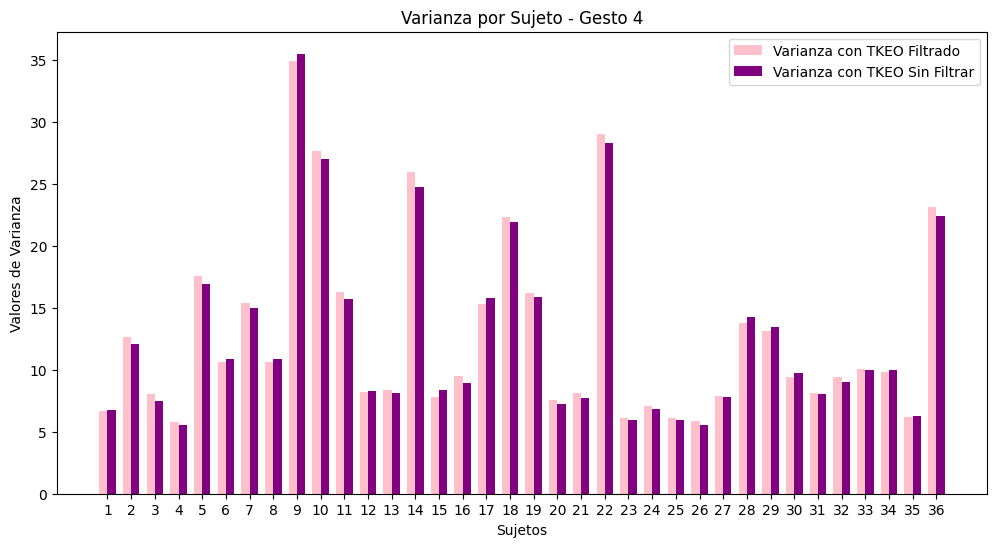

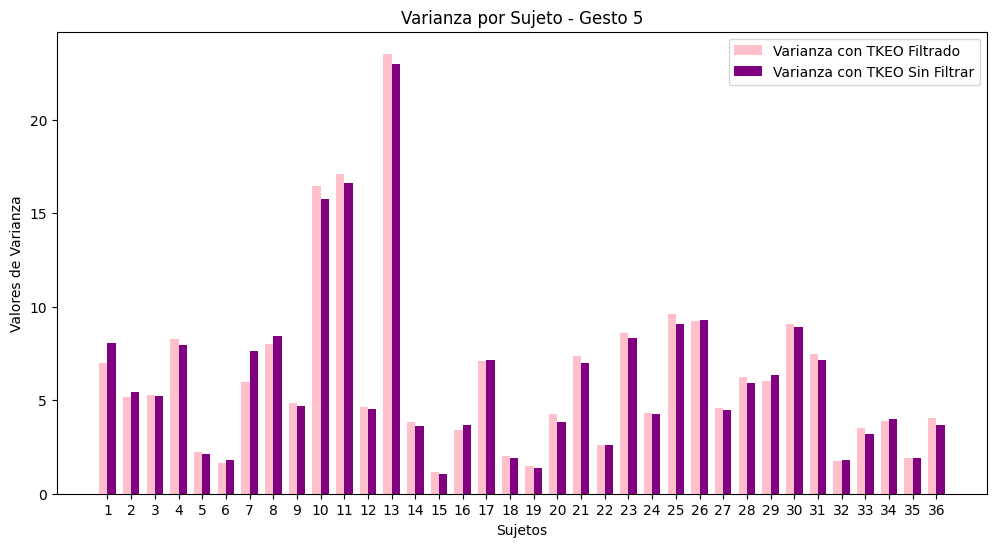

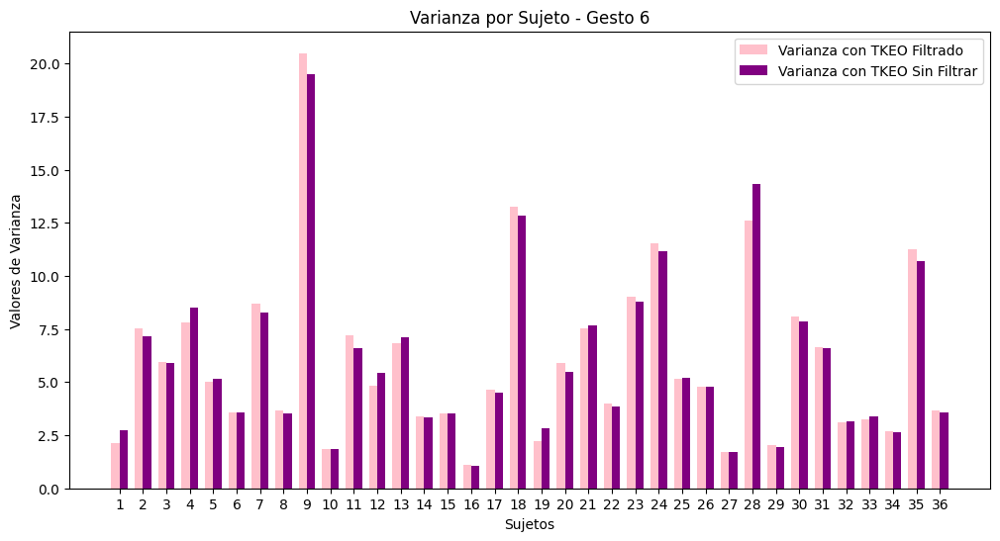

In [13]:
dataset = pd.read_csv('dataset.csv')
nombres_caracteristicas = ['RMS', 'Varianza', 'MAV', 'MAVS', 'SSC', 'WL', 'ZC'] #lista de nombres de características

#Varianza
def plot_histograma_varianza_por_gesto(gesto):
    plt.figure(figsize=(12, 6))
    plt.title(f'Varianza por Sujeto - Gesto {gesto}')
    plt.xlabel('Sujetos')
    plt.ylabel('Valores de Varianza')

    sujetos = dataset.loc[dataset['Gesto'] == gesto, 'Sujeto'].unique()
    varianza_filtrada = dataset.loc[dataset['Gesto'] == gesto, 'Varianza_Filtrado']
    varianza_original = dataset.loc[dataset['Gesto'] == gesto, 'Varianza_Original']

    bar_width = 0.35
    index = np.arange(len(sujetos))
    plt.bar(index, varianza_filtrada, bar_width, label='Varianza con TKEO Filtrado', color='pink')  # Color rosado
    plt.bar(index + bar_width, varianza_original, bar_width, label='Varianza con TKEO Sin Filtrar', color='purple')  # Color morado
    plt.xticks(index + bar_width / 2, sujetos)
    plt.legend()
    plt.show()

#grafica
for gesto in range(7):
    plot_histograma_varianza_por_gesto(gesto)

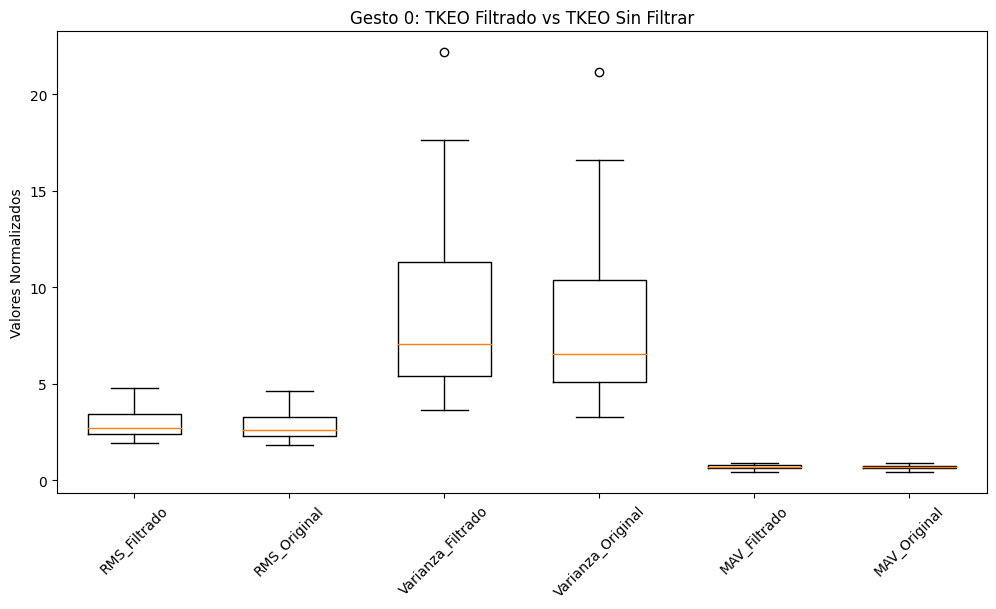

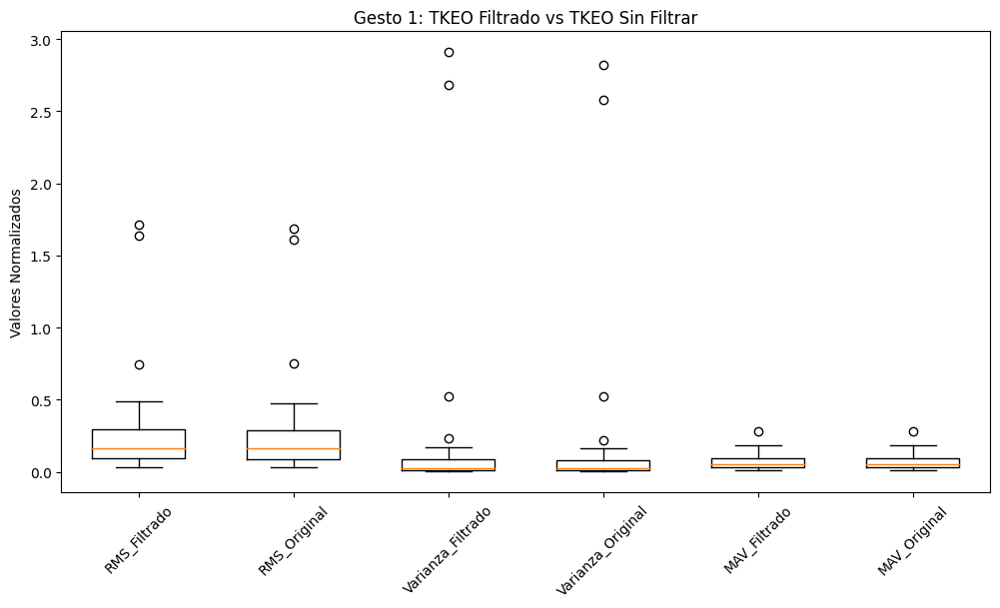

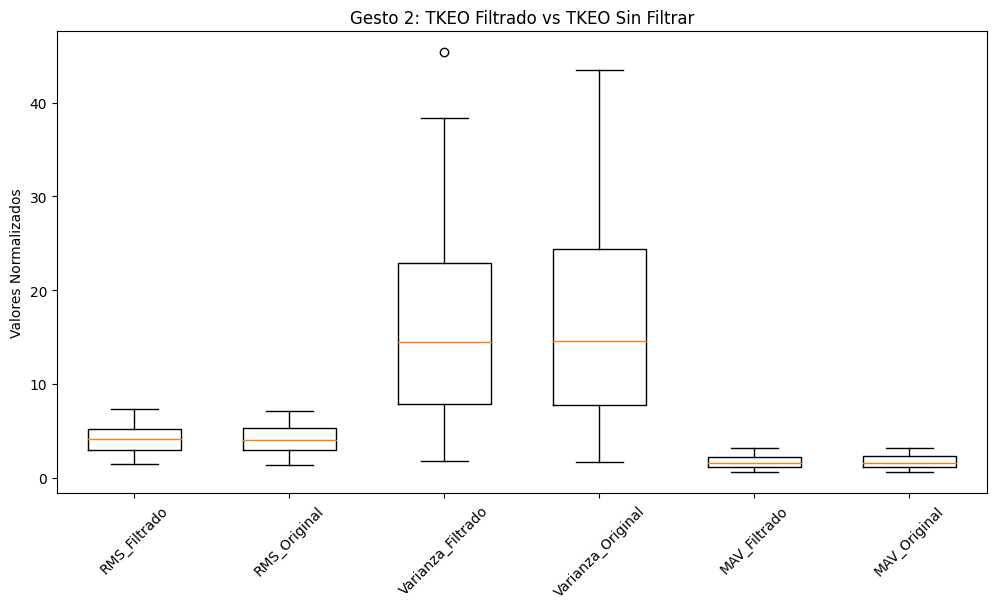

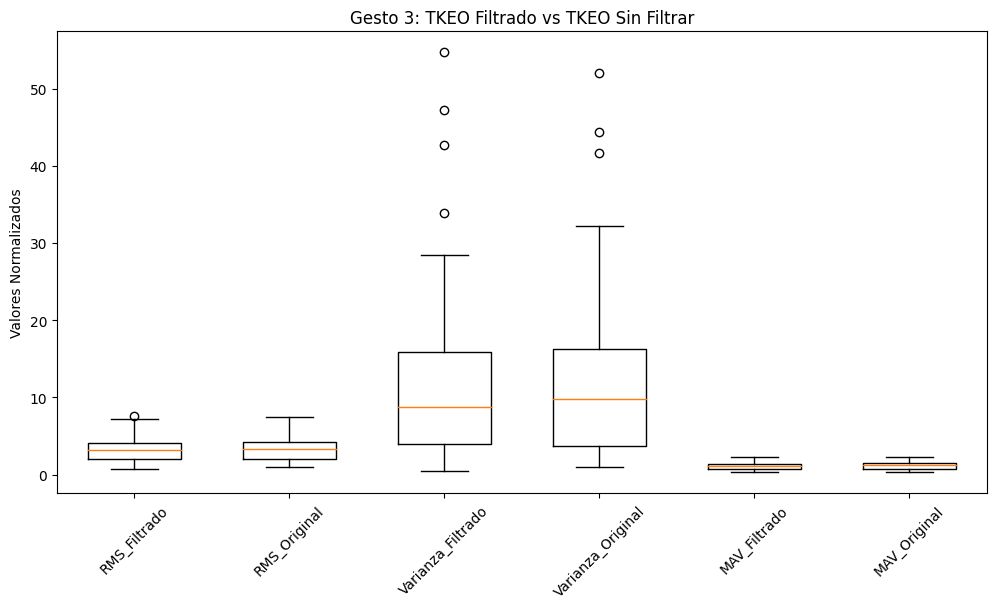

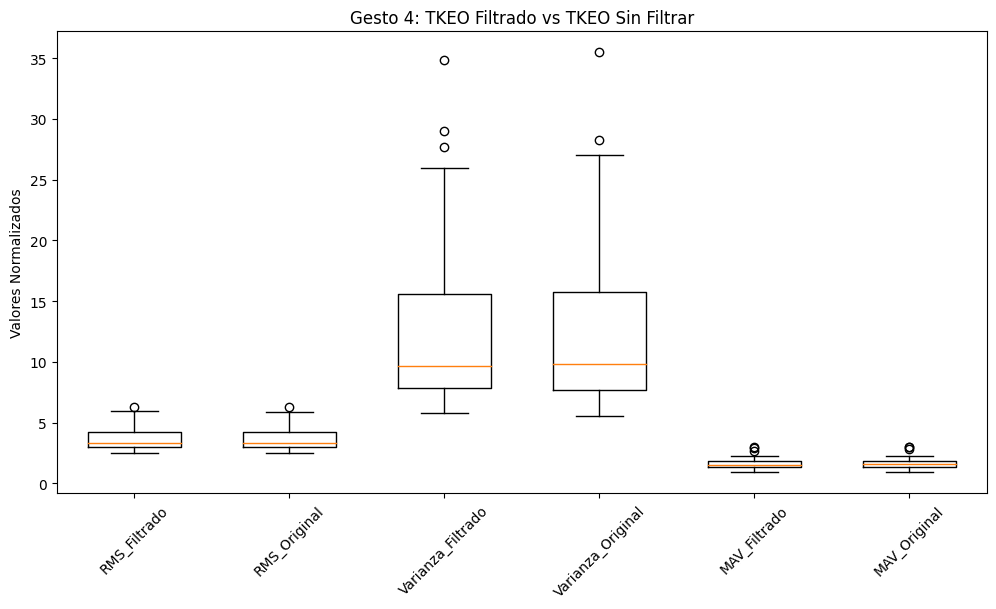

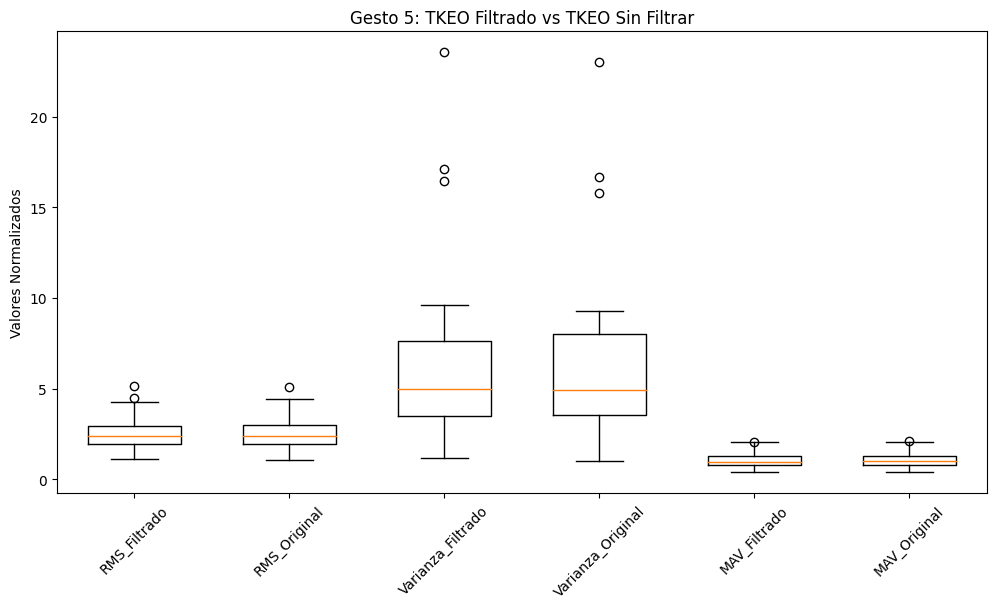

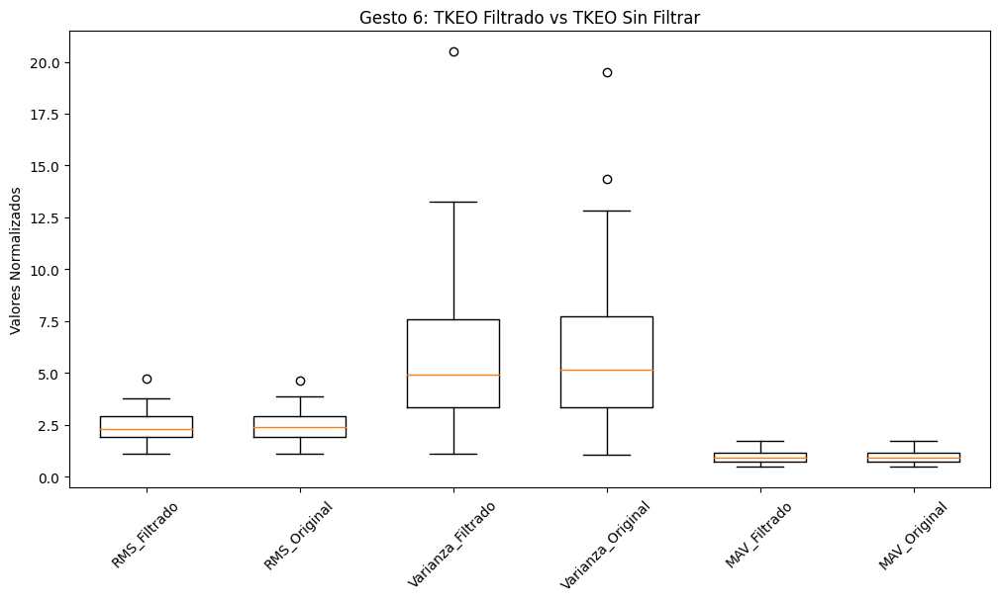

In [14]:
dataset = pd.read_csv('dataset.csv') #cargar datos
nombres_caracteristicas = ['RMS', 'Varianza', 'MAV'] #lista de nombres de características

#función para los boxplots
def plot_boxplot_tkeo_filtered_vs_unfiltered(gesto):
    plt.figure(figsize=(12, 6))
    plt.title(f'Gesto {gesto}: TKEO Filtrado vs TKEO Sin Filtrar')

    #para las características filtradas
    plt.boxplot([dataset.loc[dataset['Gesto'] == gesto, f'{feature}_Filtrado'] for feature in nombres_caracteristicas],
                labels=[f'{feature}_Filtrado' for feature in nombres_caracteristicas],
                positions=np.arange(len(nombres_caracteristicas)) * 2,
                widths=0.6)
    #para las características originales
    plt.boxplot([dataset.loc[dataset['Gesto'] == gesto, f'{feature}_Original'] for feature in nombres_caracteristicas],
                labels=[f'{feature}_Original' for feature in nombres_caracteristicas],
                positions=[x + 1 for x in np.arange(len(nombres_caracteristicas)) * 2],
                widths=0.6)
    plt.xticks(rotation=45)
    plt.ylabel('Valores Normalizados')
    plt.show()

#graficas
for gesto in range(7):
    plot_boxplot_tkeo_filtered_vs_unfiltered(gesto)


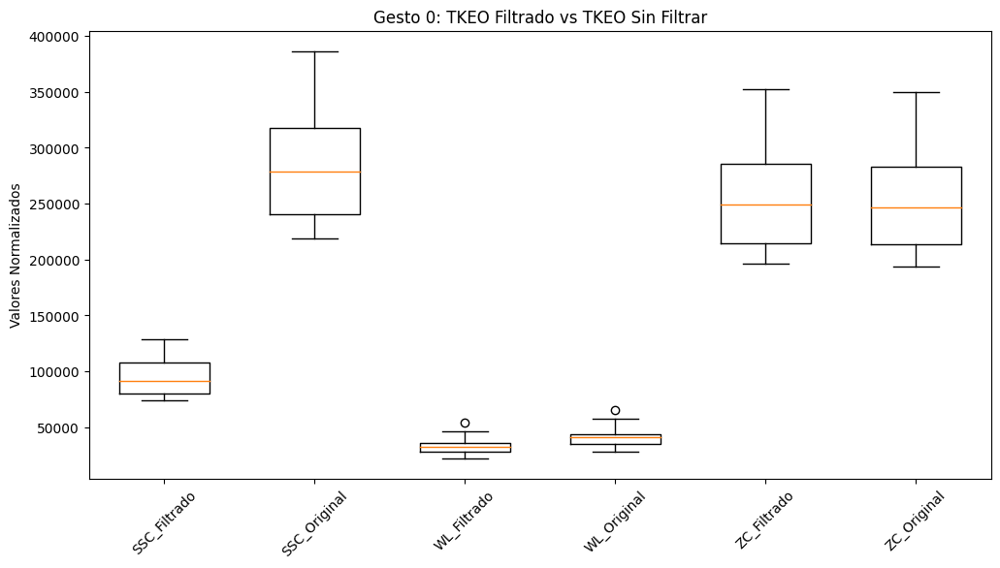

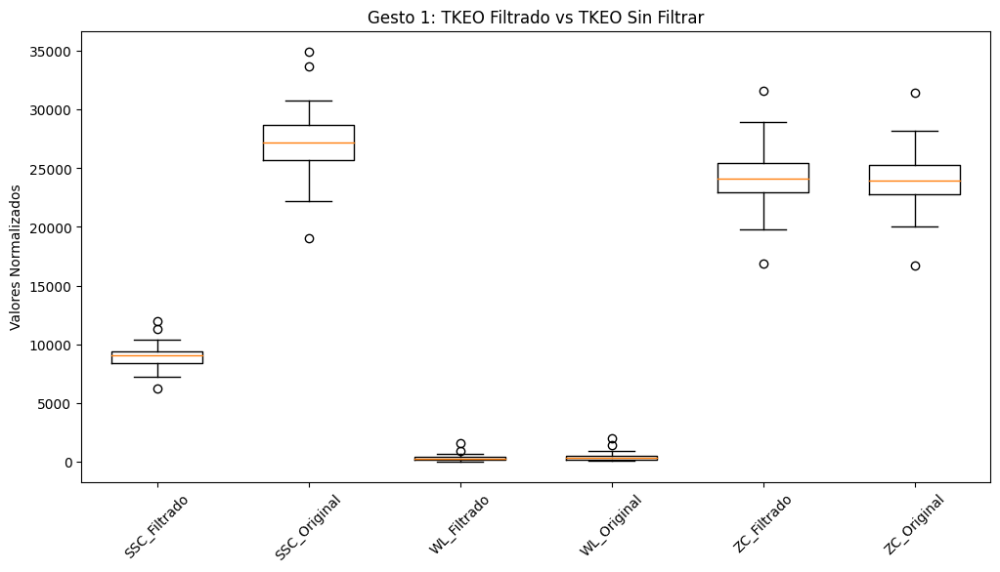

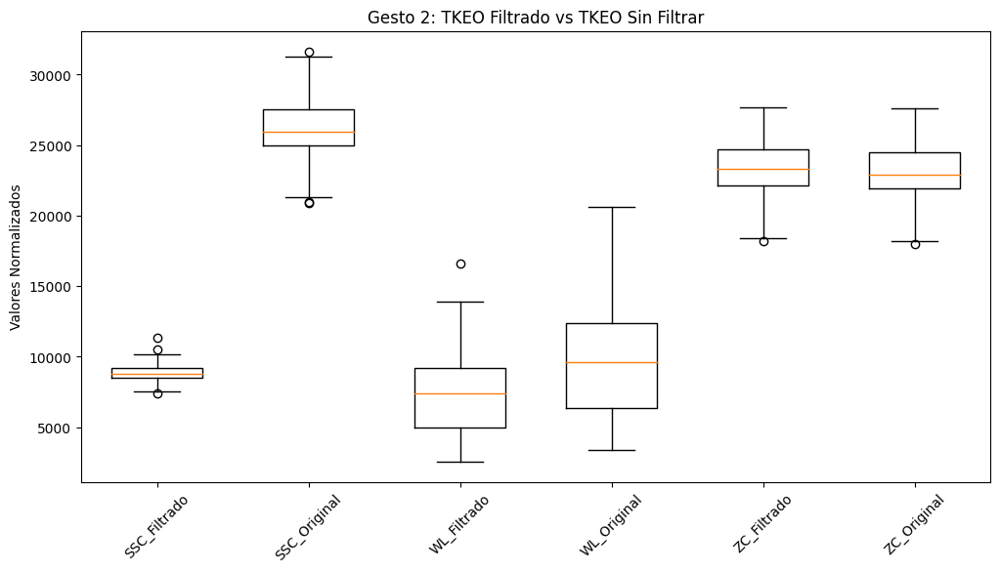

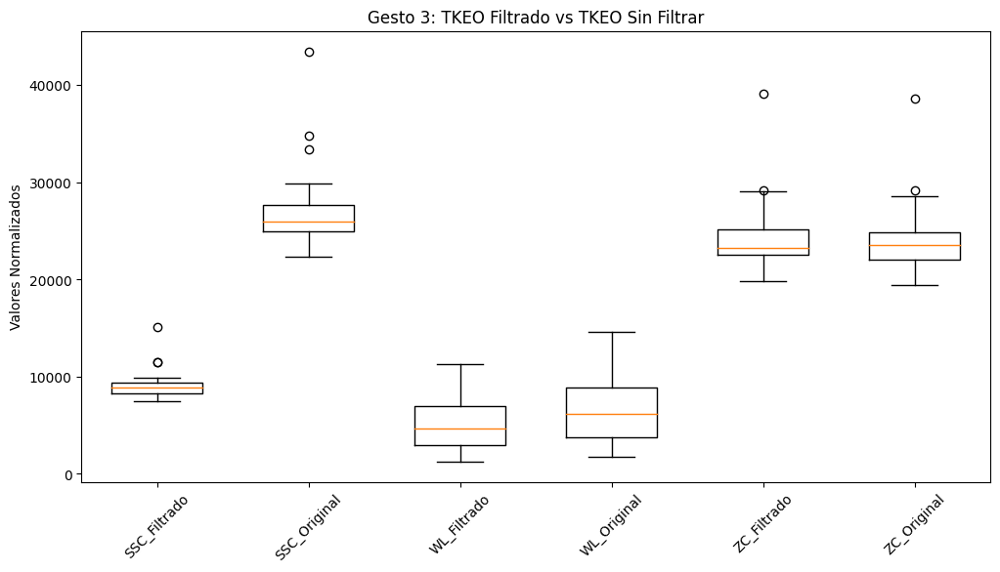

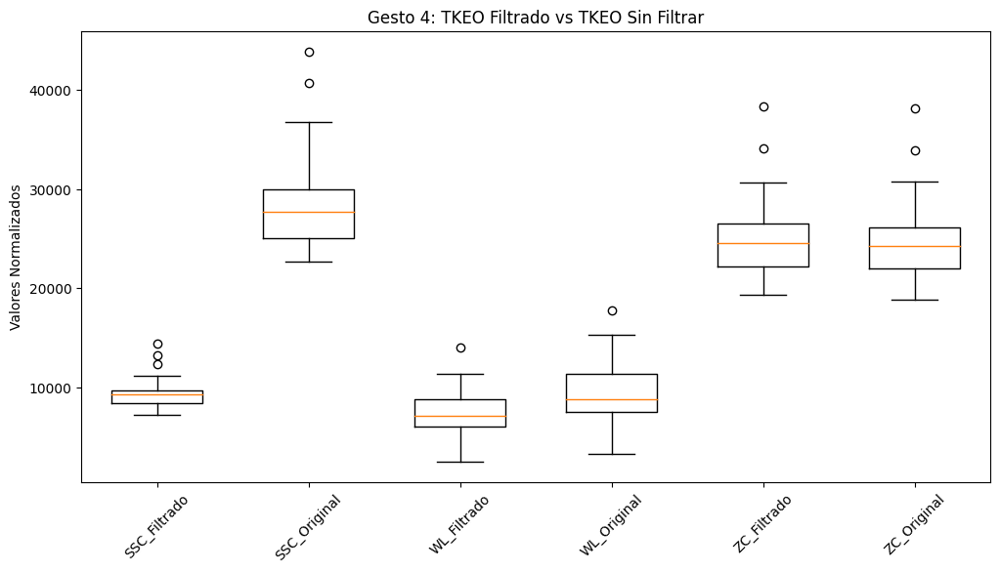

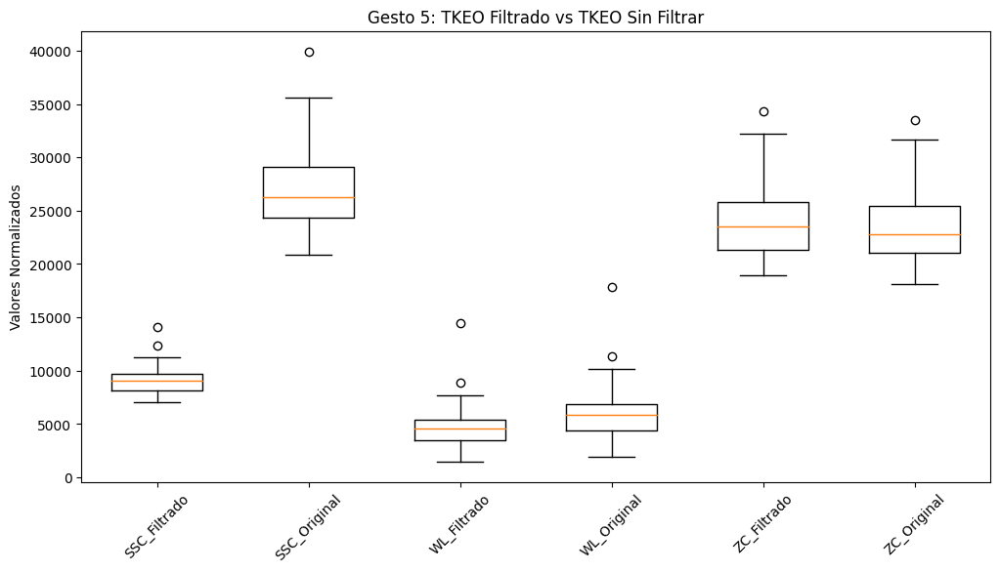

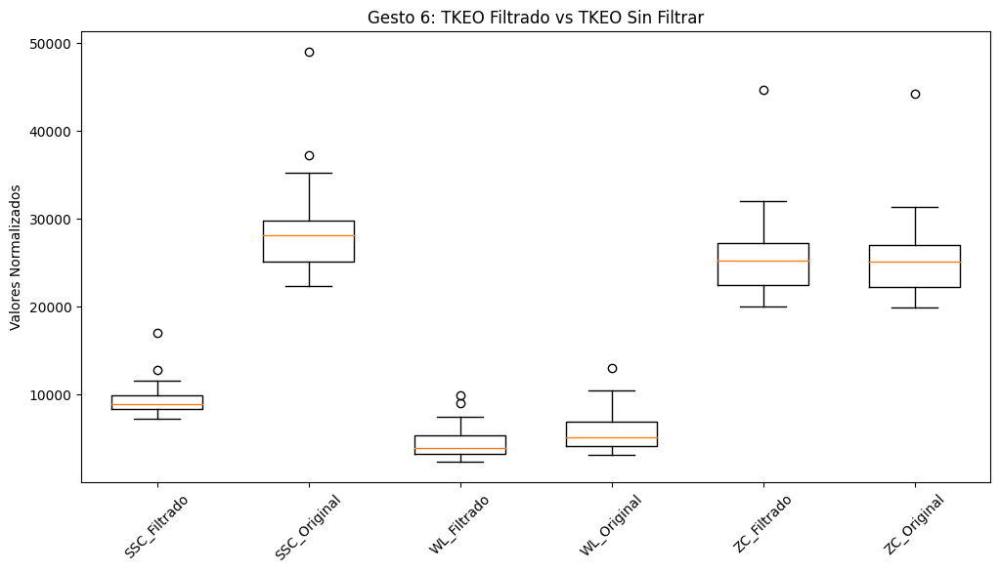

In [15]:
dataset = pd.read_csv('dataset.csv')
nombres_caracteristicas = ['SSC', 'WL', 'ZC'] #lista de nombres de características que se desean mostrar

#función para generar los boxplots
def plot_boxplot_tkeo_filtered_vs_unfiltered(gesto):
    plt.figure(figsize=(12, 6))
    plt.title(f'Gesto {gesto}: TKEO Filtrado vs TKEO Sin Filtrar')

    #para las características filtradas
    plt.boxplot([dataset.loc[dataset['Gesto'] == gesto, f'{feature}_Filtrado'] for feature in nombres_caracteristicas],
                labels=[f'{feature}_Filtrado' for feature in nombres_caracteristicas],
                positions=np.arange(len(nombres_caracteristicas)) * 2,
                widths=0.6)
    #para las características originales
    plt.boxplot([dataset.loc[dataset['Gesto'] == gesto, f'{feature}_Original'] for feature in nombres_caracteristicas],
                labels=[f'{feature}_Original' for feature in nombres_caracteristicas],
                positions=[x + 1 for x in np.arange(len(nombres_caracteristicas)) * 2],
                widths=0.6)
    plt.xticks(rotation=45)
    plt.ylabel('Valores Normalizados')
    plt.show()

#graficas
for gesto in range(7):
    plot_boxplot_tkeo_filtered_vs_unfiltered(gesto)

 **E. CODIGO Y ANALISIS DE RESULTADOS DONDE SE DISCUTAN POR LO MENOS TRES DIFERENTES ARQUITECTURAS DE RED Y LAS MATRICES DE CONFUSION OBTENIDAS, VALIDACION CRUZADA, DE UNA RED NEURONAL QUE PERMITA LA CLASIFICACION DE LOS DIFERENTES GESTOS (ETIQUETAS CON LOS DATOS DEL PRIMER PROYECTO)**
 ------


Arquitectura de redes neuronales:

Una **capa** agrupa varias neuronas.
Siempre habrá una capa de entrada y otra de salida.

Podemos tener cero o más capas ocultas en una red neuronal.

El proceso de aprendizaje de una red neuronal se realiza con las capas.

Las neuronas, dentro de cada una de las capas de una red neuronal, realizan la misma función. Simplemente calculan la suma ponderada de entradas y pesos, añaden el sesgo y ejecutan una función de activación.

* Capa de entrada:
El número de neuronas en una capa de entrada depende de la forma de sus datos de entrenamiento.

**número_neuronas = número_características + 1**

Un nodo adicional es para capturar el término de sesgo.

* Capa de salida

La capa de salida es la encargada de producir el resultado final.

Siempre debe haber una capa de salida en una red neuronal.

**¿Cuántas neuronas hay en la capa de salida?**

Si la red neuronal es un regresor, la capa de salida tiene un único nodo.
Si la red neuronal es un clasificador, también tiene un único nodo.
Si utiliza una función de activación probabilística como softmax, la capa de salida tiene un nodo por cada etiqueta de clase del modelo.

* Capa oculta

Las capas ocultas se encuentran entre las capas de entrada y salida.

Puede haber cero o más capas ocultas en una red neuronal.

Normalmente, cada capa oculta contiene el mismo número de neuronas.

Cuanto mayor sea el número de capas ocultas de una red neuronal, más tardará ésta en producir la salida y más complejos serán los problemas que pueda resolver.

El número óptimo de neuronas capas ocultas se puede determinar por:

 **número_neuronas = (muestras de datos comerciales)/(factor*(neuronas_entrada+neuronas_salida))**

El factor se utiliza para evitar el sobreajuste y es un número entre 1-10.

**El número de neuronas ocultas debe estar entre el tamaño de la capa de entrada y el tamaño de la capa de salida.
El número de neuronas ocultas debe ser 2/3 del tamaño de la capa de entrada, más el tamaño de la capa de salida.
El número de neuronas ocultas debe ser inferior al doble del tamaño de la capa de entrada.**



In [16]:
#Primera estructura:
#Arquitectura 1: Red Neuronal Densa Simple
#Capa de Entrada:
#Neuronas: numero de caracterisitas+1
#Dado que tenemos 8 canales EMG, la capa de entrada tendrá 9 neuronas (8 canales + 1 término de sesgo).
#Capas Ocultas:
#Usaremos 2 capas ocultas con neuronas calculadas basadas en las reglas proporcionadas.
#Capa de Salida:
#Neuronas: 7 (una por cada clase de gesto)
#Función de activación: Softmax

# Step 1 - Loading the Required Libraries and Modules
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from math import sqrt
from sklearn.metrics import r2_score
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.model_selection import learning_curve

# %% Step 2 - Reading the Data and Performing Basic Data Checks
print(dataset.shape)

(254, 16)


In [17]:
dataset

,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
0,1,0,2.860676,7.940016,0.610183,0.081879,96946.0,27566.994011,271810.0,2.649355,6.797976,0.584473,0.099058,299718.0,33350.912449,271156.0
1,1,1,0.093647,0.008434,0.034263,0.004811,9142.0,152.844782,26924.0,0.089559,0.007707,0.033592,0.005767,29436.0,183.202903,27036.0
2,1,2,3.374316,10.125666,1.445554,0.208161,8504.0,6144.898953,23414.0,3.315706,9.707690,1.455682,0.247083,26032.0,7293.882110,23302.0
3,1,3,3.904278,14.412565,1.091310,0.136332,8792.0,4309.169005,25102.0,4.681186,20.830229,1.225196,0.190176,26108.0,6011.079998,24426.0
4,1,4,2.670978,6.702385,0.898792,0.083343,8458.0,2536.785862,24760.0,2.681477,6.727591,0.922511,0.107139,26906.0,3261.096122,24216.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249,36,2,5.451817,26.780721,2.023480,0.302905,7508.0,7780.418641,18380.0,5.347901,25.608808,2.041461,0.384307,21298.0,9871.319967,18194.0
250,36,3,1.595851,2.335125,0.556263,0.078494,7772.0,2117.230339,20902.0,1.532046,2.151818,0.538454,0.098289,23592.0,2651.161929,20860.0
251,36,4,5.030005,23.088995,1.996412,0.253091,7238.0,6277.677200,20006.0,4.956919,22.401818,1.976151,0.333625,22786.0,8275.244212,19794.0
252,36,5,2.124096,4.041136,0.889060,0.124062,7614.0,3265.925939,20384.0,2.039475,3.698061,0.883890,0.154289,22738.0,4061.663819,20074.0


In [18]:
dataset.head()

,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
0,1,0,2.860676,7.940016,0.610183,0.081879,96946.0,27566.994011,271810.0,2.649355,6.797976,0.584473,0.099058,299718.0,33350.912449,271156.0
1,1,1,0.093647,0.008434,0.034263,0.004811,9142.0,152.844782,26924.0,0.089559,0.007707,0.033592,0.005767,29436.0,183.202903,27036.0
2,1,2,3.374316,10.125666,1.445554,0.208161,8504.0,6144.898953,23414.0,3.315706,9.707690,1.455682,0.247083,26032.0,7293.882110,23302.0
3,1,3,3.904278,14.412565,1.091310,0.136332,8792.0,4309.169005,25102.0,4.681186,20.830229,1.225196,0.190176,26108.0,6011.079998,24426.0
4,1,4,2.670978,6.702385,0.898792,0.083343,8458.0,2536.785862,24760.0,2.681477,6.727591,0.922511,0.107139,26906.0,3261.096122,24216.0


In [19]:
dataset.describe()

,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
count,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000
mean,18.515748,3.031496,2.746792,9.050367,1.032284,0.150817,21295.291339,8925.929491,56891.393701,2.736022,8.927422,1.047335,0.192646,63702.425197,11264.052528,56372.677165
std,10.403602,2.027234,1.575667,9.118343,0.674617,0.097313,30628.668221,10520.293513,82071.051155,1.565508,8.894098,0.685944,0.123662,91607.099654,13061.603134,81422.763309
min,1.000000,0.000000,0.032832,0.001056,0.010986,0.001651,6232.000000,52.239224,16874.000000,0.031751,0.000983,0.010686,0.002185,19028.000000,69.149015,16696.000000
25%,10.000000,1.000000,1.828964,3.140722,0.612368,0.091154,8454.000000,3095.350145,22455.000000,1.834713,3.174841,0.622455,0.117275,25092.500000,3950.301376,22140.000000
50%,18.500000,3.000000,2.679304,6.679055,0.904221,0.133270,9171.000000,5269.093161,24421.000000,2.689724,6.594664,0.909447,0.168071,27456.000000,6681.500350,24259.000000
75%,27.750000,5.000000,3.590972,12.343055,1.411683,0.208748,10181.000000,8861.033828,27913.000000,3.580710,11.970538,1.423082,0.262160,30868.500000,11489.118767,27613.000000
max,36.000000,7.000000,7.638577,54.694084,3.184483,0.444022,128360.000000,53984.684579,352334.000000,7.458346,52.022046,3.205387,0.573176,386494.000000,65755.774396,349274.000000


In [76]:
#Creación de matrices para las características y la variable de respuesta
target_column = ['Gesto']
predictors = list(set(list(dataset.columns))-set(target_column)-set(['Sujeto'])-set(['MAVS_Original'])-set(['MAV_Original'])-set(['RMS_Original'])-set(['WL_Original'])-set(['SSC_Original'])-set(['Varianza_Original'])-set('ZC_Original'))
print(predictors)

dataset[predictors] = dataset[predictors]/dataset[predictors].max() #variables normalizadas
dataset.describe()

['ZC_Filtrado', 'SSC_Filtrado', 'Varianza_Filtrado', 'WL_Filtrado', 'MAVS_Filtrado', 'ZC_Original', 'RMS_Filtrado', 'MAV_Filtrado']


,Sujeto,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado,RMS_Original,Varianza_Original,MAV_Original,MAVS_Original,SSC_Original,WL_Original,ZC_Original
count,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000,254.000000
mean,18.515748,3.031496,0.359595,0.165472,0.324161,0.339660,0.165903,0.165342,0.161470,2.736022,8.927422,1.047335,0.192646,63702.425197,11264.052528,0.161400
std,10.403602,2.027234,0.206278,0.166715,0.211845,0.219163,0.238615,0.194876,0.232935,1.565508,8.894098,0.685944,0.123662,91607.099654,13061.603134,0.233120
min,1.000000,0.000000,0.004298,0.000019,0.003450,0.003718,0.048551,0.000968,0.047892,0.031751,0.000983,0.010686,0.002185,19028.000000,69.149015,0.047802
25%,10.000000,1.000000,0.239438,0.057423,0.192298,0.205292,0.065862,0.057338,0.063732,1.834713,3.174841,0.622455,0.117275,25092.500000,3950.301376,0.063389
50%,18.500000,3.000000,0.350760,0.122117,0.283946,0.300143,0.071447,0.097603,0.069312,2.689724,6.594664,0.909447,0.168071,27456.000000,6681.500350,0.069455
75%,27.750000,5.000000,0.470110,0.225674,0.443301,0.470130,0.079316,0.164140,0.079223,3.580710,11.970538,1.423082,0.262160,30868.500000,11489.118767,0.079058
max,36.000000,7.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.458346,52.022046,3.205387,0.573176,386494.000000,65755.774396,1.000000


In [77]:
#creación de los conjuntos de datos de entrenamiento y de prueba
X = dataset[predictors].values
y = dataset[target_column].values

#se utiliza la misma semilla para particionar y obtener los mismos resultados
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=40)
y_test = np.squeeze(y_test)
y_train = np.squeeze(y_train)

#Se muestra el tamaño de los datos
print(f' Tamaño de las caracteristicas los datos de entrenamiento: {X_train.shape}')
print(f' Tamaño de la salida de los datos de entrenamiento: {y_train.shape}')

print(f' Tamaño de las caracteristicas los datos de prueba: {X_test.shape}')
print(f' Tamaño de la salida de los datos de prueba: {y_test.shape}')

##sacar cada clase del conjunto de datos partido (para saber si los numeros tienen sentido) con la matriz de confusion
# Opcional: Mostrar la distribución de clases de forma más amigable
unique, counts_train = np.unique(y_train, return_counts=True)
unique, counts_test = np.unique(y_test, return_counts=True)

print(f'\nDistribución de clases en los datos de entrenamiento:\n{dict(zip(unique, counts_train))}')
print(f'\nDistribución de clases en los datos de prueba:\n{dict(zip(unique, counts_test))}')

 Tamaño de las caracteristicas los datos de entrenamiento: (177, 8)
 Tamaño de la salida de los datos de entrenamiento: (177,)
 Tamaño de las caracteristicas los datos de prueba: (77, 8)
 Tamaño de la salida de los datos de prueba: (77,)

Distribución de clases en los datos de entrenamiento:
{0: 22, 1: 24, 2: 27, 3: 28, 4: 25, 5: 23, 6: 26}

Distribución de clases en los datos de prueba:
{0: 14, 1: 12, 2: 9, 3: 8, 4: 11, 5: 13, 6: 10}


*el codigo hasta aqui prepara los datos y configurando el entorno para entrenar y evaluar un modelo de red neuronal densa (también conocida como perceptrón multicapa o MLP) con el fin de realizar la tarea de clasificación de gestos utilizando las señales de EMG. primero importamos las librerías y módulos necesarios de scikit-learn para construir, entrenar y evaluar el modelo de red neuronal, luego leemos el conjunto de datos desde un archivo CSV, se selecciona las características (predictores) y la variable objetivo (Gesto) del conjunto de datos, se normaliza las características para que tengan una escala similar, se divide el conjunto de datos en conjuntos de entrenamiento y prueba, utilizando una semilla específica para obtener resultados reproducibles y por ultimo queremos mostrar la forma y tamaño de los conjuntos de entrenamiento y prueba para verificar que los datos se han cargado correctamente.*

**Número de neuronas de entrada:**

Número de neuronas = número de caracteristicas + 1

* Número de caracteristicas : 7

Número de neuronas = 8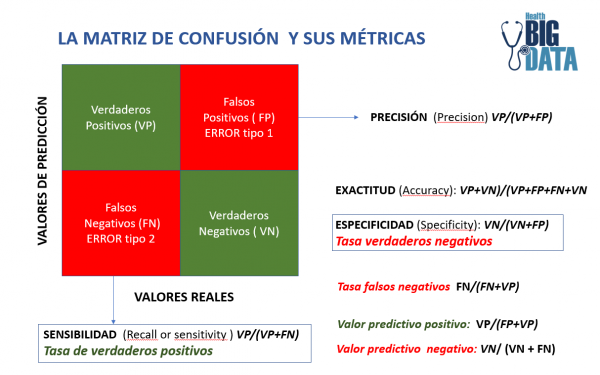

**Número de neuronas en la capa de salida:**

La capa de salida es la responsable de producir el resultado final. Se considera una capa de salida en una red neuronal
neural.

**Número optimo de neuronas ocultas:**

El número de neuronas ocultas debe estar entre el tamaño de la capa de entrada y el tamaño de la capa de salida.
El número de neuronas ocultas debe ser 2/3 del tamaño de la capa de entrada, más el tamaño de la capa de salida.
El número de neuronas ocultas debe ser inferior a dos veces el tamaño de la capa de entrada.

In [78]:
#Código de la matriz de confusión
from itertools import product
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    fig=plt.figure()
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

**Primera arquitectura**
--
'lbfgs' puede converger más rápido y funcionar mejor

*el codigo está implementando la primera arquitectura de red neuronal propuesta, la arquitectura definida consiste en una capa de entrada cuyo tamaño depende del número de características, tres capas ocultas con 8 neuronas cada una y una función de activación ReLU, y una capa de salida con 7 neuronas, una por cada clase de gesto, y una función de activación Softmax para obtener probabilidades de clasificación, se entrena el modelo utilizando los datos de entrenamiento (X_train, y_train) y se realizan predicciones tanto en los datos de entrenamiento como en los datos de prueba (X_test, y_test), se busca evalúar el rendimiento del modelo calculando la matriz de confusión y el informe de clasificación para los datos de entrenamiento y prueba. La matriz de confusión muestra la distribución de las predicciones correctas e incorrectas para cada clase, mientras que el informe de clasificación proporciona métricas como precisión, recall, f1-score y soporte para cada clase.*

In [79]:
#Three hidden layer each layer with eigth neurons
mlp = MLPClassifier(hidden_layer_sizes=(9,9),
                    activation='tanh',
                    solver='lbfgs',
                    max_iter=50000,
                    alpha= 0.1,
                      learning_rate='adaptive', # Cambios en la tasa de aprendizaje
                      random_state=1,
                      validation_fraction=0.1,
                      n_iter_no_change=10)
print(mlp)
print('' )

#Se entrena el modelo y se realizan las predicciones
mlp.fit(X_train,y_train)

predict_train = mlp.predict(X_train)
print(predict_train)
predict_test = mlp.predict(X_test)
print(predict_test)

MLPClassifier(activation='tanh', alpha=0.1, hidden_layer_sizes=(9, 9),
              learning_rate='adaptive', max_iter=50000, random_state=1,
              solver='lbfgs')

[6 5 6 1 1 0 6 3 1 2 2 1 3 5 3 6 4 3 1 6 6 6 4 2 3 3 0 4 6 4 2 5 6 4 2 0 4
 4 2 3 0 2 2 0 5 5 2 0 3 0 6 6 4 1 5 1 2 3 3 2 5 2 1 2 3 4 3 5 4 4 3 6 0 4
 6 4 0 0 4 6 0 2 4 6 1 2 0 6 4 3 5 3 2 3 6 4 0 6 2 2 3 1 1 0 2 1 5 2 1 6 6
 4 5 4 4 3 6 6 1 2 2 6 4 3 1 2 2 5 2 4 3 5 1 2 6 3 0 1 5 6 2 0 5 4 1 5 3 5
 0 0 3 3 6 1 2 5 0 5 3 6 4 7 6 4 4 5 1 1 5 3 1 1 1 3 0 0 0]
[5 2 4 2 1 4 2 3 2 0 3 4 4 1 0 6 0 4 4 4 0 4 2 5 3 1 2 3 1 3 3 1 2 4 0 4 3
 0 1 5 1 5 6 2 3 4 4 3 1 0 6 3 7 0 3 3 3 1 2 1 6 3 0 5 6 2 0 0 0 4 4 5 3 2
 0 1 6]


In [80]:
#%% Results, esta matriz debe de dar enormeeeeee
print(confusion_matrix(y_train,predict_train))
print(' ')

#importar las funciones necesarias
from sklearn.metrics import classification_report
#especificar las etiquetas de las clases directamente
labels = ['0','1', '2', '3', '4','5','6']
#iprimir el reporte de clasificación
print(classification_report(y_train, predict_train, labels=labels,zero_division=0))

[[22  0  0  0  0  0  0  0]
 [ 0 24  0  0  0  0  0  0]
 [ 0  0 23  3  1  0  0  0]
 [ 0  0  4 21  0  0  3  0]
 [ 0  0  0  1 23  0  1  0]
 [ 0  0  0  1  0 20  2  0]
 [ 0  0  1  1  1  1 22  0]
 [ 0  0  0  0  1  0  0  1]]
 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        22
           1       1.00      1.00      1.00        24
           2       0.82      0.85      0.84        27
           3       0.78      0.75      0.76        28
           4       0.88      0.92      0.90        25
           5       0.95      0.87      0.91        23
           6       0.79      0.85      0.81        26

   micro avg       0.88      0.89      0.88       175
   macro avg       0.89      0.89      0.89       175
weighted avg       0.88      0.89      0.88       175



In [81]:
print(confusion_matrix(y_test,predict_test))
print('')
print(classification_report(y_test,predict_test,labels=labels, zero_division=0))

[[13  0  0  0  1  0  0  0]
 [ 0 11  0  1  0  0  0  0]
 [ 0  0  3  2  2  2  0  0]
 [ 0  0  2  4  2  0  0  0]
 [ 0  0  2  1  6  1  1  0]
 [ 0  0  3  3  2  3  2  0]
 [ 0  0  1  4  1  0  3  1]
 [ 0  0  0  0  0  0  0  0]]

              precision    recall  f1-score   support

           0       1.00      0.93      0.96        14
           1       1.00      0.92      0.96        12
           2       0.27      0.33      0.30         9
           3       0.27      0.50      0.35         8
           4       0.43      0.55      0.48        11
           5       0.50      0.23      0.32        13
           6       0.50      0.30      0.37        10

   micro avg       0.57      0.56      0.56        77
   macro avg       0.57      0.54      0.53        77
weighted avg       0.61      0.56      0.57        77



Confusion matrix, without normalization
[[22  0  0  0  0  0  0  0]
 [ 0 24  0  0  0  0  0  0]
 [ 0  0 23  3  1  0  0  0]
 [ 0  0  4 21  0  0  3  0]
 [ 0  0  0  1 23  0  1  0]
 [ 0  0  0  1  0 20  2  0]
 [ 0  0  1  1  1  1 22  0]
 [ 0  0  0  0  1  0  0  1]]


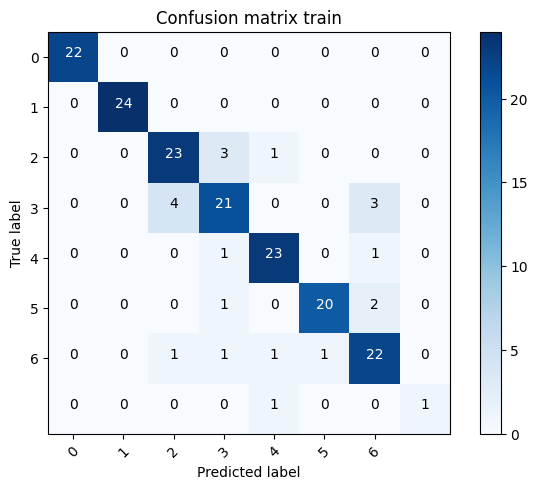

In [82]:
mc_train = confusion_matrix(y_train,predict_train)
plot_confusion_matrix(mc_train, classes=labels,
                      title='Confusion matrix train')

Confusion matrix, without normalization
[[13  0  0  0  1  0  0  0]
 [ 0 11  0  1  0  0  0  0]
 [ 0  0  3  2  2  2  0  0]
 [ 0  0  2  4  2  0  0  0]
 [ 0  0  2  1  6  1  1  0]
 [ 0  0  3  3  2  3  2  0]
 [ 0  0  1  4  1  0  3  1]
 [ 0  0  0  0  0  0  0  0]]


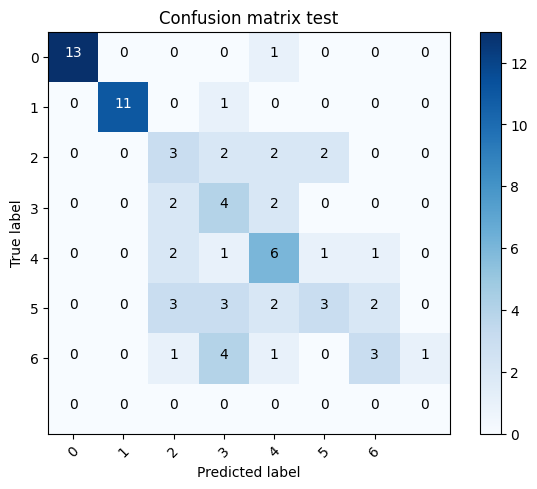

In [83]:
#Matriz de confusión sujetos de entrenamiento
mc_test = confusion_matrix(y_test,predict_test)
plot_confusion_matrix(mc_test, classes=labels,
                      title='Confusion matrix test')

**Análisis**
---

La matriz de confusión tiene la siguiente forma:

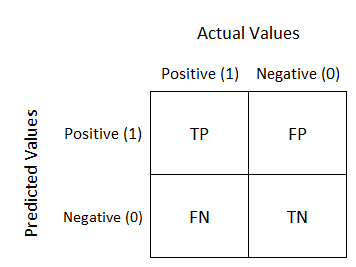



La matriz de confusión proporciona una visión detallada del rendimiento de un modelo de clasificación, permitiendo entender de una manera más visual qué tan bien el modelo predice cada clase, en este caso, las clases son los gestos de la mano.
En las matrices de confusión se puede observar que en el lado izquierdo de la matriz concuerda con los valores reales de los gestos de la mano en este caso y en la parte inferior de la matriz son los gestos predichos por el modelo, es decir que la matriz de la diagonal principal corresponden con los valores estimados de forma correcta por el modelo, tanto los verdaderos positivos, como los verdaderos negativos. Es decir, para la clase 0, posición [0][0] en la matriz, el modelo predijo correctamente 14 casos de 14 que corresponden a los datos de prueba.
Las entradas fuera de la diagonal indican errores de clasificación. Es decir, en el caso de la clase 4, el modelo dijo 2 veces fue predicha como clase 2 ocasiones.

Por otro lado, la clase 2 tiene varios errores donde es predicha como clase 3, 4, y 5 fue predicha correctamente 1 vez.

La clase 5 tiene errores al ser predicha como clase 2 más veces que como la clase 5.

La variabilidad en la matriz sugiere que el modelo puede tener dificultades para distinguir entre ciertas clases específicas. Por ejemplo, las clases 2 y 5 parecen tener predicciones distribuidas en múltiples otras clases.

Para mejorar el modelo, se podrían considerar estrategias como el ajuste de hiperparámetros, el uso de más datos de entrenamiento.


In [84]:
#Curva de aprendizaje
def plot_learning_curve(
    estimator,
    title,
    X,
    y,
    axes=None,
    ylim=None,
    cv=None,
    n_jobs=None,
    scoring=None,
    train_sizes=np.linspace(0.1, 1.0, 5),
):
    #Se estable los axes
    if axes is None:
        _, axes = plt.subplots(1, figsize=(10, 10))


    axes.set_title(title)
    #Se establece y lim
    if ylim is not None:
        axes.set_ylim(*ylim)
    axes.set_xlabel("Training examples")
    axes.set_ylabel("Score")

    #Se genera la curva de aprendizaje
    train_sizes, train_scores, test_scores, fit_times, _ = learning_curve(
        estimator,
        X,
        y,
        scoring=scoring,
        cv=cv,
        n_jobs=n_jobs,
        train_sizes=train_sizes,
        return_times=True,
    )
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)

    # Grafico de la curva de aprendizaje
    axes.grid()
    axes.fill_between(
        train_sizes,
        train_scores_mean - train_scores_std,
        train_scores_mean + train_scores_std,
        alpha=0.1,
        color="r",
    )
    axes.fill_between(
        train_sizes,
        test_scores_mean - test_scores_std,
        test_scores_mean + test_scores_std,
        alpha=0.1,
        color="g",
    )
    axes.plot(
        train_sizes, train_scores_mean, "o-", color="r", label="Training score"
    )
    axes.plot(
        train_sizes, test_scores_mean, "o-", color="g", label="Cross-validation score"
    )
    axes.legend(loc="best")

    #Se retorna el grafico de la curva de aprendizaje
    return plt

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


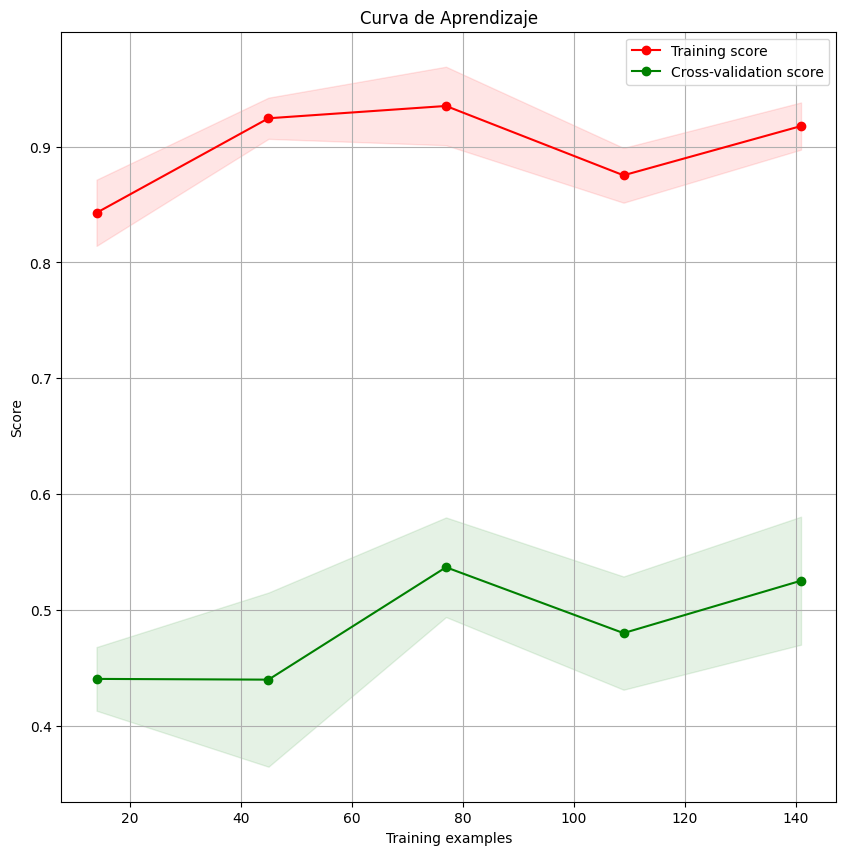

In [85]:
#Se genera la curva de aprendizaje
plot_learning_curve(estimator=mlp,
                    X=X_train,
                    y=y_train,
                    title='Curva de Aprendizaje')


plt.show()

# Análisis

La curva de aprendizaje determina las puntuaciones de entrenamiento y prueba de validación cruzada para distintos tamaños de conjuntos de entrenamiento [1].

En la curva de aprendizaje se pueden detallar dos líneas, la línea roja representa el puntaje de entrenamiento y la línea verde representa el puntaje de validación cruzada a medida que se incrementa el número de ejemplos de entrenamiento, en la gráfica se puede observar que al inicio, con pocos ejemplos de entrenamiento, el puntaje de entrenamiento es muy alto (cercano a 0.85), lo que indica que el modelo podría llegar a estar sobreajustado a los datos de entrenamiento y el puntaje de validación cruzada es muy bajo (alrededor de 0.45), lo que indica que el modelo generaliza a datos no vistos.

Por otro lado, a medida que se aumentan los ejemplos de entrenamiento, el puntaje de entrenamiento disminuye, esto es esperado porque el modelo tiene que ajustar a más datos, reduciendo el sobreajuste, el puntaje de validación cruzada muestra una ligera tendencia ascendente, lo cual es una señal positiva debido a que indica una mejora en la capacidad de generalización del modelo.

El puntaje de entrenamiento se estabiliza alrededor de 0.7, mientras que el de validación cruzada lo hace alrededor de 0.2 esto indica que el modelo está limitado en su capacidad de mejorar la precisión en datos no vistos, posiblemente debido a su complejidad o a la naturaleza de los datos.

**Segunda Arquitectura**
-----

In [48]:
mlp_2 = MLPClassifier((16,16,16), #Tamaño de la red
                      max_iter=200000, #Número de iteraciones
                      activation='tanh', # Función de activación
                      solver='adam',
                      alpha= 0.01,
                      learning_rate='adaptive', # Cambios en la tasa de aprendizaje
                      random_state=1,
                      validation_fraction=0.1,
                      n_iter_no_change=10) #Evitar sobre entrenamiento en la convergencia del optimizador

In [49]:
mlp_2.fit(X_train,y_train)

predict_train = mlp_2.predict(X_train)
print(predict_train)
predict_test = mlp_2.predict(X_test)
print(predict_test)

[3 5 6 1 1 0 6 3 1 2 2 1 3 5 3 6 3 3 1 6 6 5 2 2 2 3 0 4 6 4 2 5 6 4 3 0 4
 4 2 3 0 2 3 0 5 5 2 0 3 0 6 6 4 1 5 1 2 3 3 2 5 2 1 3 3 4 3 5 4 4 3 6 0 4
 5 4 0 0 4 6 0 2 4 6 1 2 0 3 4 2 6 5 3 4 6 4 0 6 2 2 6 1 1 0 2 1 5 2 1 6 6
 4 5 4 2 3 6 6 1 2 2 6 2 3 1 2 2 5 2 2 2 5 1 2 6 3 0 1 5 6 6 0 5 4 1 6 3 5
 0 0 3 3 6 1 2 5 0 5 3 6 4 7 6 4 4 6 1 1 5 3 1 1 1 3 0 0 0]
[2 3 4 2 1 2 4 3 3 0 5 4 4 1 0 5 0 2 2 2 0 4 6 5 3 1 5 3 1 3 3 1 6 4 0 4 3
 0 1 6 1 5 6 5 3 2 3 3 1 0 6 5 2 0 3 3 3 1 2 1 6 5 0 6 5 2 0 0 0 2 0 5 3 3
 0 1 6]


In [50]:
#%% Results, esta matriz debe de dar enormeeeeee
print(confusion_matrix(y_train,predict_train))

[[22  0  0  0  0  0  0  0]
 [ 0 24  0  0  0  0  0  0]
 [ 0  0 25  1  0  0  1  0]
 [ 0  0  1 26  0  0  1  0]
 [ 0  0  3  0 21  0  1  0]
 [ 0  0  0  0  0 21  2  0]
 [ 0  0  1  0  1  0 24  0]
 [ 0  0  0  1  0  0  0  1]]


In [51]:
#importar las funciones necesarias
from sklearn.metrics import classification_report

#especificar las etiquetas de las clases directamente
labels = ['0','1', '2', '3', '4','5','6','7']
#imprimir el reporte de clasificación
print(classification_report(y_train, predict_train, labels=labels, zero_division=0))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        22
           1       1.00      1.00      1.00        24
           2       0.83      0.93      0.88        27
           3       0.93      0.93      0.93        28
           4       0.95      0.84      0.89        25
           5       1.00      0.91      0.95        23
           6       0.83      0.92      0.87        26
           7       1.00      0.50      0.67         2

   micro avg       0.93      0.93      0.93       177
   macro avg       0.94      0.88      0.90       177
weighted avg       0.93      0.93      0.93       177



In [52]:
print(confusion_matrix(y_test,predict_test))

[[14  0  0  0  0  0  0]
 [ 0 11  0  1  0  0  0]
 [ 0  0  2  2  2  2  1]
 [ 0  0  2  5  0  1  0]
 [ 0  0  3  1  4  3  0]
 [ 0  0  2  4  1  1  5]
 [ 0  0  2  3  0  3  2]]


In [53]:
print(classification_report(y_test,predict_test,labels=labels, zero_division=0))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       1.00      0.92      0.96        12
           2       0.18      0.22      0.20         9
           3       0.31      0.62      0.42         8
           4       0.57      0.36      0.44        11
           5       0.10      0.08      0.09        13
           6       0.25      0.20      0.22        10
           7       0.00      0.00      0.00         0

   micro avg       0.51      0.51      0.51        77
   macro avg       0.43      0.43      0.42        77
weighted avg       0.52      0.51      0.50        77



Confusion matrix, without normalization
[[22  0  0  0  0  0  0  0]
 [ 0 24  0  0  0  0  0  0]
 [ 0  0 25  1  0  0  1  0]
 [ 0  0  1 26  0  0  1  0]
 [ 0  0  3  0 21  0  1  0]
 [ 0  0  0  0  0 21  2  0]
 [ 0  0  1  0  1  0 24  0]
 [ 0  0  0  1  0  0  0  1]]


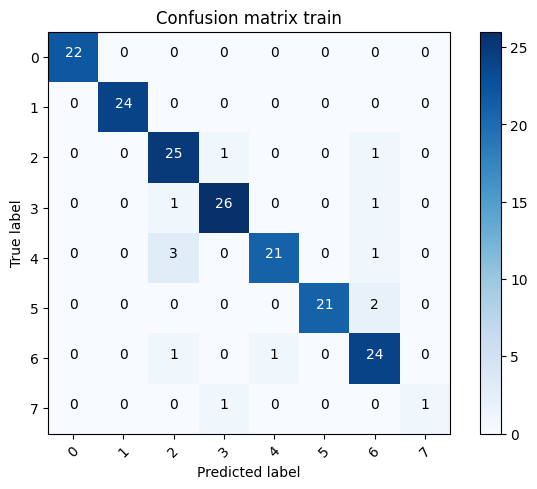

In [54]:
mc_train = confusion_matrix(y_train,predict_train)
plot_confusion_matrix(mc_train, classes=labels,
                      title='Confusion matrix train')

Confusion matrix, without normalization
[[14  0  0  0  0  0  0]
 [ 0 11  0  1  0  0  0]
 [ 0  0  2  2  2  2  1]
 [ 0  0  2  5  0  1  0]
 [ 0  0  3  1  4  3  0]
 [ 0  0  2  4  1  1  5]
 [ 0  0  2  3  0  3  2]]


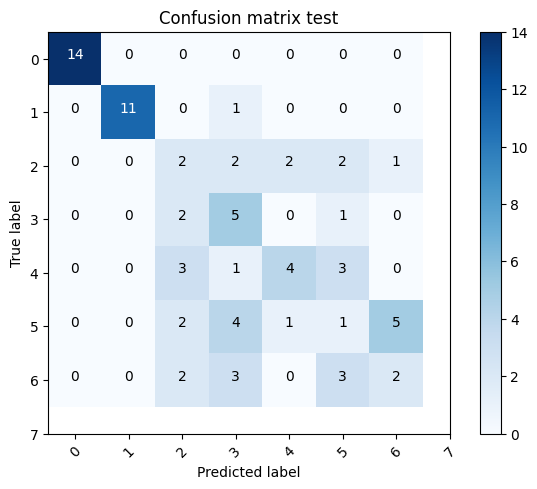

In [55]:
mc_test = confusion_matrix(y_test,predict_test)
plot_confusion_matrix(mc_test, classes=labels,
                      title='Confusion matrix test')

*La matriz de confusión proporciona información sobre el rendimiento del modelo y puede ayudar a identificar áreas de mejora, como clases con altos índices de clasificación errónea o pares específicos de clases que se confunden con frecuencia, la normalización de la matriz de confusión (dividiendo cada valor por el total de instancias de la clase verdadera correspondiente) puede proporcionar una mejor comprensión del rendimiento relativo de cada clase, especialmente cuando se trata de conjuntos de datos desequilibrados.*

En la matriz de confusión correspondiente a la segunda arquitectura de la red neuronal se puede observar que teniendo en cuenta que en la matriz de train todos los datos fueron predichos de manera correcta y esto no fue el caso de la matriz de confusión de test se puede llegar a concluir que el modelo sufrió un sobreajuste, en donde el modelo puede que esté generalizando los datos nuevos que se le está ingresando porque no son como los datos de entrenamiento.

En la matriz de confusión de test se puede observar que los gestos que fueron mejor predichos por el modelo fueron los gestos 0 y 1, y gestos con los que el modelo tuvo más dificultades fueron los gestos 2 y 5, en donde para el caso del gesto 2, el modelo predijo la misma cantidad de casos para el gesto predicho de 2 y de 5. De igual manera, para el gesto real de 5, el modelo predijo en 6 casos que correspondía al gesto 2.

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


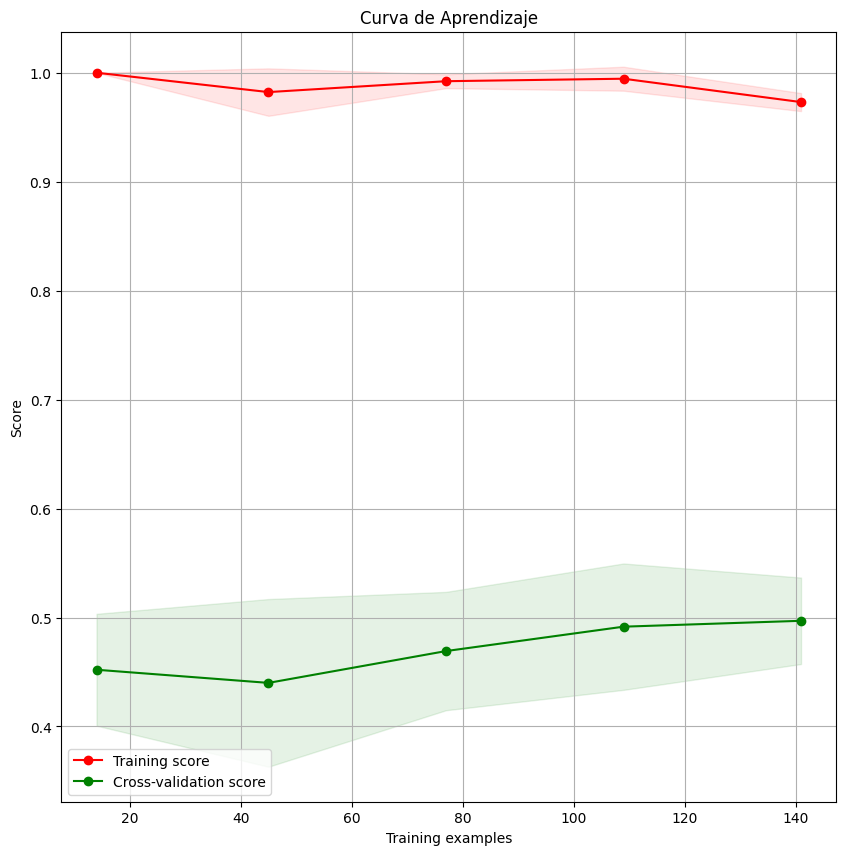

In [56]:
#Se genera la curva de aprendizaje
plot_learning_curve(estimator=mlp_2,
                    X=X_train,
                    y=y_train,
                    title='Curva de Aprendizaje')
plt.show()

# Análisis

En la curva de aprendizaje se pueden detallar dos líneas, la línea roja representa la curva de puntaje de entrenamiento, la cual comienza con un valor muy alto y disminuye lentamente a medida que avanzan las épocas de entrenamiento, cosa que es común, debido a que el modelo aprende a ajustarse a los datos de entrenamiento con mayor precisión. La línea verde representa el puntaje de validación cruzada a medida que se incrementa el número de ejemplos de entrenamiento, dicha curva comienza en un valor bajo, aumenta inicialmente a medida que el modelo aprende patrones generales de los datos, alcanza un máximo aproximadamente en la época 60, y luego disminuye lentamente. Este es un comportamiento esperado, ya que al principio el modelo es bastante general y luego se vuelve demasiado específico para los datos de entrenamiento, lo que corresponde a un overfitting.

En general, la diferencia entre las curvas de entrenamiento y validación indica un cierto grado de sobreajuste, donde el modelo se ajusta demasiado a los datos de entrenamiento, en comparación con los datos de test no vistos. Sin embargo, esta brecha no parece excesivamente grande, lo que sugiere que el sobreajuste no es un problema grave.

**Tercera Arquitectura**
--------------

In [57]:
#Four hidden layer each layer with ELEGIR LAS NEURONASSSSS
mlp = MLPClassifier((20,20,20), #Tamaño de la red
                      max_iter=500000, #Número de iteraciones
                      activation='tanh', # Función de activación
                      solver='lbfgs', # optimizador de función de perdida
                      alpha=0.5,
                      learning_rate='adaptive', # Cambios en la tasa de aprendizaje
                      random_state=1,
                      early_stopping=True) #Evitar sobre entrenamiento en la convergencia del optimizador
print(mlp)

MLPClassifier(activation='tanh', alpha=0.5, early_stopping=True,
              hidden_layer_sizes=(20, 20, 20), learning_rate='adaptive',
              max_iter=500000, random_state=1, solver='lbfgs')


In [58]:
mlp.fit(X_train,y_train)

predict_train2 = mlp.predict(X_train)
print(predict_train2)
predict_test2 = mlp.predict(X_test)
print(predict_test2)

[6 5 6 1 1 0 5 3 1 5 2 1 3 5 3 6 4 3 1 5 6 5 2 2 2 6 0 4 6 4 4 5 6 4 3 0 4
 4 2 2 0 3 3 0 5 5 2 0 3 0 5 6 5 1 5 1 2 3 3 2 4 2 1 6 3 5 3 5 2 4 2 6 0 4
 5 4 0 0 4 6 0 2 4 6 1 5 0 5 4 5 5 3 2 4 6 4 0 6 2 2 3 1 1 0 2 1 5 2 1 6 6
 4 6 4 4 3 6 6 1 2 2 5 4 3 1 2 2 5 2 4 6 5 1 3 3 3 0 1 5 6 6 0 5 4 1 4 3 3
 0 0 3 3 6 1 2 5 0 5 4 6 4 6 6 2 4 6 1 1 5 3 1 1 1 3 0 0 0]
[2 3 4 2 1 4 2 6 3 0 5 2 4 1 0 5 0 4 3 4 0 4 6 5 3 1 3 3 1 2 3 1 2 4 0 4 1
 0 1 6 1 2 6 5 3 2 2 3 1 0 6 3 5 0 4 3 4 1 2 1 5 5 0 6 5 2 0 0 0 4 0 6 3 3
 0 1 6]


In [59]:
#%% Results, esta matriz debe de dar enormeeeeee
print(confusion_matrix(y_train,predict_train))

[[22  0  0  0  0  0  0  0]
 [ 0 24  0  0  0  0  0  0]
 [ 0  0 25  1  0  0  1  0]
 [ 0  0  1 26  0  0  1  0]
 [ 0  0  3  0 21  0  1  0]
 [ 0  0  0  0  0 21  2  0]
 [ 0  0  1  0  1  0 24  0]
 [ 0  0  0  1  0  0  0  1]]


In [60]:
# Importar las funciones necesarias
from sklearn.metrics import classification_report

# Especificar las etiquetas de las clases directamente
labels = ['0','1', '2', '3', '4','5','6']

# Imprimir el reporte de clasificación
print(classification_report(y_train, predict_train2, labels=labels, zero_division=0))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        22
           1       1.00      1.00      1.00        24
           2       0.68      0.63      0.65        27
           3       0.72      0.64      0.68        28
           4       0.73      0.76      0.75        25
           5       0.61      0.74      0.67        23
           6       0.63      0.65      0.64        26

   micro avg       0.76      0.77      0.76       175
   macro avg       0.77      0.78      0.77       175
weighted avg       0.76      0.77      0.76       175



In [61]:
print(confusion_matrix(y_test,predict_test))
print(' ')

print(classification_report(y_test,predict_test2,labels=labels, zero_division=0))

[[14  0  0  0  0  0  0]
 [ 0 11  0  1  0  0  0]
 [ 0  0  2  2  2  2  1]
 [ 0  0  2  5  0  1  0]
 [ 0  0  3  1  4  3  0]
 [ 0  0  2  4  1  1  5]
 [ 0  0  2  3  0  3  2]]
 
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       1.00      1.00      1.00        12
           2       0.45      0.56      0.50         9
           3       0.46      0.75      0.57         8
           4       0.55      0.55      0.55        11
           5       0.25      0.15      0.19        13
           6       0.25      0.20      0.22        10

   micro avg       0.61      0.61      0.61        77
   macro avg       0.57      0.60      0.58        77
weighted avg       0.59      0.61      0.59        77



Confusion matrix, without normalization
[[22  0  0  0  0  0  0  0]
 [ 0 24  0  0  0  0  0  0]
 [ 0  0 25  1  0  0  1  0]
 [ 0  0  1 26  0  0  1  0]
 [ 0  0  3  0 21  0  1  0]
 [ 0  0  0  0  0 21  2  0]
 [ 0  0  1  0  1  0 24  0]
 [ 0  0  0  1  0  0  0  1]]
Confusion matrix, without normalization
[[14  0  0  0  0  0  0]
 [ 0 11  0  1  0  0  0]
 [ 0  0  2  2  2  2  1]
 [ 0  0  2  5  0  1  0]
 [ 0  0  3  1  4  3  0]
 [ 0  0  2  4  1  1  5]
 [ 0  0  2  3  0  3  2]]


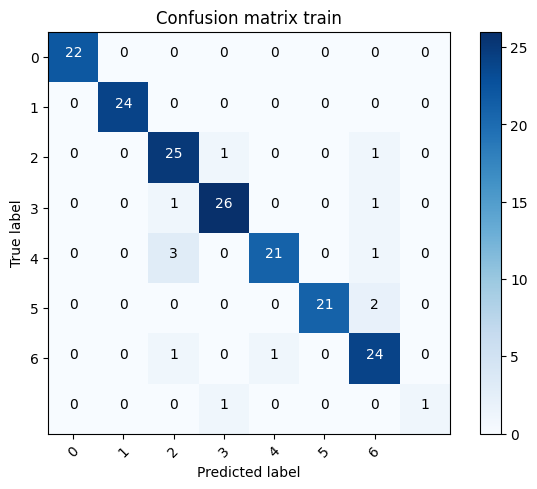

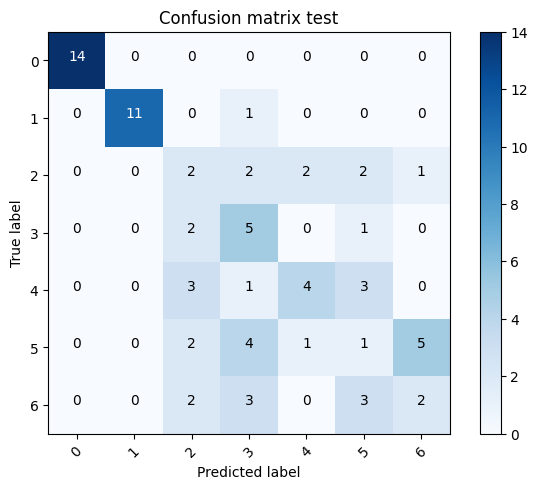

In [62]:
mc_train = confusion_matrix(y_train,predict_train)
plot_confusion_matrix(mc_train, classes=labels,
                      title='Confusion matrix train')

mc_test = confusion_matrix(y_test,predict_test)
plot_confusion_matrix(mc_test, classes=labels,
                      title='Confusion matrix test')

**Análisis**
----

Las matrices de confusión son un instrumento tecnológico que sirve para calcular el rendimiento sobre un modelo de clasificación definido [2]

Matriz de confusion training:

Esta matriz muestra que el modelo ha clasificado correctamente la mayoría de los ejemplos en las todas las clases.  

Matriz de confusion predicha:

En esta matriz, se puede observar que el modelo tiene un sesgo significativo hacia ciertas clases, particularmente la clase 3. Esto se evidencia por las altas predicciones en esa clase, incluso cuando los ejemplos pertenecen a otras clases.

En general, estas matrices de confusión sugieren que el modelo tiene un rendimiento deficiente y necesita mejoras significativas. Las posibles soluciones que se sugieren, no sólo para la arquitectura actual, sino para las anteriores es que se deben de recolectar más datos de entrenamiento, especialmente para las clases problemáticas y ajustar la arquitectura del modelo o los hiperparámetros para mejorar la capacidad de aprendizaje.

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


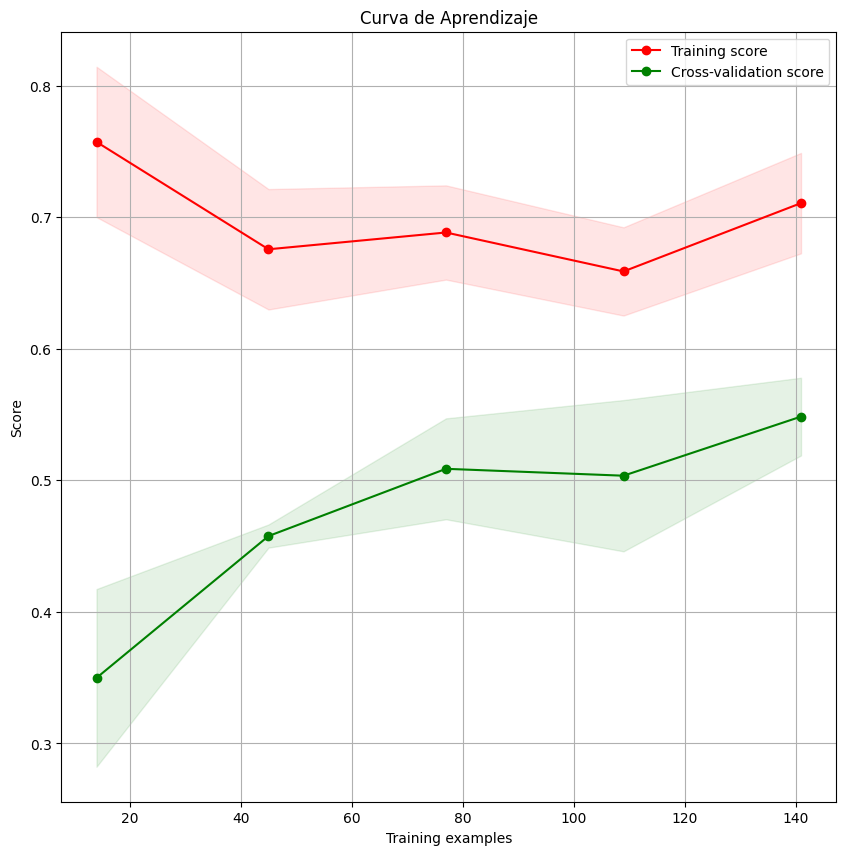

In [63]:
#Se genera la curva de aprendizaje
plot_learning_curve(estimator=mlp,
                    X=X_train,
                    y=y_train,
                    title='Curva de Aprendizaje')
plt.show()


**Análisis**
-----

En la curva de aprendizaje se pueden detallar dos líneas, la línea roja representa el puntaje de entrenamiento y la línea verde representa el puntaje de validación cruzada a medida que se incrementa el número de ejemplos de entrenamiento del modelo.

En las primeras épocas, tanto la puntuación de entrenamiento como la de validación son bastante bajas, lo que indica que el modelo aún no ha aprendido patrones significativos de los datos.

A medida que avanza el entrenamiento, ambas curvas comienzan a aumentar, lo cual es un comportamiento esperado. La puntuación de entrenamiento continúa aumentando casi hasta el valor máximo, al igual que la puntuación de validación.

Este comportamiento sugiere que el modelo se está ajustando demasiado a los detalles específicos del conjunto de datos de entrenamiento, pero no está generalizando bien a nuevos datos no vistos.

Alrededor de la época 120, la puntuación de validación parece estabilizarse, lo que podría indicar que el sobreajuste ha alcanzado un punto máximo y que continuar el entrenamiento no mejorará significativamente el rendimiento en datos no vistos.

# **f. Implementar otros modelos de machine learning que permitan la clasificación de gestos**

# Random Forest

In [64]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Ensure y_train and y_test are 1D arrays
y_train = np.ravel(y_train)
y_test = np.ravel(y_test)

model = RandomForestClassifier(random_state=42)
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}
g = GridSearchCV(model, param_grid, cv=5, scoring='balanced_accuracy')

# Create a pipeline
steps = [
    ('scaler', StandardScaler()),
    ('clf', g),
]
pip = Pipeline(steps)

# Fit the pipeline to the training data
pip.fit(X_train, y_train)

# Predict on the test data
y_pred = pip.predict(X_test)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


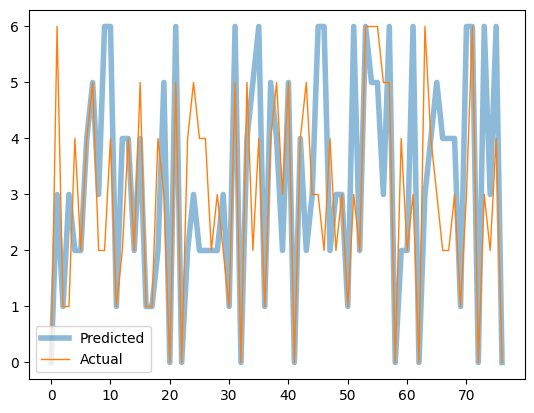

In [65]:
plt.plot(y_pred, alpha=0.5, linewidth=4, label='Predicted')
plt.plot(y_test, linewidth=1, label='Actual')
plt.legend()
plt.show()

# Análisis
En la gráfica de las curvas de predicción vs la curva actual, el eje horizontal muestra el índice o el paso de tiempo, mientras que el eje vertical representa los valores predichos y reales.

La curva azul representa los valores predichos por el modelo, mientras que las curva naranjas representan los valores reales.

En la gráfica se puede observar que el modelo tiene dificultades para seguir con precisión los valores reales, en donde se tiene que en algunas regiones, las predicciones se acercan a los valores reales, pero en otras, hay desviaciones significativas, en donde se puede apreciar que el modelo parece tener problemas para capturar picos pronunciados o cambios abruptos en los valores reales. Se observa que a menudo subestima o sobreestima estos picos.

Hay varias instancias donde el modelo falla por completo en capturar los valores reales, como alrededor de los índices 35-40 y 60-65. Por otro lado, existen algunas regiones, como cerca del índice 70, el modelo parece anticipar o retrasar los cambios en los valores reales.

En conclusión, el modelo puede capturar algunas tendencias generales pero tiene dificultades significativas para hacer predicciones precisas, especialmente cuando hay cambios abruptos o comportamientos irregulares en los datos reales.

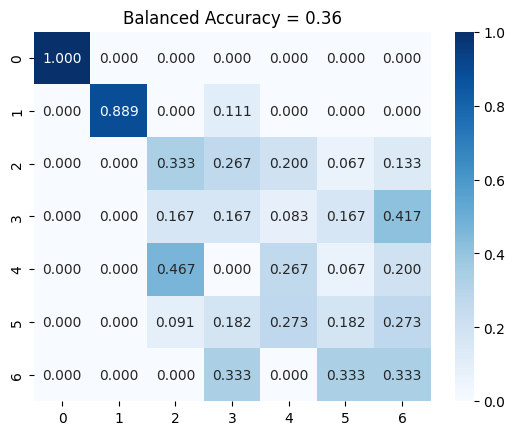

In [66]:
from sklearn.metrics import confusion_matrix, balanced_accuracy_score
import seaborn as sns

conf = confusion_matrix(y_test, y_pred, normalize='true')
acc = balanced_accuracy_score(y_test, y_pred, adjusted=True)

# Plot confusion matrix
sns.heatmap(conf, annot=True, fmt='0.3f', cmap='Blues')
plt.title(f'Balanced Accuracy = {acc:0.2f}')
plt.show()

# Análisis


La matriz muestra 7 clases en total (de 0 a 6) en las filas y columnas, en donde los valores en la diagonal principal representan las predicciones correctas y los valores fuera de la diagonal son clasificaciones incorrectas del modelo.

La métrica "Balanced Accuracy = 0.36" indica un rendimiento general bastante pobre del modelo, con una precisión balanceada del 38%.

Para la clase 0, la clase 1 y Clase 6, el modelo parece tener un buen desempeño en la clasificación de esta clase, con una precisión del 100% para la primera y última clase y del 88,9% para la clase 1.

Para la clases 2, 3 y 4 se puede observar que las precisiones son bajas, del 33,3%, 26,7% y 20%, respectivamente. Además, hay confusiones significativas entre estas clases.

Para la clase 5, la precisión para esta clase es del 9,1%, lo que sugiere que el modelo tiene dificultades para distinguirla correctamente.

Teniendo en cuenta lo anterior, la matriz de confusión implica que el modelo tiene un rendimiento deficiente, particularmente en la clasificación de ciertas clases (2, 3, 4 y 5). Las confusiones entre estas clases son bastante altas, lo que indica que el modelo tiene dificultades para diferenciar adecuadamente sus características.

# TENSOR FLOW

In [67]:
import tensorflow as tf
print("class :", dataset["Gesto"].unique())
print()
#print("Labels :",df["label"].unique()) # 36 people hand gesture data
#print()
print("Value Count :\n",dataset["Gesto"].value_counts())

class : [0 1 2 3 4 5 6 7]

Value Count :
 Gesto
0    36
1    36
2    36
3    36
4    36
5    36
6    36
7     2
Name: count, dtype: int64


In [68]:
features = dataset.drop(columns=["Sujeto","RMS_Original","Varianza_Original","MAV_Original","MAVS_Original","SSC_Original","WL_Original","ZC_Original"])
display(features.head())

,Gesto,RMS_Filtrado,Varianza_Filtrado,MAV_Filtrado,MAVS_Filtrado,SSC_Filtrado,WL_Filtrado,ZC_Filtrado
0,0,0.374504,0.145171,0.191611,0.184402,0.755266,0.510645,0.771455
1,1,0.012260,0.000154,0.010759,0.010835,0.071222,0.002831,0.076416
2,2,0.441747,0.185133,0.453937,0.468806,0.066251,0.113827,0.066454
3,3,0.511126,0.263512,0.342696,0.307038,0.068495,0.079822,0.071245
4,4,0.349670,0.122543,0.282241,0.187699,0.065893,0.046991,0.070274


In [69]:
Class = dataset["Gesto"]
print(Class.unique())

[0 1 2 3 4 5 6 7]


In [70]:
print(type(Class))
print(type(features))

Class = Class.values
features = features.values

print(type(Class))
print(type(features))

<class 'pandas.core.series.Series'>
<class 'pandas.core.frame.DataFrame'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [71]:
# split in training 70%, validation 10 %,  test 20% test
from sklearn.model_selection import train_test_split
# 80 and 20
x_train, x_test, y_train, y_test = train_test_split(features, Class, test_size=0.2, random_state=1)

In [72]:
y_train = tf.keras.utils.to_categorical(y_train)
y_test = tf.keras.utils.to_categorical(y_test)

Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 17.2663 - accuracy: 0.1235 - val_loss: 16.9318 - val_accuracy: 0.0976
Epoch 2/100
1/1 [==============================] - 0s 77ms/step - loss: 16.9311 - accuracy: 0.1481 - val_loss: 16.6163 - val_accuracy: 0.0976
Epoch 3/100
1/1 [==============================] - 0s 60ms/step - loss: 16.6125 - accuracy: 0.1481 - val_loss: 16.2904 - val_accuracy: 0.0976
Epoch 4/100
1/1 [==============================] - 0s 62ms/step - loss: 16.2864 - accuracy: 0.1481 - val_loss: 15.9639 - val_accuracy: 0.0976
Epoch 5/100
1/1 [==============================] - 0s 62ms/step - loss: 15.9565 - accuracy: 0.1481 - val_loss: 15.6267 - val_accuracy: 0.0976
Epoch 6/100
1/1 [==============================] - 0s 74ms/step - loss: 15.6174 - accuracy: 0.1481 - val_loss: 15.2886 - val_accuracy: 0.0976
Epoch 7/100
1/1 [==============================] - 0s 60ms/step - loss: 15.2758 - accuracy: 0.1481 - val_loss: 14.9446 - val_accuracy: 0.0976
Epoch 8/

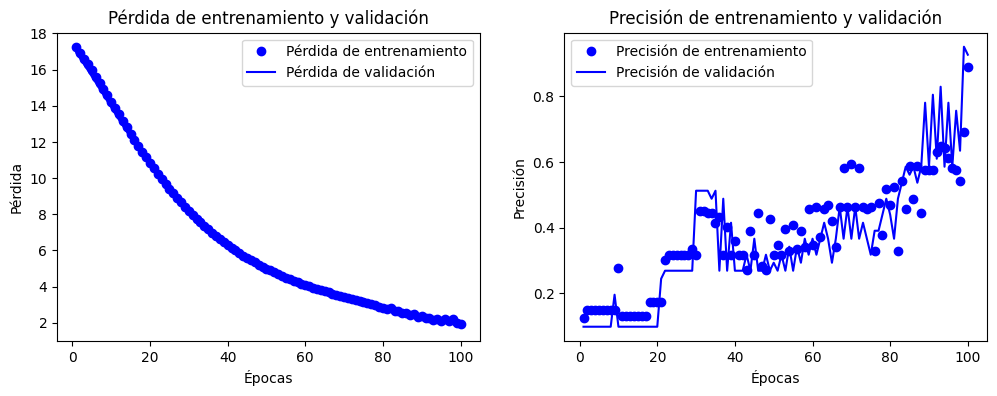

2/2 [==============================] - 0s 12ms/step - loss: 1.8056 - accuracy: 0.7843
Precisión en el conjunto de prueba: 78.43%
2/2 [==============================] - 0s 11ms/step
Reporte de clasificación para el conjunto de prueba
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         6
           1       1.00      1.00      1.00         4
           2       1.00      1.00      1.00         8
           3       0.89      1.00      0.94         8
           4       1.00      0.90      0.95        10
           5       0.29      1.00      0.44         4
           6       1.00      0.09      0.17        11

    accuracy                           0.78        51
   macro avg       0.88      0.86      0.79        51
weighted avg       0.93      0.78      0.76        51



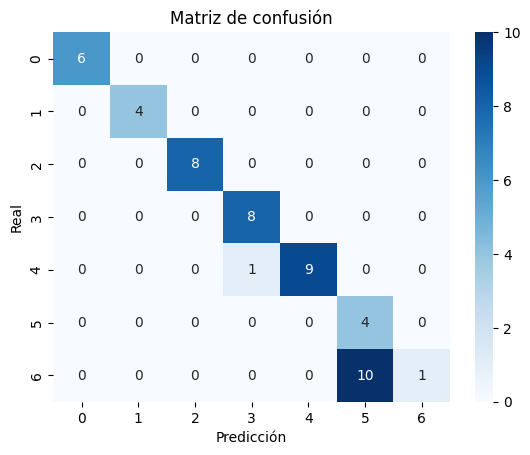

In [73]:
# Dividir los datos en conjuntos de entrenamiento y prueba
x_train, x_test, y_train, y_test = train_test_split(features, Class, test_size=0.2, random_state=1)
y_train = tf.keras.utils.to_categorical(y_train, num_classes=8)
y_test = tf.keras.utils.to_categorical(y_test, num_classes=8)

# Función para graficar pérdidas y precisión
def plot(history):
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(loss) + 1)

    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, loss, 'bo', label='Pérdida de entrenamiento')
    plt.plot(epochs, val_loss, 'b', label='Pérdida de validación')
    plt.title('Pérdida de entrenamiento y validación')
    plt.xlabel('Épocas')
    plt.ylabel('Pérdida')
    plt.legend()

    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    plt.subplot(1, 2, 2)
    plt.plot(epochs, acc, 'bo', label='Precisión de entrenamiento')
    plt.plot(epochs, val_acc, 'b', label='Precisión de validación')
    plt.title('Precisión de entrenamiento y validación')
    plt.xlabel('Épocas')
    plt.ylabel('Precisión')
    plt.legend()

    plt.show()

# Definir la arquitectura del modelo
input_tensor = Input(shape=(8,))
x = layers.Dense(1024, activation='relu',kernel_regularizer=tf.keras.regularizers.l2(0.01))(input_tensor)
y = layers.Dense(512, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(x)
z = layers.Dense(256, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(y)
z = layers.Dense(128, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(z)
z = layers.Dense(64, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(z)
z = layers.Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(z)
z = layers.Dense(128, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(z)
z = layers.Dense(64, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(z)
z = layers.Dense(32, activation='relu', kernel_regularizer=tf.keras.regularizers.l2(0.01))(z)
output_tensor = layers.Dense(8, activation='softmax')(z)

model = Model(input_tensor, output_tensor)

# Compilar el modelo
opt = optimizers.Nadam(learning_rate=1e-3)
model.compile(optimizer=opt,
              loss="categorical_crossentropy",
              metrics=["accuracy"])

# Entrenar el modelo
batch_size = 512
epochs = 100

history = model.fit(x_train, y_train,
                    batch_size=batch_size,
                    epochs=epochs,
                    validation_split=0.2)

# Graficar resultados
plot(history)

# Evaluar el modelo en el conjunto de prueba
test_loss, test_accuracy = model.evaluate(x_test, y_test)
print(f"Precisión en el conjunto de prueba: {test_accuracy * 100:.2f}%")

# Predicciones y reporte de clasificación
y_pred = model.predict(x_test)
y_pred_classes = np.argmax(y_pred, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

print("Reporte de clasificación para el conjunto de prueba")
print(classification_report(y_test_classes, y_pred_classes, zero_division=0))

# Matriz de confusión
conf_matrix = confusion_matrix(y_test_classes, y_pred_classes)
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
plt.title('Matriz de confusión')
plt.xlabel('Predicción')
plt.ylabel('Real')
plt.show()


In [74]:
evaluation = model.evaluate(x_test,  y_test,batch_size=batch_size, verbose=2)
print()
print("Test accuracy :", np.round(evaluation[1]*100, 4),"%")

1/1 - 0s - loss: 1.8056 - accuracy: 0.7843 - 23ms/epoch - 23ms/step

Test accuracy : 78.4314 %


**Bibliografia**
---
[1] https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.learning_curve.html